In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader

import torchvision.transforms as transforms
import torchvision.utils
from torchvision.utils import make_grid

import torchvision.datasets

import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (10,6)

from tqdm import tqdm

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

# Introduction to Generative Adversarial Networks (GANs)

In this notebook you will build a GAN from scratch, grossly following the DCGAN architecture.

**Goals:**


1.   Build a GAN arhictecture from scratch
2.   Write the GAN loss function and train GAN from scratch
3.   Have experience with some of the instability problems inherent with training GANs.
4.   [Bonus] Extend the unconditional GAN into a conditional GAN.



## 1. Getting Started

We will work with the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset. It contains 60,000 images size 28x28 of handwritten digits, from 0 to 9.

## 1. Dataloading

### 1.1 Define some hyperparameters and transforms


In [9]:
batch_size = 128 # Images per batch

# Resize to 32x32 for easier upsampling/downsampling
mytransform = transforms.Compose([transforms.Resize(32),
                                  transforms.ToTensor(),
                                #  transforms.Normalize((.5), (.5))   # NOTE: not applied with CIFAR
                                 ]) # normalize between [-1, 1] with tanh activation

# mnist_train = torchvision.datasets.MNIST(root='.', download=True, transform=mytransform)
cifar_train = torchvision.datasets.CIFAR10(root='.', download=True, transform=mytransform)

In [10]:
# dataloader = DataLoader(dataset=mnist_train,
#                          batch_size=batch_size,
#                          shuffle=True)
dataloader = DataLoader(dataset=cifar_train,
                         batch_size=batch_size,
                         shuffle=True)

In [11]:
# plot some images
real_batch, real_labels = next(iter(dataloader))

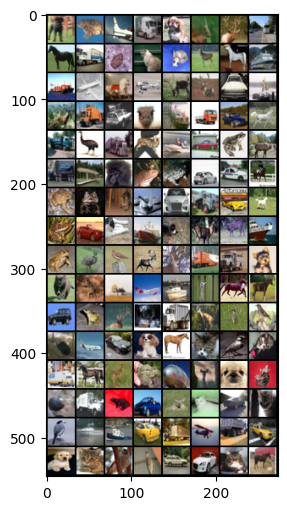

In [12]:
plt.imshow(transforms.ToPILImage()(make_grid(real_batch)))

## 2. Model Architecture

We will follow the general architecture of a DCGAN - or deep convolutional GAN. This [influential paper](https://arxiv.org/pdf/1511.06434v2.pdf) produced much of the foundation for modern GANs and how to train them.

(GANs are notoriously **hard** to train, we will try to get a feeling why in this notebook.)


Complete the function `get_upscaling_block`. Then, use the function to define our model defined as follows:

Input: Random "noise" $z$ shaped `[n_batch, n_z]`

Output: Generated image size `[n_batch, 1, 32, 32]` in range [-1, 1]

1. Reshape z into `[n_batch, n_z, 1, 1]` to make it into an "image"
2. First upscaling block $\rightarrow$ `[n_batch, ngf*4, 4, 4]`
3. Second upscaling block $\rightarrow$ `[n_batch, ngf*2, 8, 8]`
4. Third upscaling block $\rightarrow$ `[n_batch, ngf, 16, 16]`
5. Fourth (and last) upscaling block $\rightarrow$ `[n_batch, 1, 32, 32]`

## 2.1. The Generator



The generator performs subsequent upsampling blocks, transforming a latent vector shaped [batch_size, latent_size] into an image (values in [-1, 1]).

The generator block will consists of:
- Transpose Convolution
- Batch Norm
- ReLU

In [14]:
def get_upscaling_block(channels_in, channels_out, kernel, stride, padding, last_layer=False):
    '''
    Each transpose conv will be followed by BatchNorm and ReLU,
    except the last block (which is only followed by tanh)
    '''
    if last_layer:
        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################
        block = nn.Sequential(
            nn.ConvTranspose2d(in_channels=channels_in, out_channels=channels_out, kernel_size=kernel, stride=stride, padding=padding, bias=False),
            nn.Tanh()
        )
    else:
        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################
        block = nn.Sequential(
            nn.ConvTranspose2d(in_channels=channels_in, out_channels=channels_out, kernel_size=kernel, stride=stride, padding=padding, bias=False),
            nn.BatchNorm2d(num_features=channels_out),
            nn.ReLU()
        )

    return block



class Generator(nn.Module):
    def __init__(self, nz, ngf, nchannels=1):
        '''
        nz: The latent size (100 in our case)
        ngf: The channel-size before the last layer (32 our case)
        '''
        super().__init__()

        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #

        self.model = nn.Sequential(
            get_upscaling_block(channels_in=nz, channels_out=ngf*4, kernel=4, stride=1, padding=0),
            get_upscaling_block(channels_in=ngf*4, channels_out=ngf*2, kernel=4, stride=2, padding=1),
            get_upscaling_block(channels_in=ngf*2, channels_out=ngf, kernel=4, stride=2, padding=1),
            get_upscaling_block(channels_in=ngf, channels_out=nchannels, kernel=4, stride=2, padding=1, last_layer=True),

        )

        ###################

    def forward(self, z):
        x = z.unsqueeze(2).unsqueeze(2) # give spatial dimensions to z
        # print(x.shape)
        return self.model(x)


### 2.1.3. Sanity Tests

In [15]:
nz = 1000
z = torch.randn(batch_size, nz)
z.shape

torch.Size([128, 1000])

In [16]:
G = Generator(nz=nz, ngf=16)
print(G(z).shape)
assert G(z).shape == (batch_size, 1, 32, 32)

G = Generator(nz=nz, ngf=16)
assert G(z).shape == (batch_size, 1, 32, 32)

torch.Size([128, 1, 32, 32])


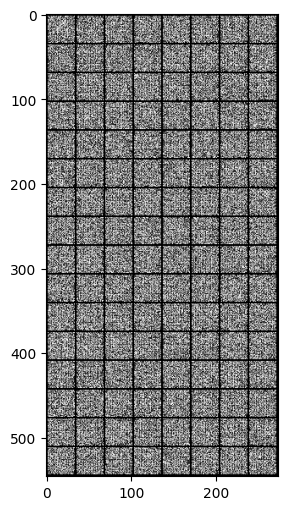

In [ ]:
# visualize the output - at first it should just look like random noise!!
x_fake = G(z)
plt.imshow(transforms.ToPILImage()(make_grid(x_fake, nrow=8)))

## 2.2. The discriminator

The discriminator will be a mirror image of the generator.

The discriminator will also use a fully convolutional architecutre, with each block consisting of:
- Conv layer
- BatchNorm
- ReLU

Complete the function `get_downscaling_block` and then use it to define the following architecture for the discriminator:

Input: Image shaped `[n_batch, 1, 32, 32]` (in [-1, 1])
Output: Discriminator scores `[n_batch, 1]` in range [0, 1]

1. First downscaling block $\rightarrow$ `[n_batch, ndf, 16, 16]`
2. Second downscaling block $\rightarrow$ `[n_batch, ndf*2, 8, 8]`
3. Third downscaling block $\rightarrow$ `[n_batch, ndf*4, 4, 4]`
4. Last downscaling block $\rightarrow$ `[n_batch, 1]`

In [23]:
def get_downscaling_block(channels_in, channels_out, kernel, stride, padding, use_batch_norm=True, is_last=False):

    if is_last:
        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################
        block = nn.Sequential(
            nn.Conv2d(in_channels=channels_in, out_channels=channels_out, kernel_size=kernel, stride=stride, padding=padding, bias=False),
            nn.Sigmoid()
        )

    elif not use_batch_norm:
        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################
        block = nn.Sequential(
            nn.Conv2d(in_channels=channels_in, out_channels=channels_out, kernel_size=kernel, stride=stride, padding=padding, bias=False),
            nn.LeakyReLU(0.2)
        )
    else:
        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################
        block = nn.Sequential(
            nn.Conv2d(in_channels=channels_in, out_channels=channels_out, kernel_size=kernel, stride=stride, padding=padding, bias=False),
            nn.BatchNorm2d(num_features=channels_out),
            nn.LeakyReLU(0.2)
        )

    return block


class Discriminator(nn.Module):
    def __init__(self, ndf, nchannels=1, in_channels=1):
        super().__init__()

        ###################
        #                 #
        # YOUR CODE HERE  #

        self.model = nn.Sequential(
            get_downscaling_block(channels_in=in_channels, channels_out=ndf, kernel=4, stride=2, padding=1, use_batch_norm=True),
            get_downscaling_block(channels_in=ndf, channels_out=ndf*2, kernel=4, stride=2, padding=1, use_batch_norm=True),
            get_downscaling_block(channels_in=ndf*2, channels_out=ndf*3, kernel=4, stride=2, padding=1, use_batch_norm=True),
            get_downscaling_block(channels_in=ndf*3, channels_out=nchannels, kernel=4, stride=1, padding=0, is_last=True),
        )

        #                 #
        ###################

    def forward(self, x):
        return self.model(x).squeeze(1).squeeze(1) # remove spatial dimensions

### 2.2.3 Sanity Checking

In [18]:
real_batch, real_labels = next(iter(dataloader))

In [26]:
# D = Discriminator(ndf=32, nchannels=1)
D = Discriminator(ndf=32, nchannels=1, in_channels=3)  # NOTE: with CIFAR
print(real_batch.shape)
print(D(real_batch).shape)
assert D(real_batch).shape == (real_batch.shape[0], 1)

torch.Size([128, 3, 32, 32])
torch.Size([128, 1])


# 3. Training

## 3.1 Loss
The essential thing to remember is that the logistic and the non-saturating logistic GAN losses can be written exclusively using the [binary cross entropy loss](https://pytorch.org/docs/stable/generated/torch.nn.BCELoss.html). Our GAN loss will be defined ONLY using the following criterion:



In [27]:
criterion = nn.BCELoss() # we will build off of this to make our final GAN loss!

## 3.2 Helper functions

We will need a few helper functions.
1. First, we need to continuously sample z from a Gaussian distribution.
2. Secondly, we need to make our "ground-truth" labels when using the BCE loss. This should output vectors of either 0s or 1s.

In [29]:
def sample_z(batch_size, nz):
    return torch.randn(batch_size, nz, device=device)

# this is for the real ground-truth label
def get_labels_one(batch_size):
    r = torch.ones(batch_size, 1)
    return r.to(device)

# this is for the generated ground-truth label
def get_labels_zero(batch_size):
    r = torch.zeros(batch_size, 1)
    return r.to(device)


# To initialize the weights of a GAN, the DCGAN paper found that best results are obtained
# with Gaussian initialization with mean=0; std=0.02
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


# for visualization
to_pil = transforms.ToPILImage()
renorm = transforms.Normalize((-1.), (2.))

## 3.3 Creating the optimizers and hyperparameters

The original DCGAN paper shows that Adam works well in the generator and the discriminator with a learning rate of 0.0002 and Beta1 = 0.5.

Define your optimizers

In [38]:
nz = 100
ngf = 128
ndf = 32

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

# netD = Discriminator(ndf, nchannels).to(device)
# netG = Generator(nz, ngf).to(device)
netD = Discriminator(ndf, nchannels, in_channels=3).to(device)
netG = Generator(nz, ngf, nchannels=3).to(device)    # NOTE: with CIFAR

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))


## 3.3 Training!

Now for the fun part, training!
Training a GAN consists in making an update to the discriminator, then the generator.
Training a GAN requires BABYSITTING!! Remember that many things can go wrong when training a GAN:
- The discriminator is too strong for the generator - the generator cannot improve.
- The generator easily fools the discriminator - cannot learn.
- Mode collapse - generator is not capable of generating diverse images.

it: 0; g_loss: 1.1245784759521484; d_loss: 1.5517776012420654; avg_real_score: 0.3776117265224457; avg_fake_score: 0.3370634615421295: : 0it [00:00, ?it/s]

generated images


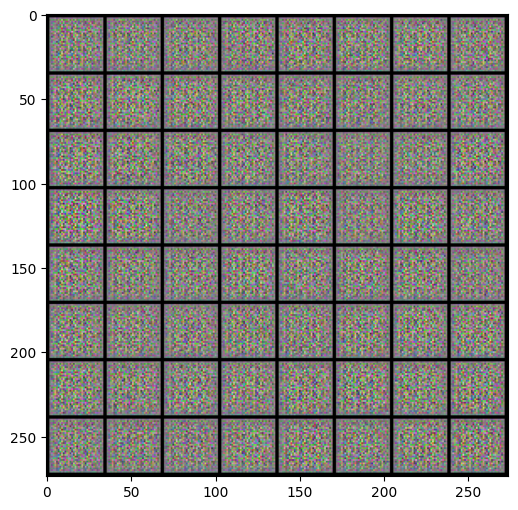

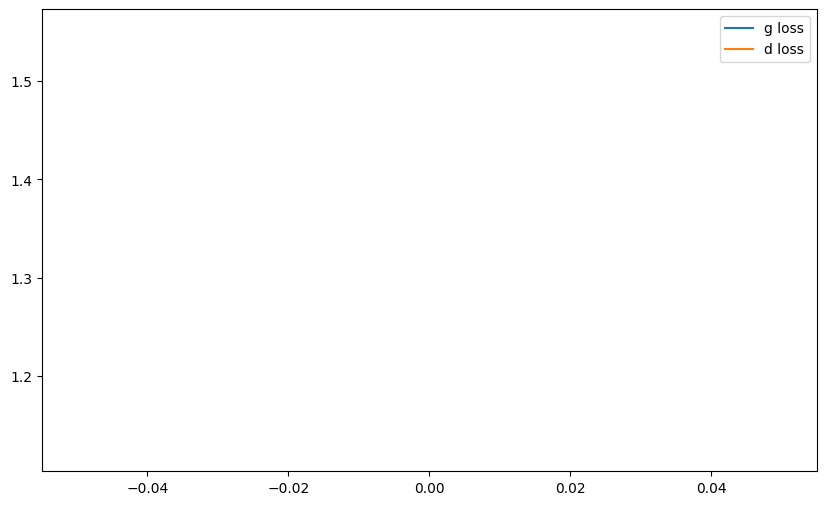

it: 200; g_loss: 0.6889073848724365; d_loss: 1.5932667255401611; avg_real_score: 0.4464808404445648; avg_fake_score: 0.5039726495742798: : 200it [00:11, 19.40it/s] 

generated images


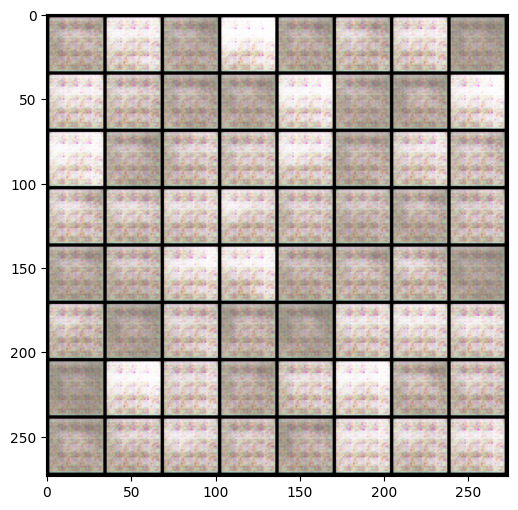

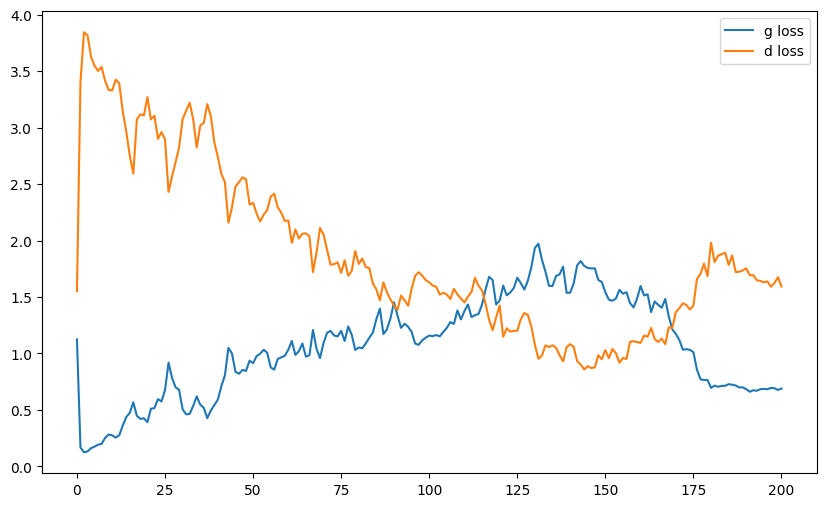

it: 390; g_loss: 0.6922520995140076; d_loss: 1.4855345487594604; avg_real_score: 0.476375013589859; avg_fake_score: 0.5050718188285828: : 391it [00:21, 18.01it/s]
it: 391; g_loss: 0.6843214631080627; d_loss: 1.4981536865234375; avg_real_score: 0.47214236855506897; avg_fake_score: 0.5082722902297974: : 0it [00:00, ?it/s]

generated images


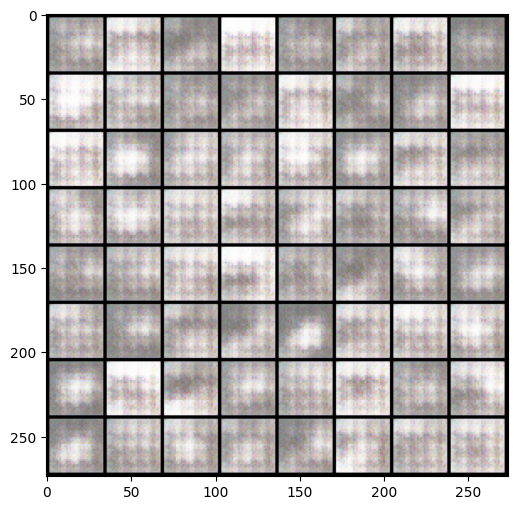

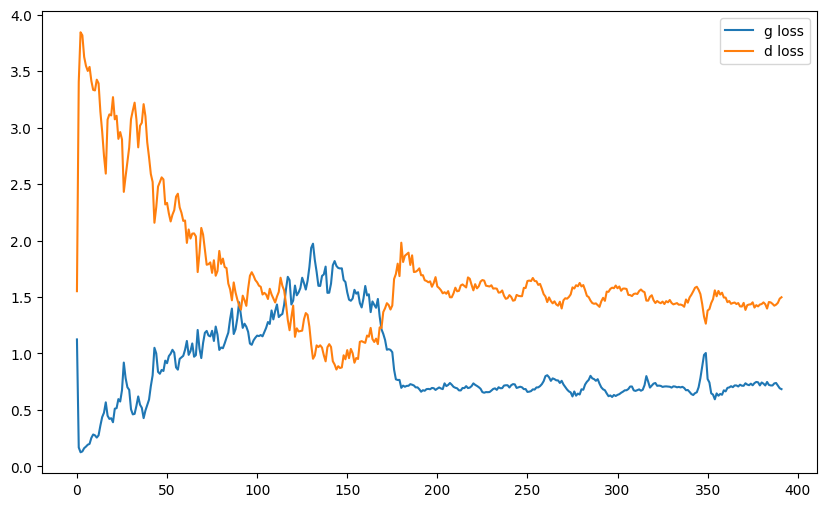

it: 591; g_loss: 0.7271713018417358; d_loss: 1.419386863708496; avg_real_score: 0.4863903820514679; avg_fake_score: 0.4840995669364929: : 199it [00:11, 17.91it/s]   

generated images


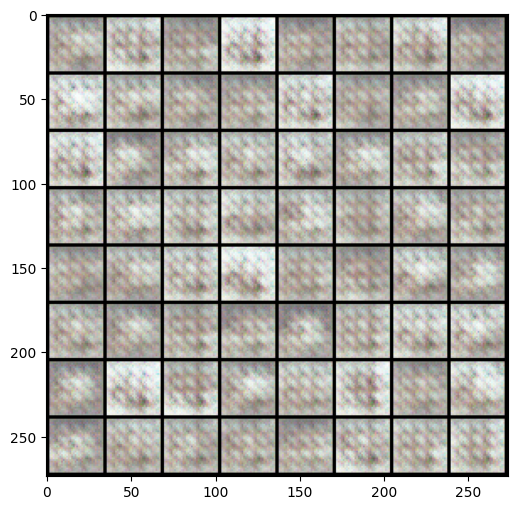

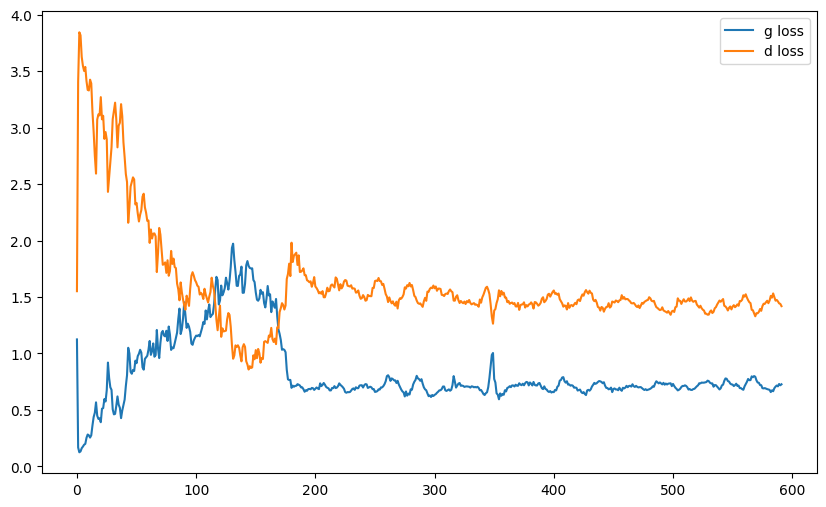

it: 781; g_loss: 0.7523400187492371; d_loss: 1.3747719526290894; avg_real_score: 0.4986095130443573; avg_fake_score: 0.4727005064487457: : 391it [00:22, 17.44it/s]
it: 782; g_loss: 0.717482328414917; d_loss: 1.403923749923706; avg_real_score: 0.4963136911392212; avg_fake_score: 0.48898762464523315: : 0it [00:00, ?it/s]

generated images


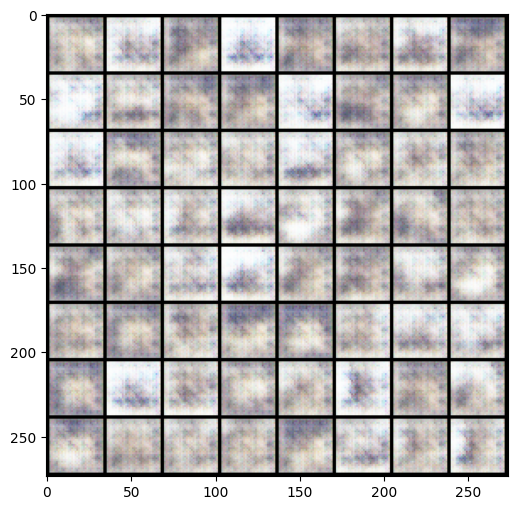

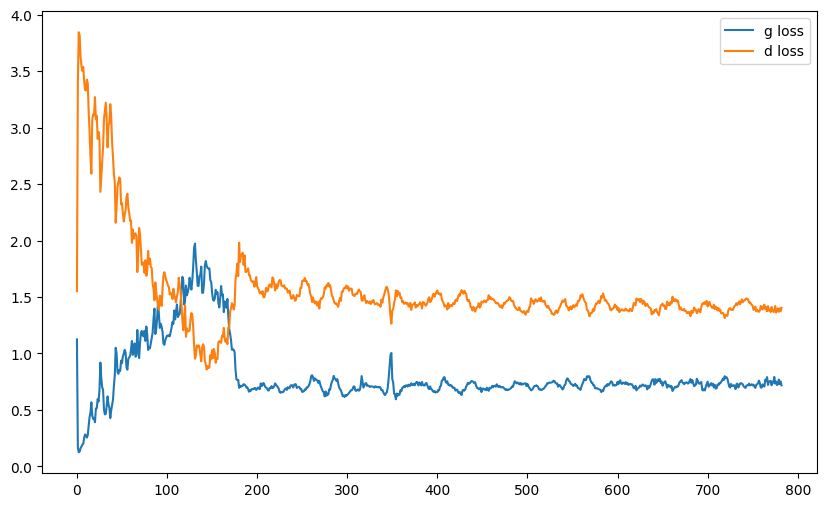

it: 982; g_loss: 0.689342737197876; d_loss: 1.4365196228027344; avg_real_score: 0.48332127928733826; avg_fake_score: 0.5032328367233276: : 199it [00:11, 18.82it/s] 

generated images


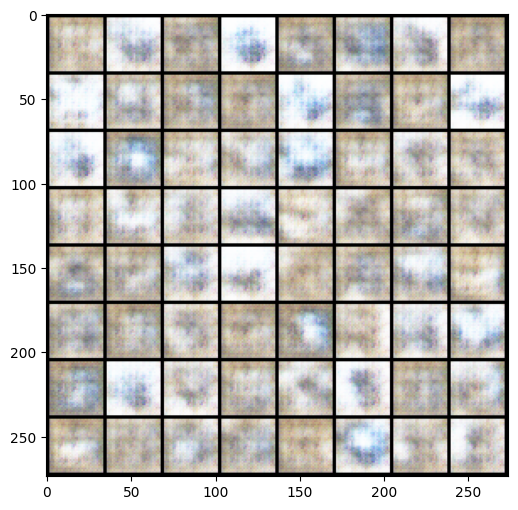

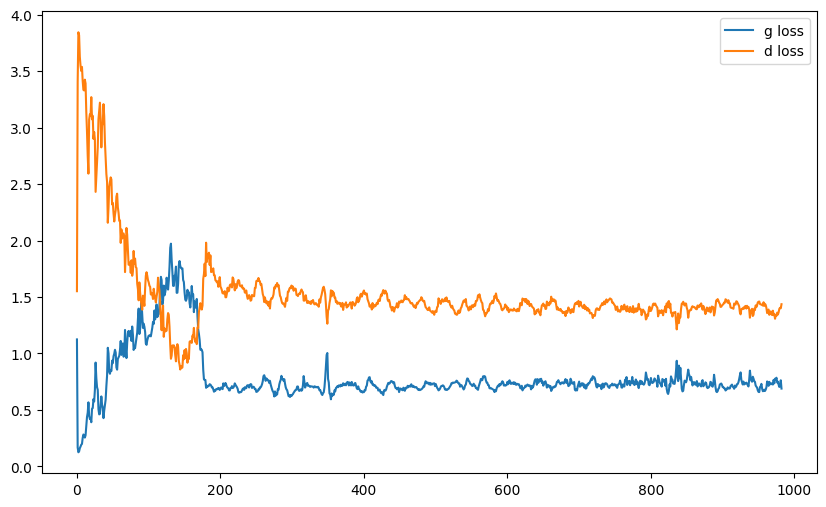

it: 1172; g_loss: 0.6988112330436707; d_loss: 1.429978847503662; avg_real_score: 0.4908493459224701; avg_fake_score: 0.49785229563713074: : 391it [00:22, 17.06it/s]
it: 1173; g_loss: 0.6943732500076294; d_loss: 1.4061267375946045; avg_real_score: 0.5031024217605591; avg_fake_score: 0.5000811219215393: : 0it [00:00, ?it/s]

generated images


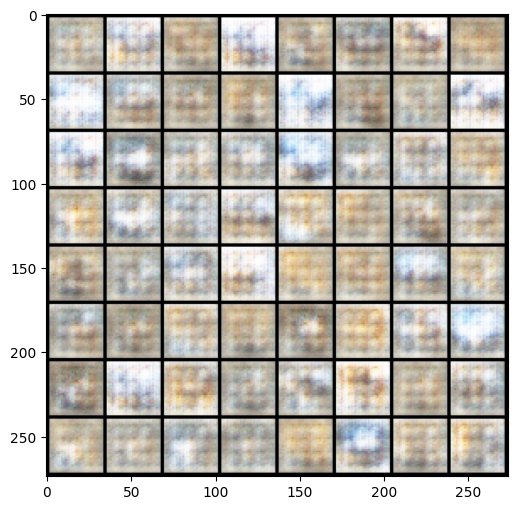

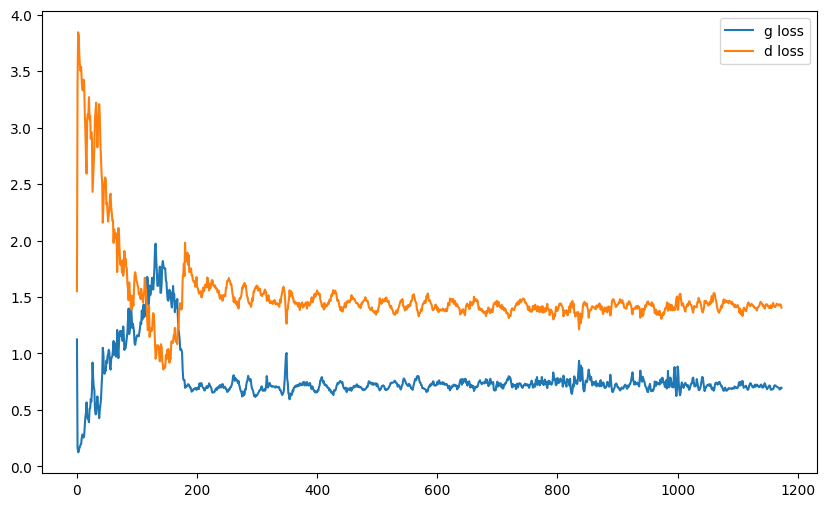

it: 1373; g_loss: 0.7055688500404358; d_loss: 1.4246962070465088; avg_real_score: 0.48651644587516785; avg_fake_score: 0.4950432777404785: : 199it [00:11, 18.52it/s]

generated images


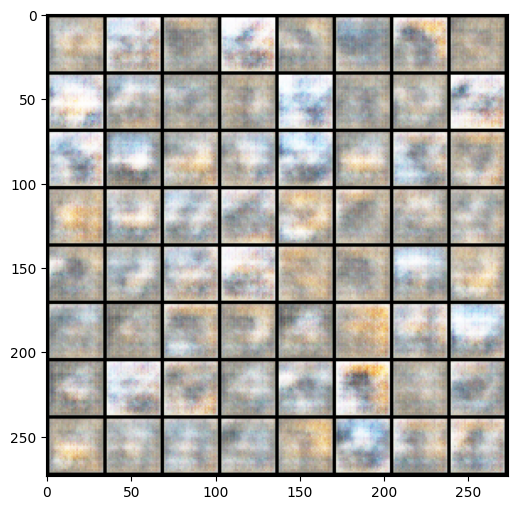

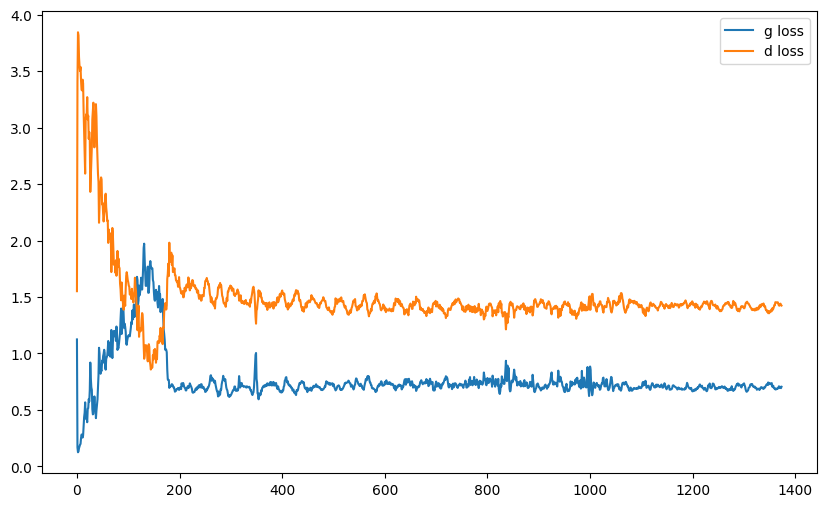

it: 1563; g_loss: 0.6744002103805542; d_loss: 1.4332118034362793; avg_real_score: 0.4984470009803772; avg_fake_score: 0.5107181072235107: : 391it [00:22, 17.64it/s]
it: 1564; g_loss: 0.6719459891319275; d_loss: 1.429004430770874; avg_real_score: 0.5015006065368652; avg_fake_score: 0.5115395784378052: : 0it [00:00, ?it/s]

generated images


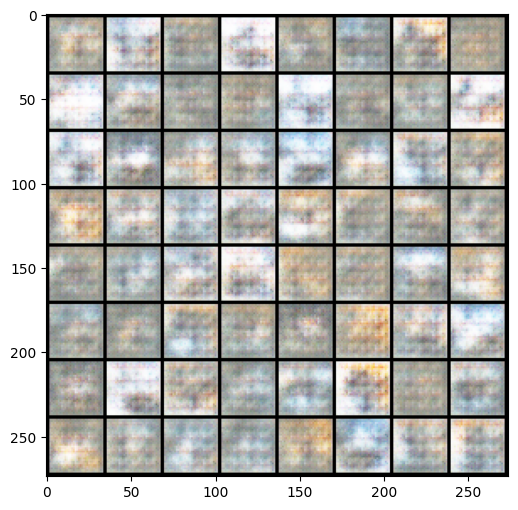

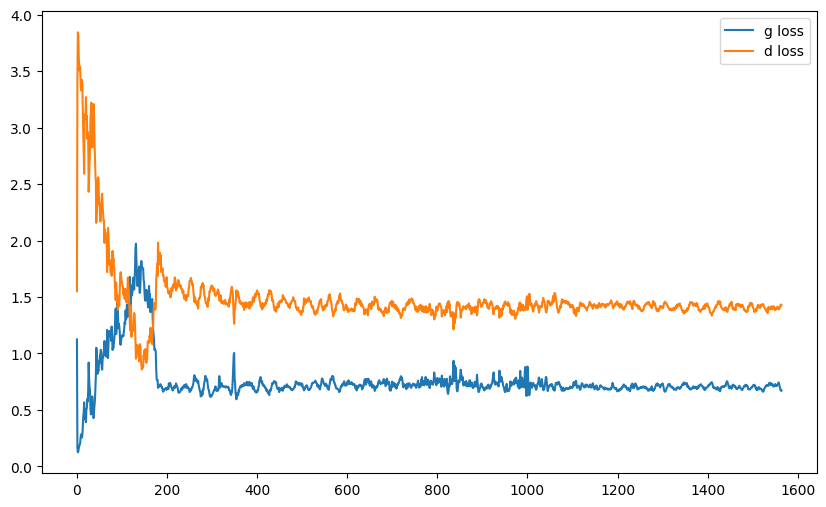

it: 1764; g_loss: 0.6940272450447083; d_loss: 1.3838518857955933; avg_real_score: 0.5060176253318787; avg_fake_score: 0.49999624490737915: : 199it [00:11, 18.84it/s]

generated images


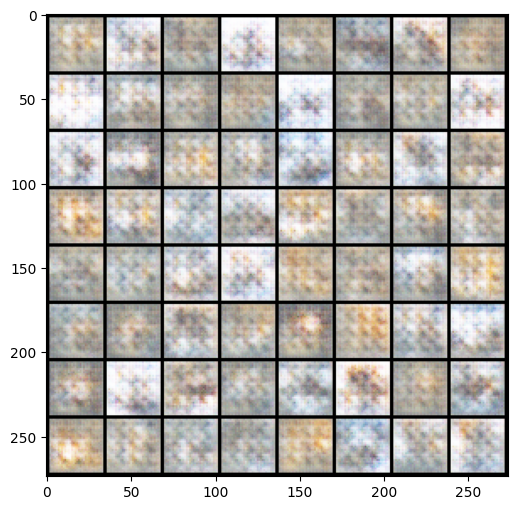

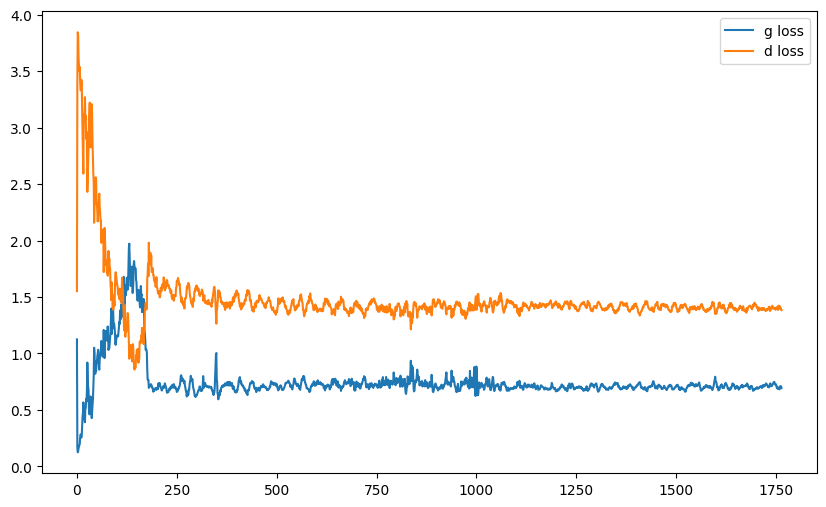

it: 1954; g_loss: 0.7173572778701782; d_loss: 1.3928132057189941; avg_real_score: 0.4894007742404938; avg_fake_score: 0.4890921711921692: : 391it [00:22, 17.07it/s]
it: 1955; g_loss: 0.7198591232299805; d_loss: 1.3704429864883423; avg_real_score: 0.5029994249343872; avg_fake_score: 0.4882515072822571: : 0it [00:00, ?it/s]

generated images


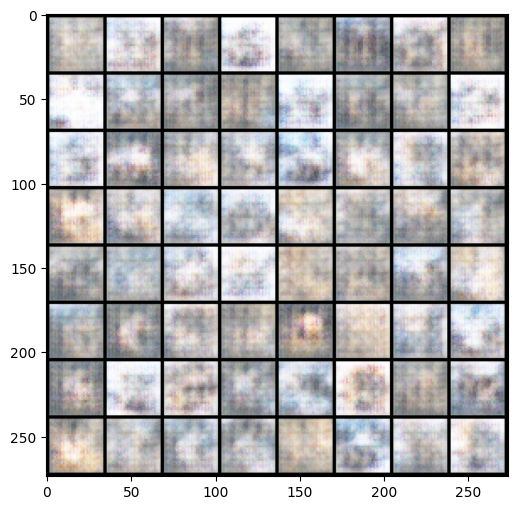

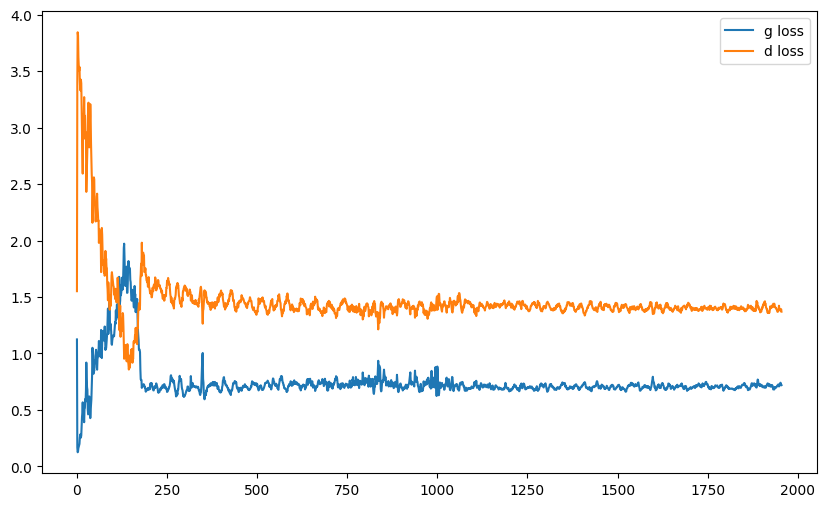

it: 2155; g_loss: 0.7040897607803345; d_loss: 1.3983967304229736; avg_real_score: 0.49204394221305847; avg_fake_score: 0.4951176643371582: : 199it [00:11, 18.93it/s]

generated images


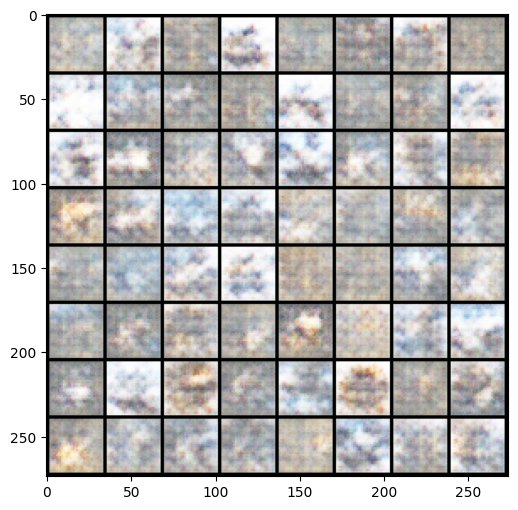

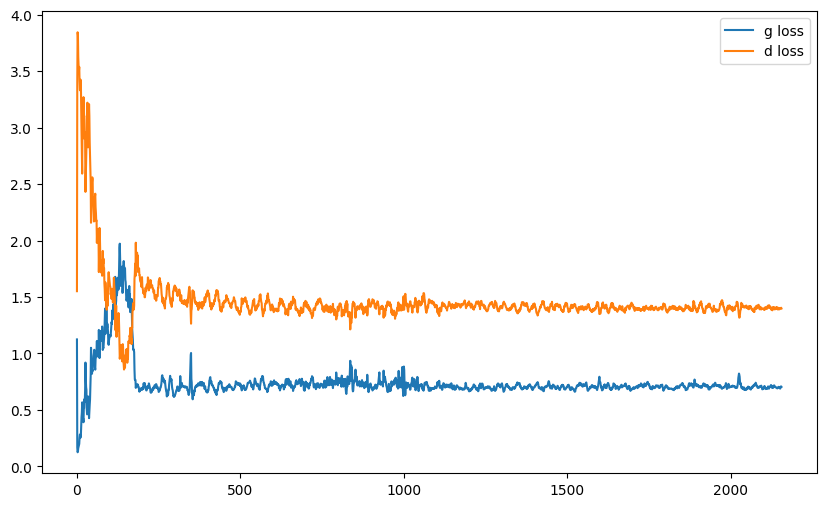

it: 2345; g_loss: 0.6911645531654358; d_loss: 1.4130446910858154; avg_real_score: 0.4902796745300293; avg_fake_score: 0.5019245743751526: : 391it [00:22, 17.12it/s]
it: 2346; g_loss: 0.6978248357772827; d_loss: 1.392497181892395; avg_real_score: 0.500825047492981; avg_fake_score: 0.4983641505241394: : 0it [00:00, ?it/s]

generated images


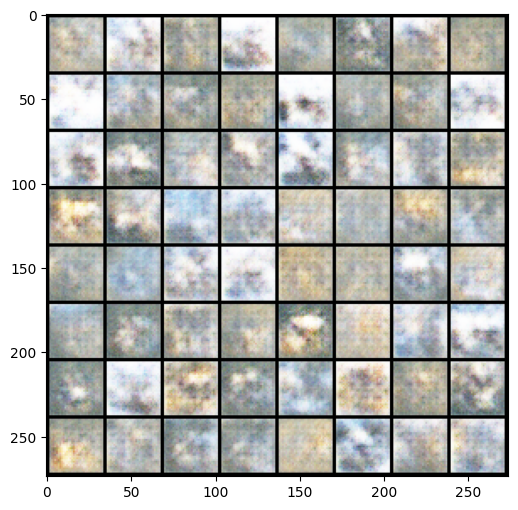

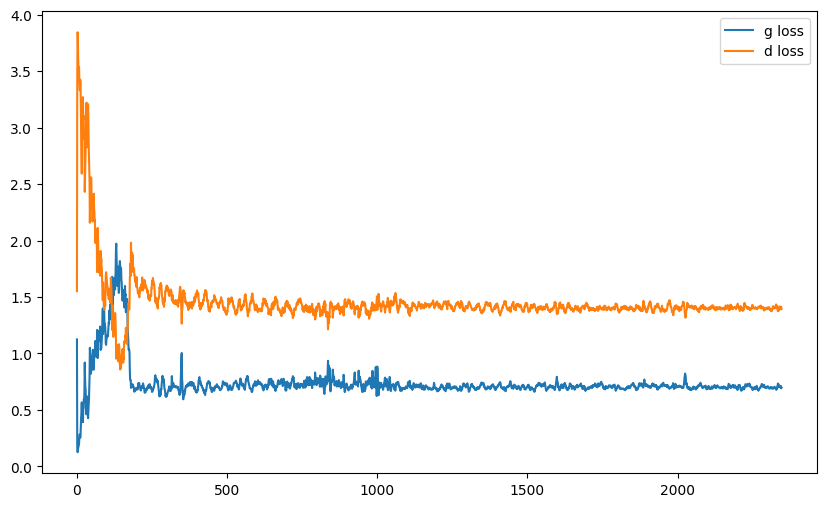

it: 2546; g_loss: 0.7147531509399414; d_loss: 1.4000743627548218; avg_real_score: 0.4865560531616211; avg_fake_score: 0.4897703230381012: : 199it [00:11, 16.92it/s] 

generated images


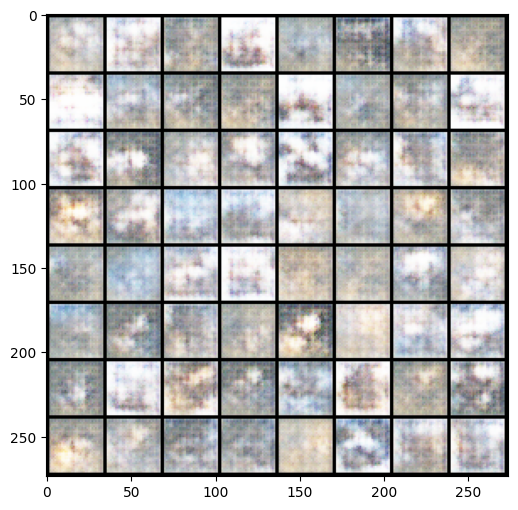

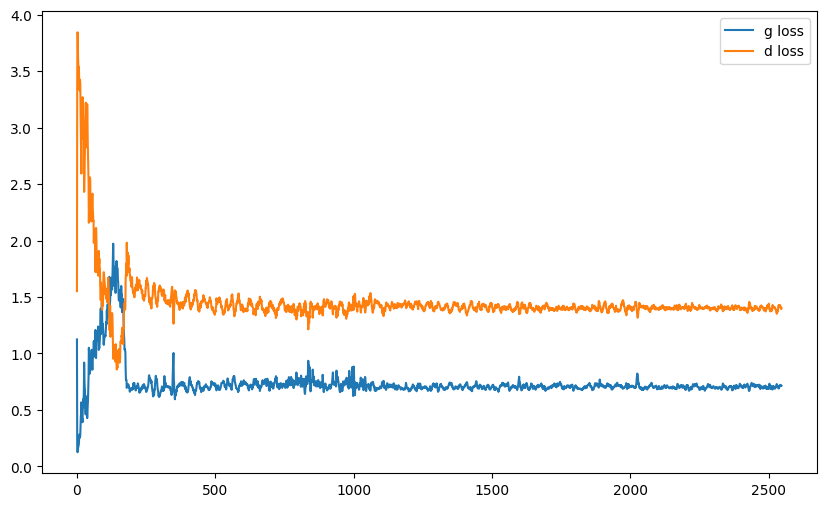

it: 2736; g_loss: 0.6956396698951721; d_loss: 1.3799247741699219; avg_real_score: 0.5090146660804749; avg_fake_score: 0.49954959750175476: : 391it [00:22, 17.56it/s]
it: 2737; g_loss: 0.6975692510604858; d_loss: 1.384331226348877; avg_real_score: 0.5081875324249268; avg_fake_score: 0.4988858997821808: : 0it [00:00, ?it/s]

generated images


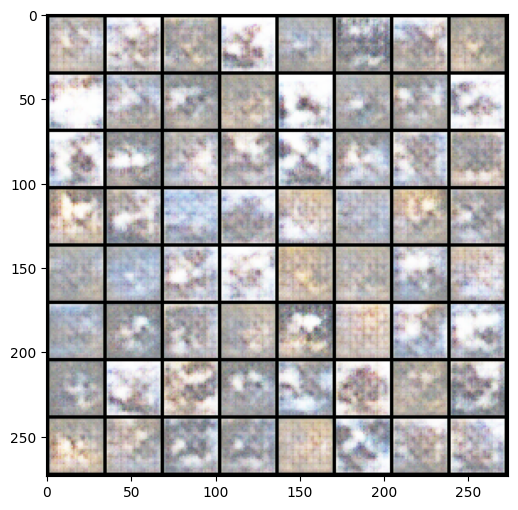

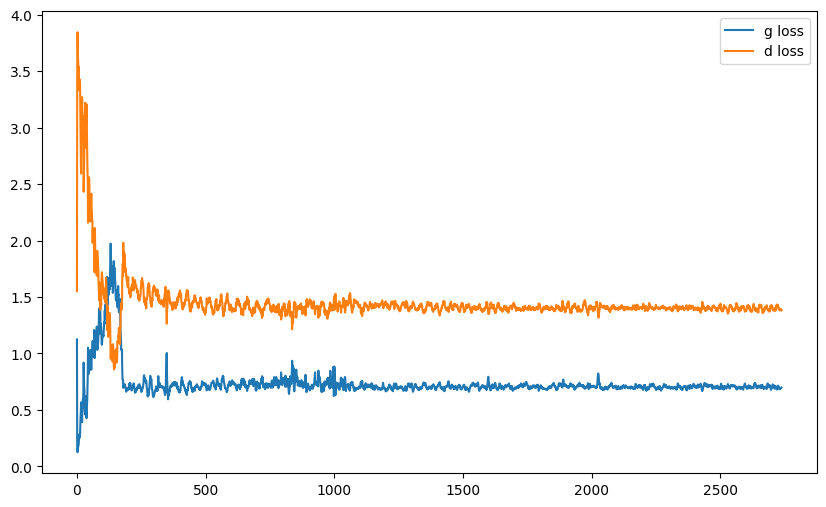

it: 2937; g_loss: 0.709071159362793; d_loss: 1.3890095949172974; avg_real_score: 0.5001332759857178; avg_fake_score: 0.4928790330886841: : 199it [00:12, 18.04it/s]

generated images


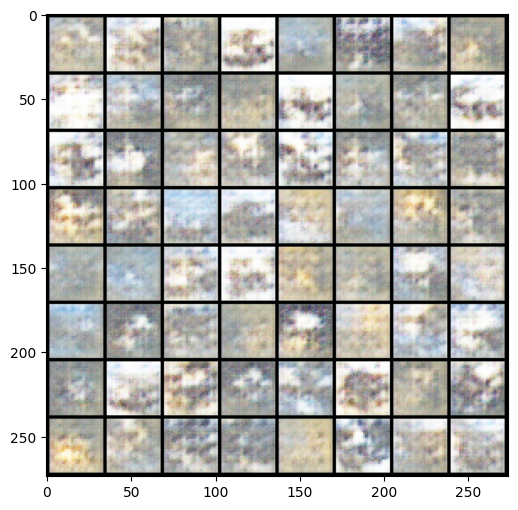

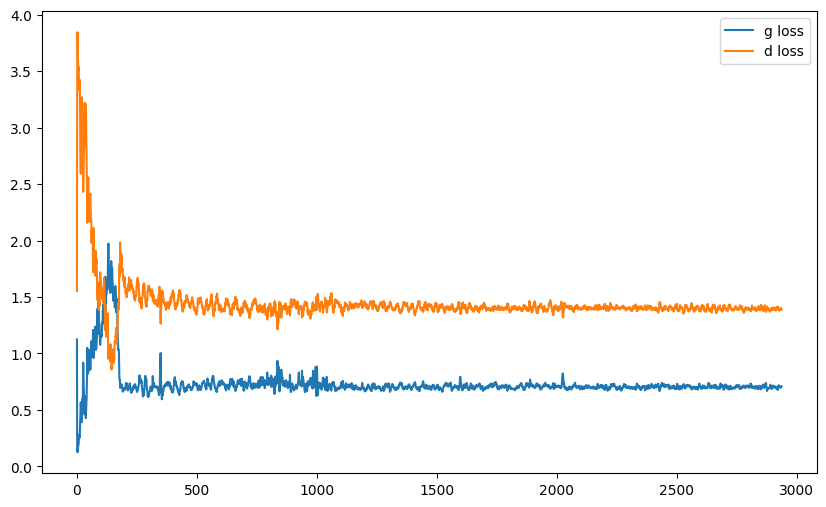

it: 3127; g_loss: 0.7213460803031921; d_loss: 1.3887124061584473; avg_real_score: 0.4925130307674408; avg_fake_score: 0.48674580454826355: : 391it [00:23, 16.80it/s]
it: 3128; g_loss: 0.7154420614242554; d_loss: 1.3767340183258057; avg_real_score: 0.5016502737998962; avg_fake_score: 0.4898689389228821: : 0it [00:00, ?it/s]

generated images


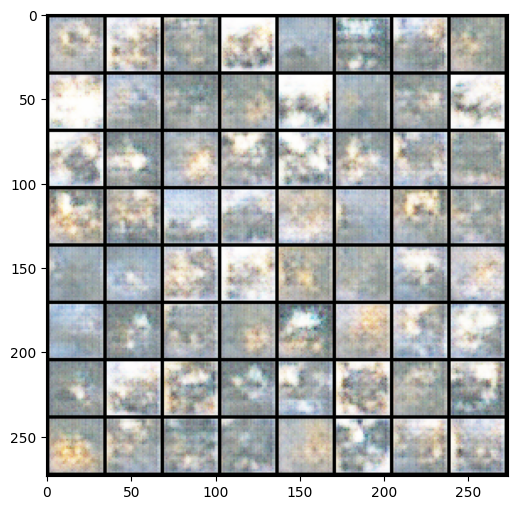

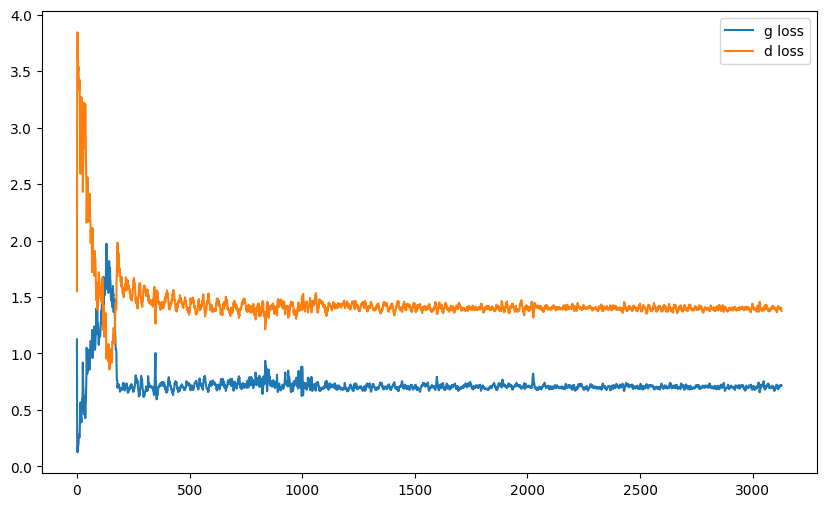

it: 3328; g_loss: 0.7040696144104004; d_loss: 1.3726048469543457; avg_real_score: 0.5079332590103149; avg_fake_score: 0.49479761719703674: : 199it [00:11, 18.08it/s]

generated images


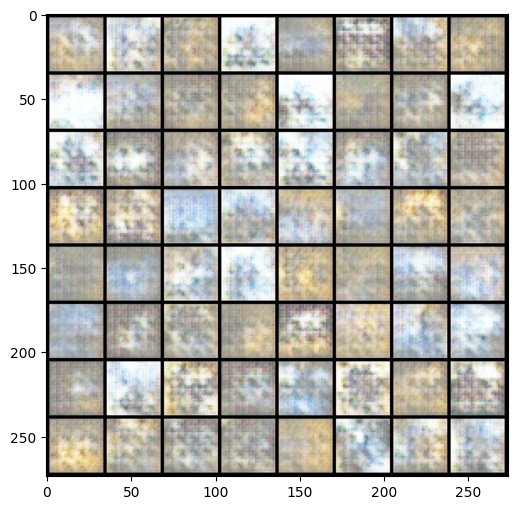

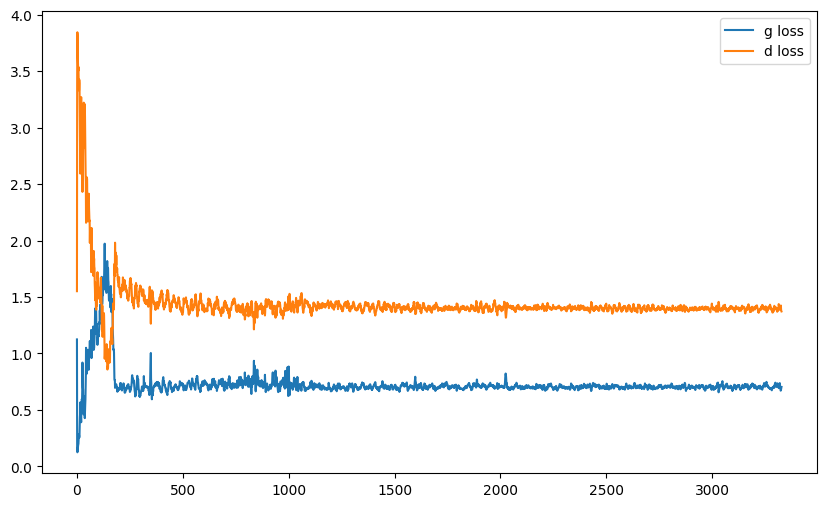

it: 3518; g_loss: 0.7058166265487671; d_loss: 1.379491925239563; avg_real_score: 0.5009689927101135; avg_fake_score: 0.4942874610424042: : 391it [00:22, 17.05it/s]
it: 3519; g_loss: 0.6998974084854126; d_loss: 1.3826816082000732; avg_real_score: 0.5040773153305054; avg_fake_score: 0.49722352623939514: : 0it [00:00, ?it/s]

generated images


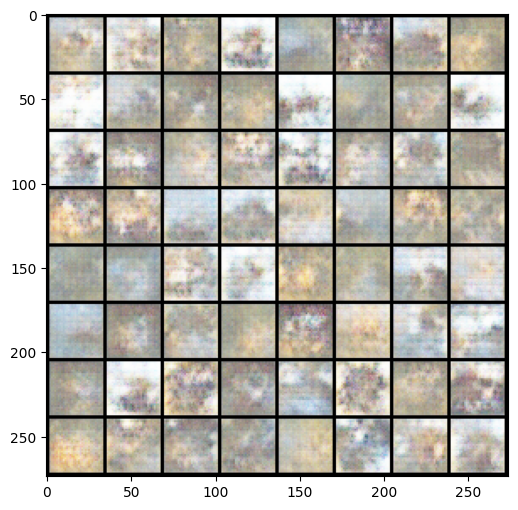

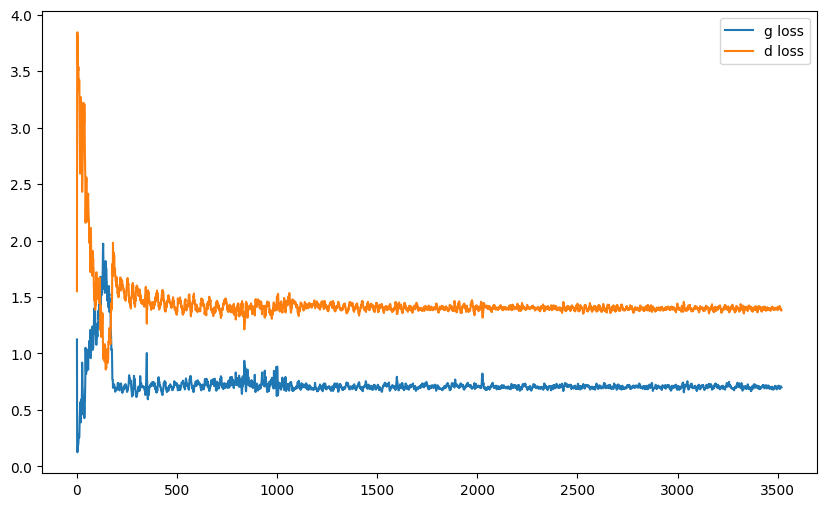

it: 3719; g_loss: 0.7099283933639526; d_loss: 1.3819952011108398; avg_real_score: 0.4961753487586975; avg_fake_score: 0.4921520948410034: : 199it [00:11, 17.26it/s]

generated images


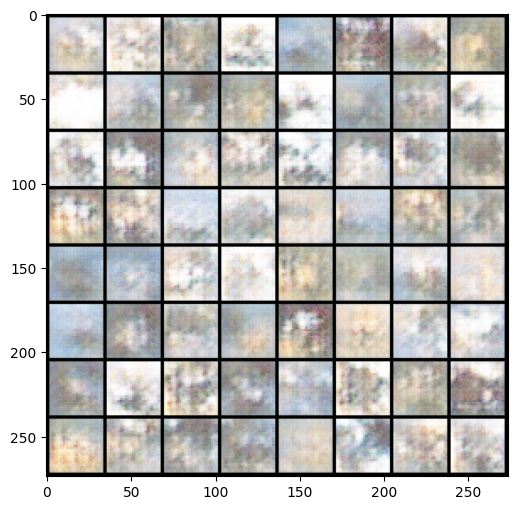

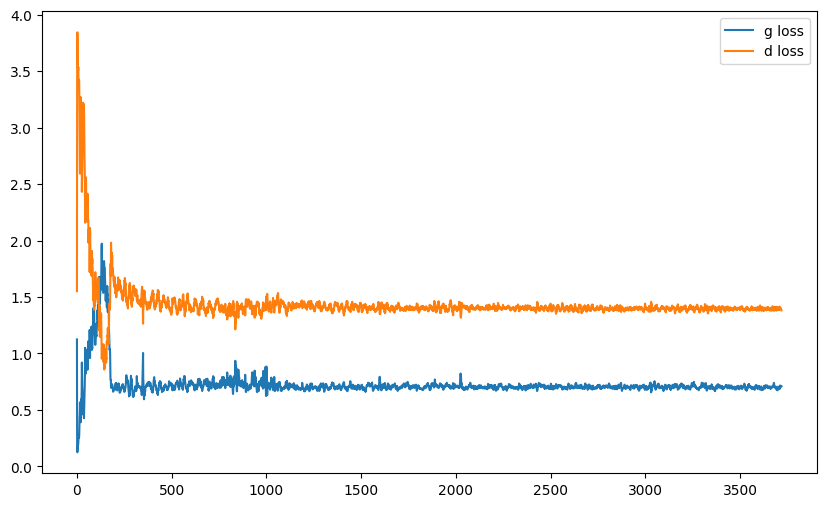

it: 3909; g_loss: 0.6975260376930237; d_loss: 1.4102180004119873; avg_real_score: 0.49525460600852966; avg_fake_score: 0.4983060956001282: : 391it [00:22, 17.60it/s]
it: 3910; g_loss: 0.7013773918151855; d_loss: 1.4134833812713623; avg_real_score: 0.49062490463256836; avg_fake_score: 0.49638062715530396: : 0it [00:00, ?it/s]

generated images


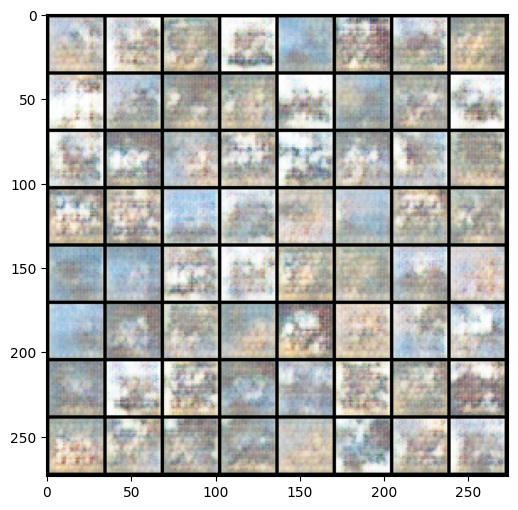

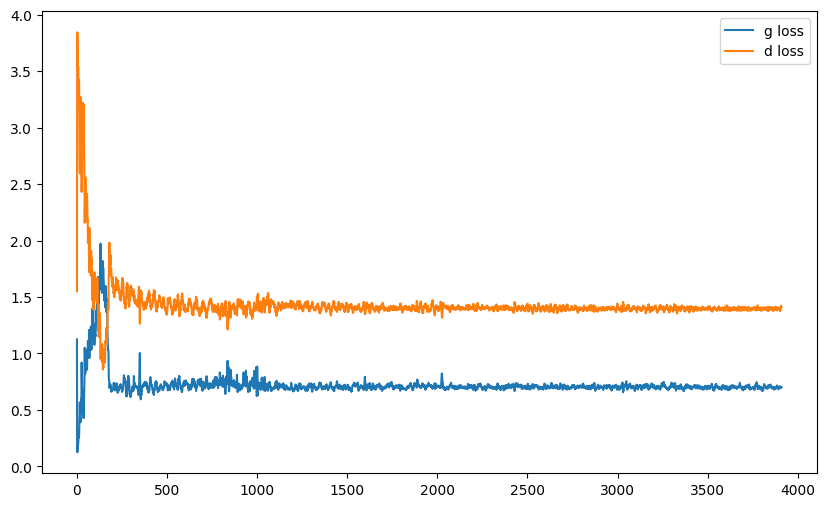

it: 4110; g_loss: 0.7016241550445557; d_loss: 1.3938148021697998; avg_real_score: 0.5013854503631592; avg_fake_score: 0.4964819848537445: : 199it [00:11, 18.39it/s]

generated images


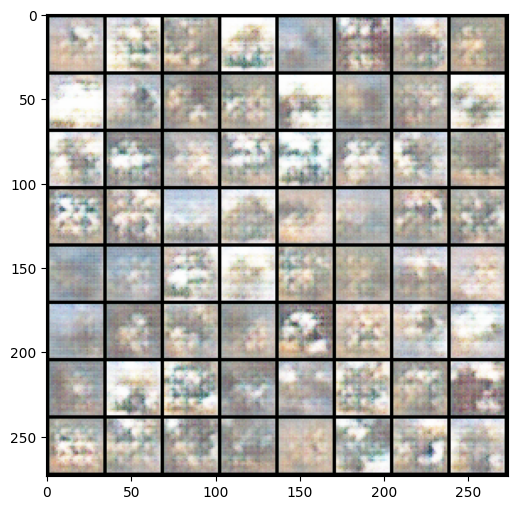

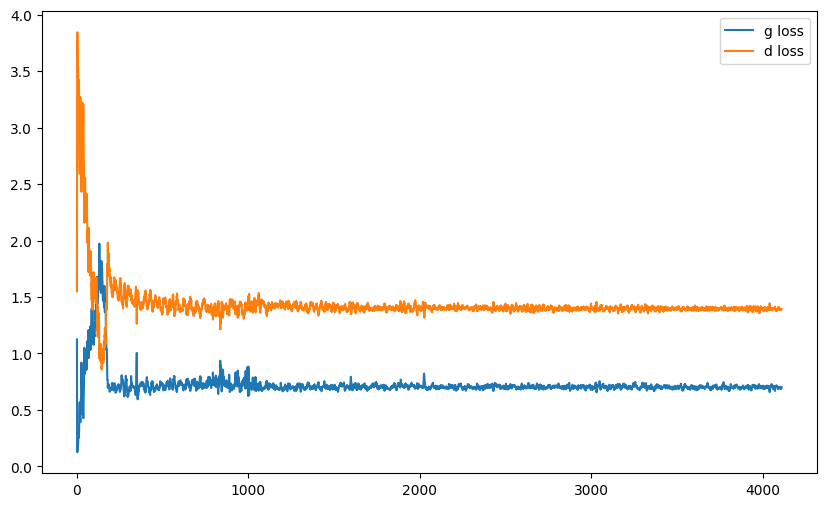

it: 4300; g_loss: 0.7329978346824646; d_loss: 1.3987252712249756; avg_real_score: 0.48762306571006775; avg_fake_score: 0.4808763563632965: : 391it [00:22, 17.14it/s]
it: 4301; g_loss: 0.7324100732803345; d_loss: 1.3952808380126953; avg_real_score: 0.4831567108631134; avg_fake_score: 0.48129427433013916: : 0it [00:00, ?it/s]

generated images


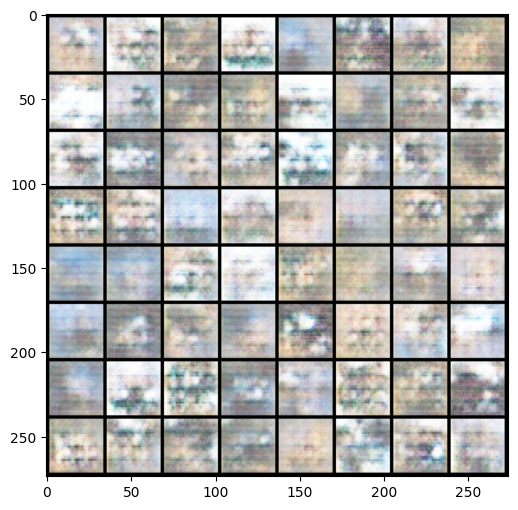

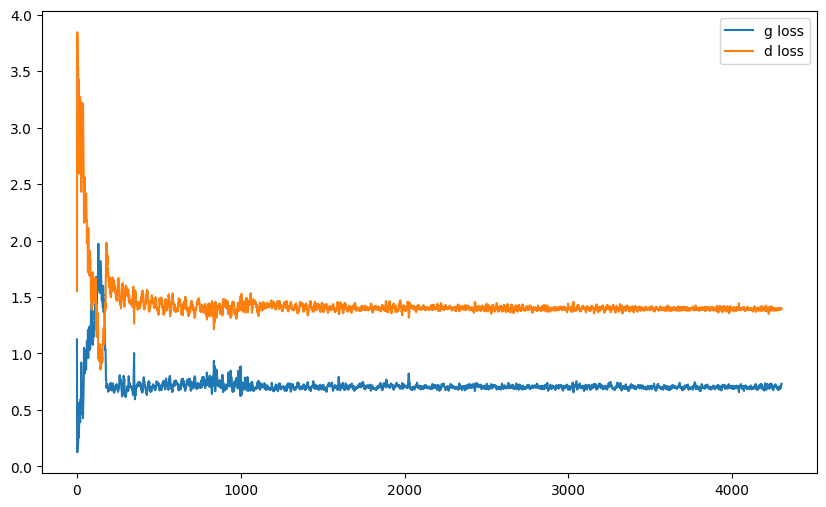

it: 4501; g_loss: 0.6854543089866638; d_loss: 1.3921470642089844; avg_real_score: 0.5075497627258301; avg_fake_score: 0.5047073364257812: : 199it [00:11, 19.16it/s]

generated images


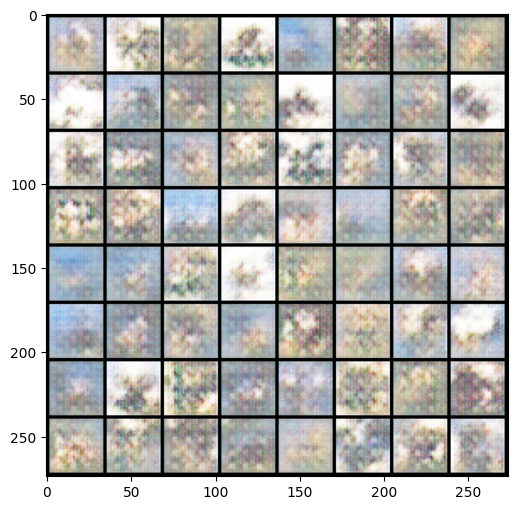

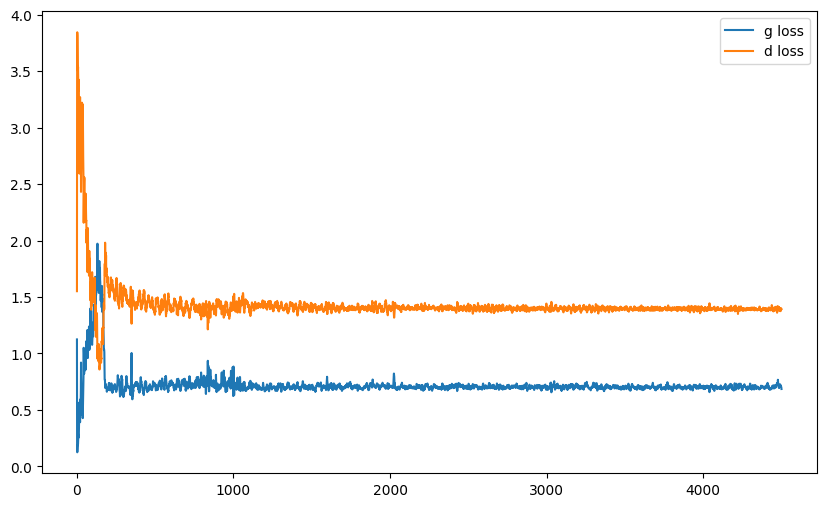

it: 4691; g_loss: 0.7182149291038513; d_loss: 1.3741363286972046; avg_real_score: 0.4965229034423828; avg_fake_score: 0.4890182912349701: : 391it [00:22, 17.34it/s]
it: 4692; g_loss: 0.7045465707778931; d_loss: 1.377761960029602; avg_real_score: 0.5033786296844482; avg_fake_score: 0.4956752061843872: : 0it [00:00, ?it/s]

generated images


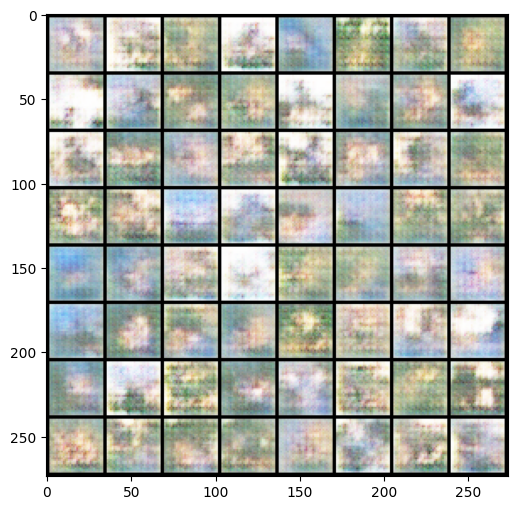

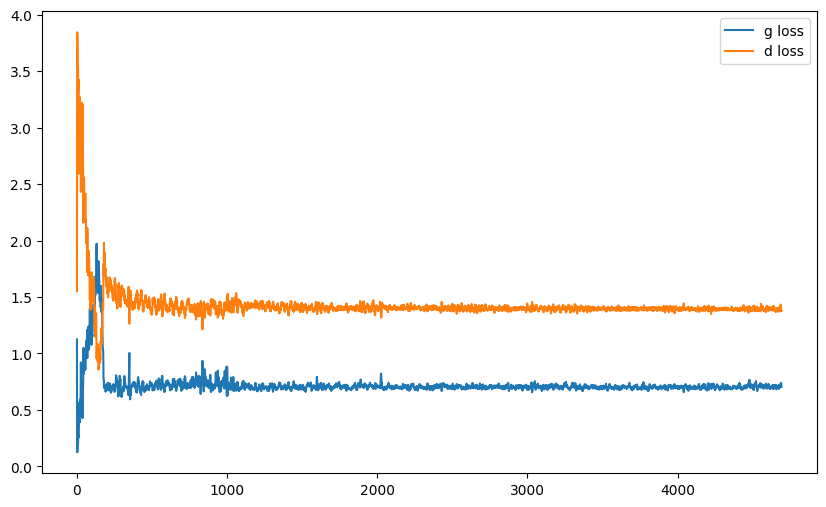

it: 4892; g_loss: 0.7155075669288635; d_loss: 1.379921555519104; avg_real_score: 0.4980643689632416; avg_fake_score: 0.4896627962589264: : 199it [00:11, 17.80it/s]  

generated images


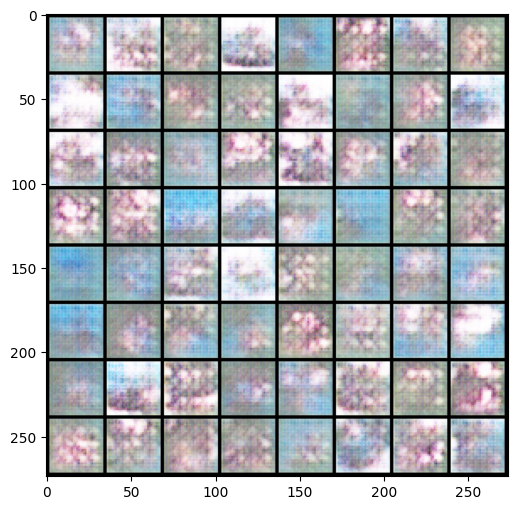

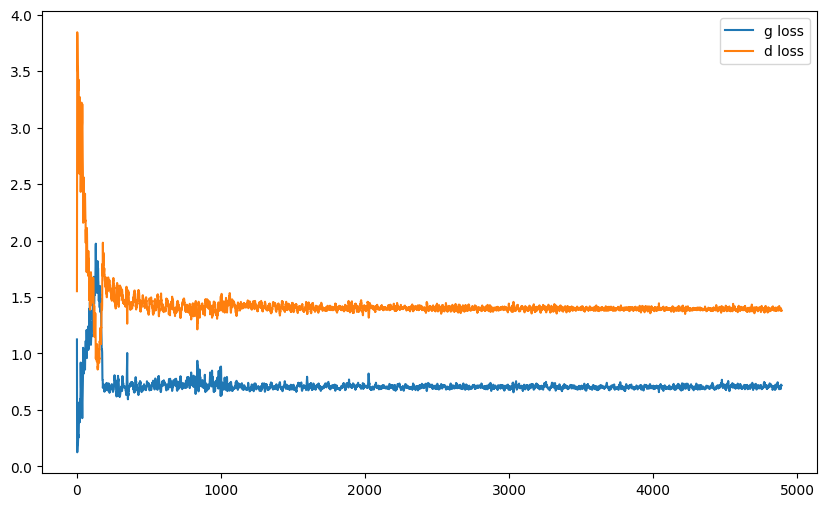

it: 5082; g_loss: 0.680029034614563; d_loss: 1.4005322456359863; avg_real_score: 0.5040565133094788; avg_fake_score: 0.5068340301513672: : 391it [00:22, 17.25it/s]
it: 5083; g_loss: 0.6848683953285217; d_loss: 1.3845977783203125; avg_real_score: 0.5136277675628662; avg_fake_score: 0.5043939352035522: : 0it [00:00, ?it/s]

generated images


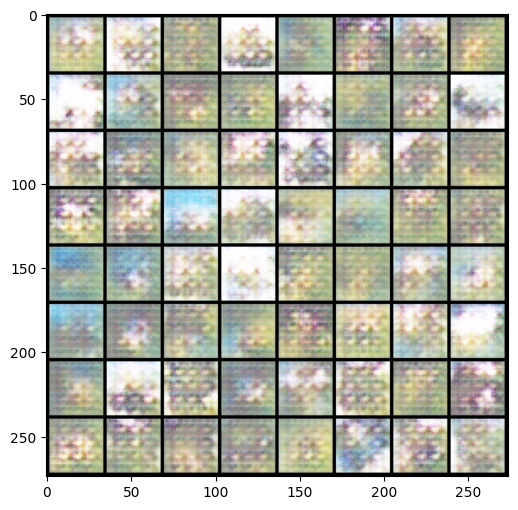

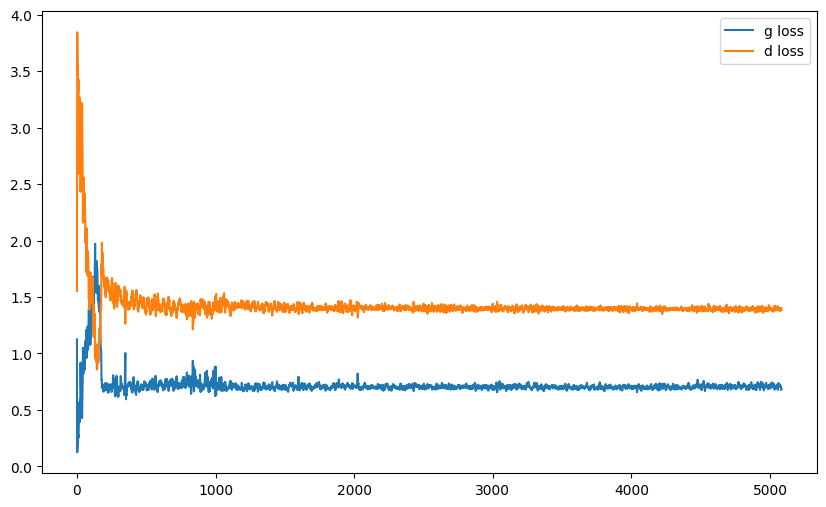

it: 5283; g_loss: 0.7088959813117981; d_loss: 1.3824992179870605; avg_real_score: 0.49666857719421387; avg_fake_score: 0.4927900433540344: : 199it [00:11, 18.40it/s]

generated images


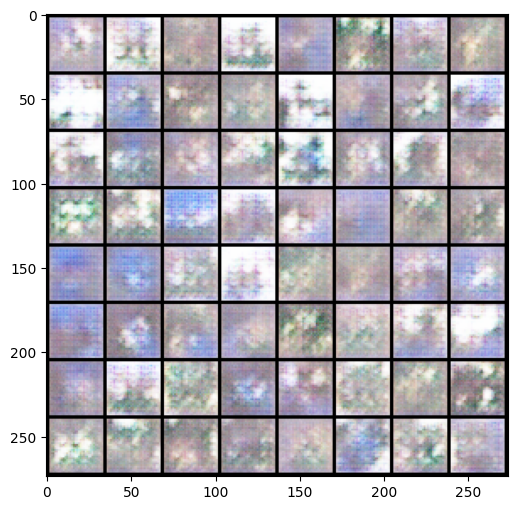

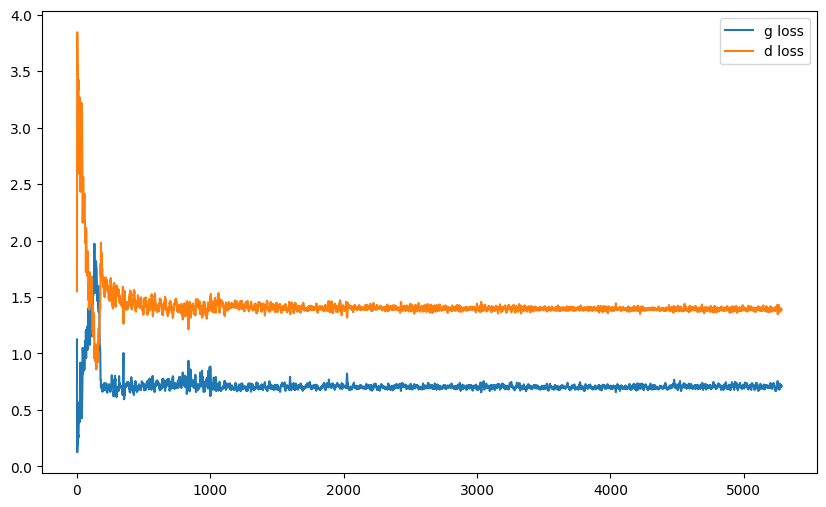

it: 5473; g_loss: 0.675076425075531; d_loss: 1.4159915447235107; avg_real_score: 0.49743714928627014; avg_fake_score: 0.5099319815635681: : 391it [00:22, 17.01it/s]
it: 5474; g_loss: 0.6586029529571533; d_loss: 1.4073562622070312; avg_real_score: 0.513336181640625; avg_fake_score: 0.5180742740631104: : 0it [00:00, ?it/s]

generated images


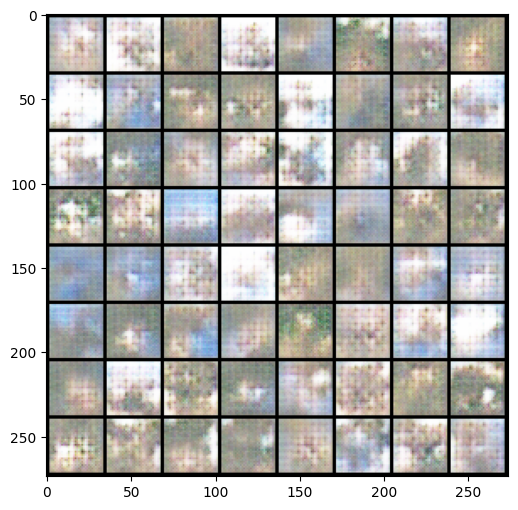

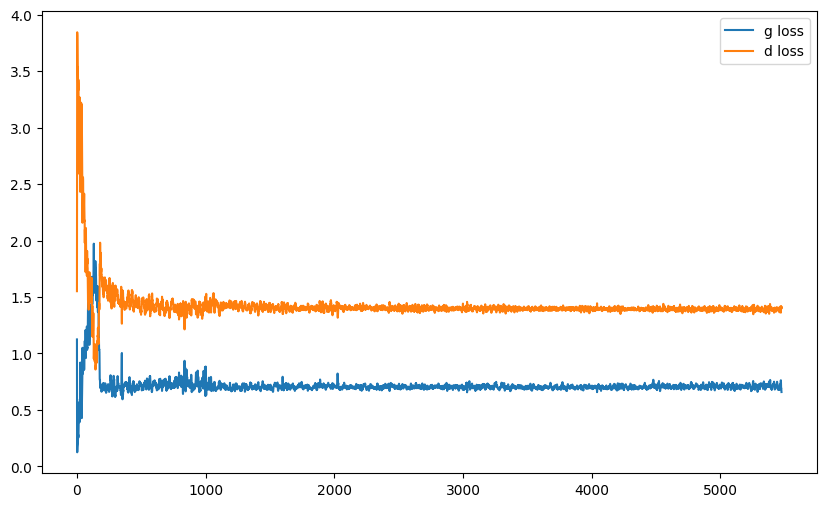

it: 5674; g_loss: 0.7597160339355469; d_loss: 1.342466115951538; avg_real_score: 0.5246358513832092; avg_fake_score: 0.4704594314098358: : 199it [00:11, 18.25it/s]  

generated images


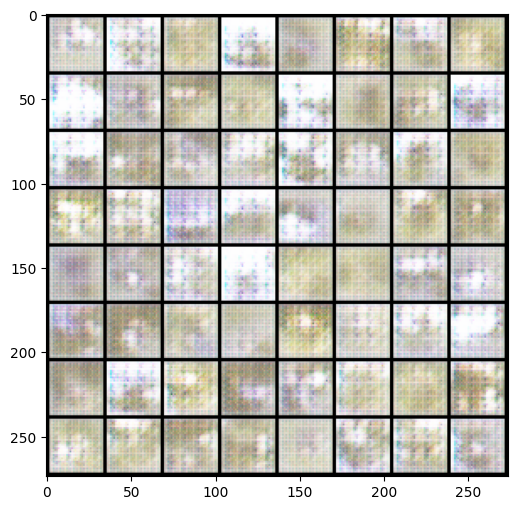

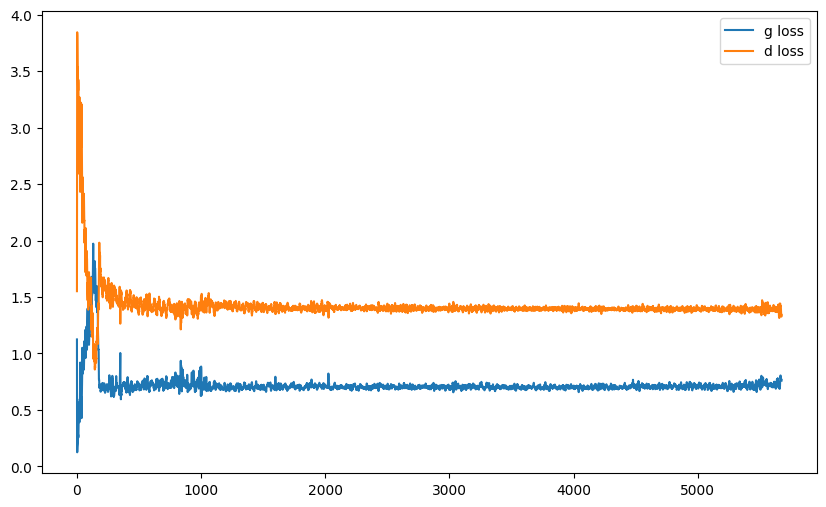

it: 5864; g_loss: 0.8156518936157227; d_loss: 1.3637715578079224; avg_real_score: 0.4857816696166992; avg_fake_score: 0.447740375995636: : 391it [00:23, 16.91it/s]
it: 5865; g_loss: 0.8764370679855347; d_loss: 1.3668012619018555; avg_real_score: 0.5412328243255615; avg_fake_score: 0.4268289804458618: : 0it [00:00, ?it/s]

generated images


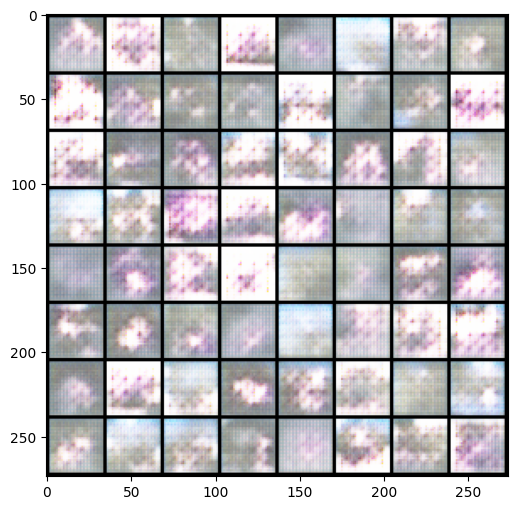

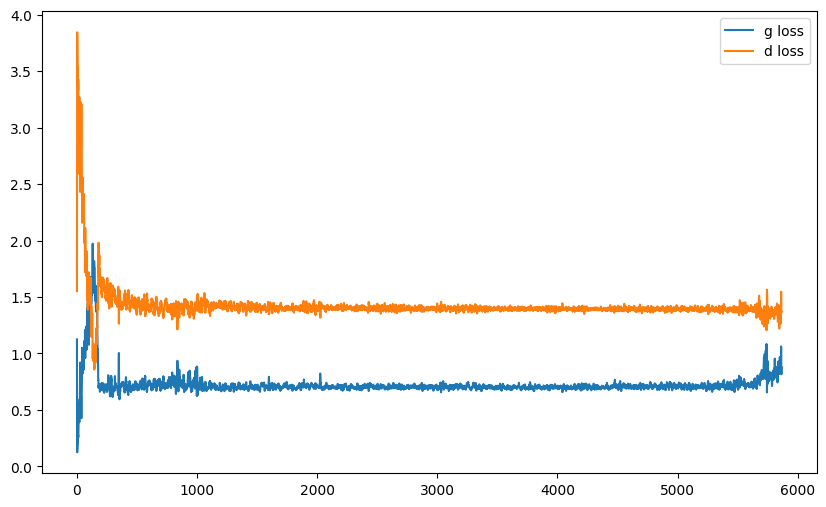

it: 6065; g_loss: 0.7927542328834534; d_loss: 1.4654630422592163; avg_real_score: 0.4923768639564514; avg_fake_score: 0.45608824491500854: : 199it [00:11, 17.09it/s]

generated images


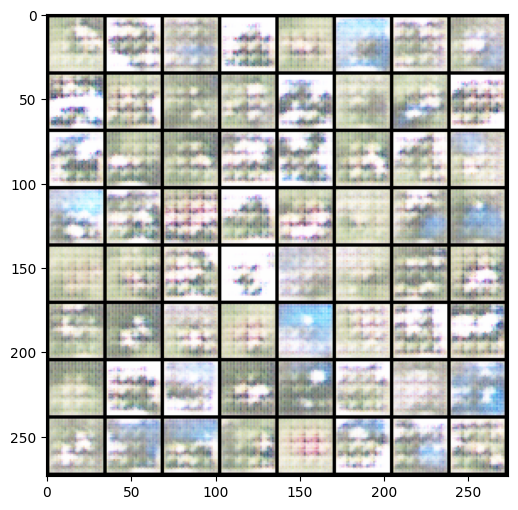

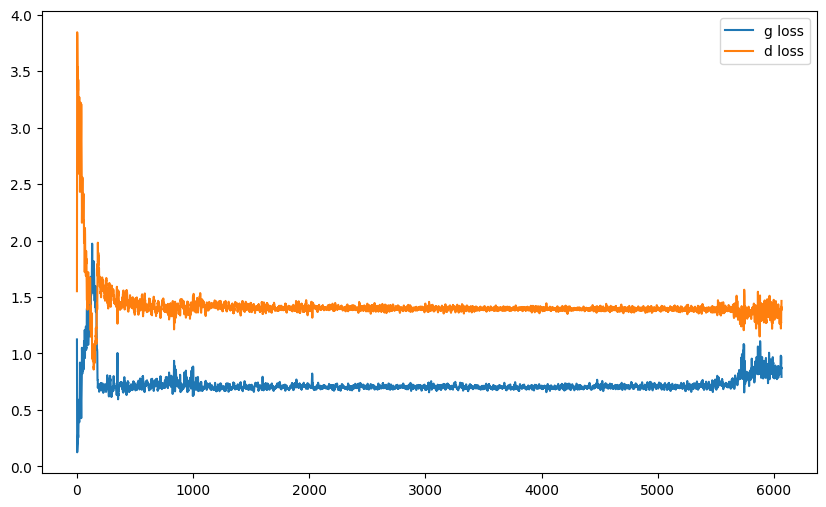

it: 6255; g_loss: 0.7884654998779297; d_loss: 1.4033623933792114; avg_real_score: 0.4831022322177887; avg_fake_score: 0.45885348320007324: : 391it [00:23, 16.91it/s]
it: 6256; g_loss: 0.8086326718330383; d_loss: 1.3645648956298828; avg_real_score: 0.5063178539276123; avg_fake_score: 0.4513430595397949: : 0it [00:00, ?it/s]

generated images


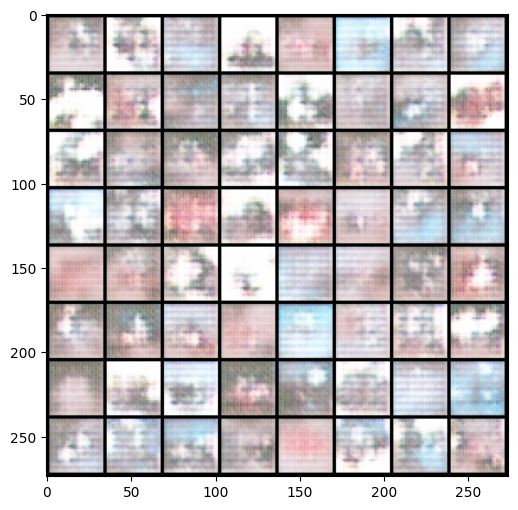

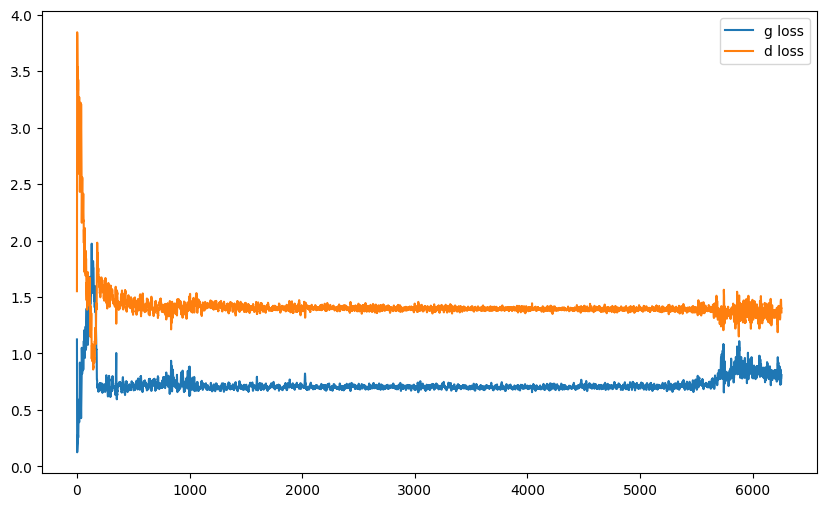

it: 6456; g_loss: 0.8253004550933838; d_loss: 1.3074207305908203; avg_real_score: 0.5229607224464417; avg_fake_score: 0.44202879071235657: : 199it [00:11, 18.24it/s]

generated images


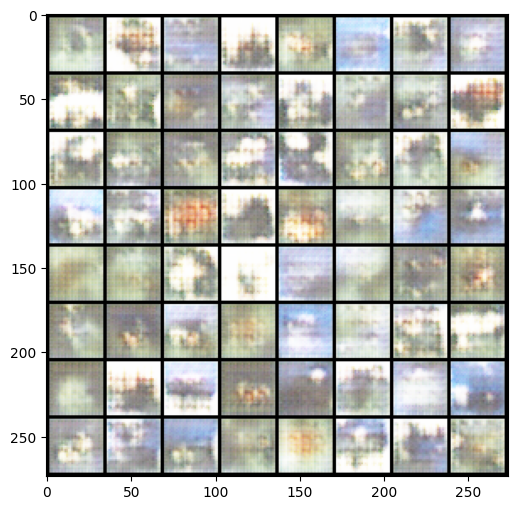

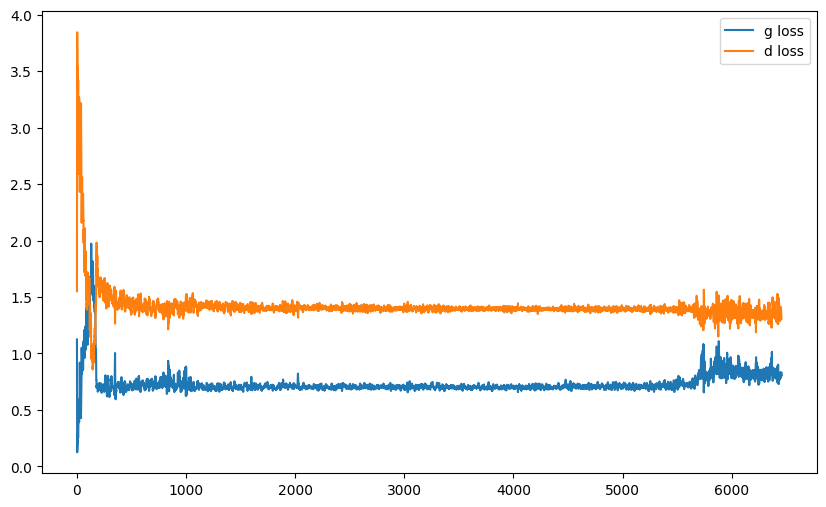

it: 6646; g_loss: 0.8272647857666016; d_loss: 1.3808759450912476; avg_real_score: 0.5196369290351868; avg_fake_score: 0.443313330411911: : 391it [00:23, 16.70it/s]
it: 6647; g_loss: 0.8490308523178101; d_loss: 1.3419461250305176; avg_real_score: 0.5118417739868164; avg_fake_score: 0.43341153860092163: : 0it [00:00, ?it/s]

generated images


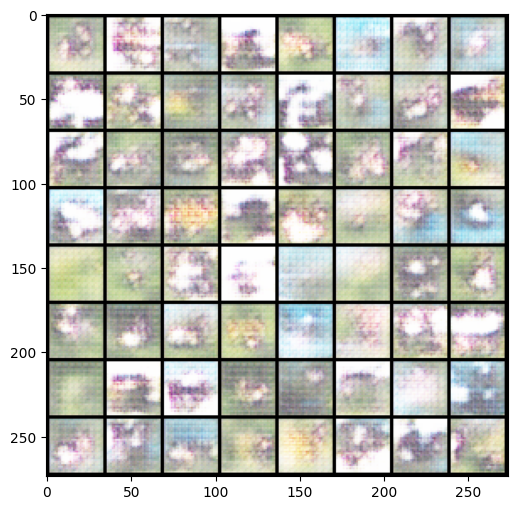

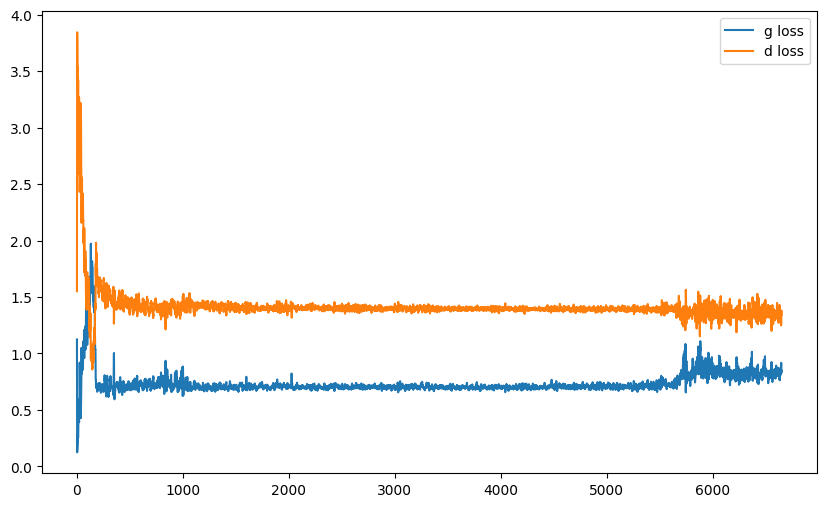

it: 6847; g_loss: 0.8084683418273926; d_loss: 1.3248870372772217; avg_real_score: 0.5307410955429077; avg_fake_score: 0.4531295597553253: : 199it [00:11, 18.76it/s]

generated images


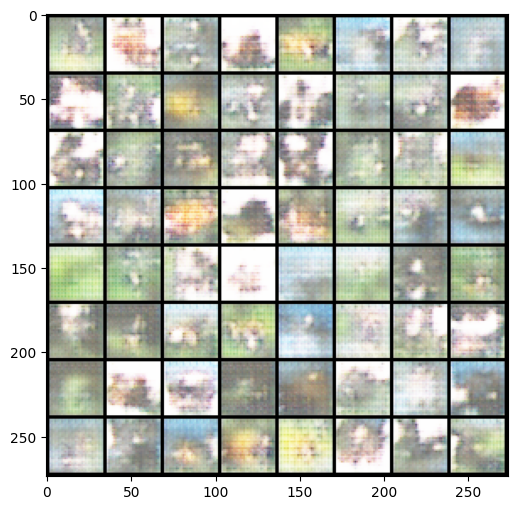

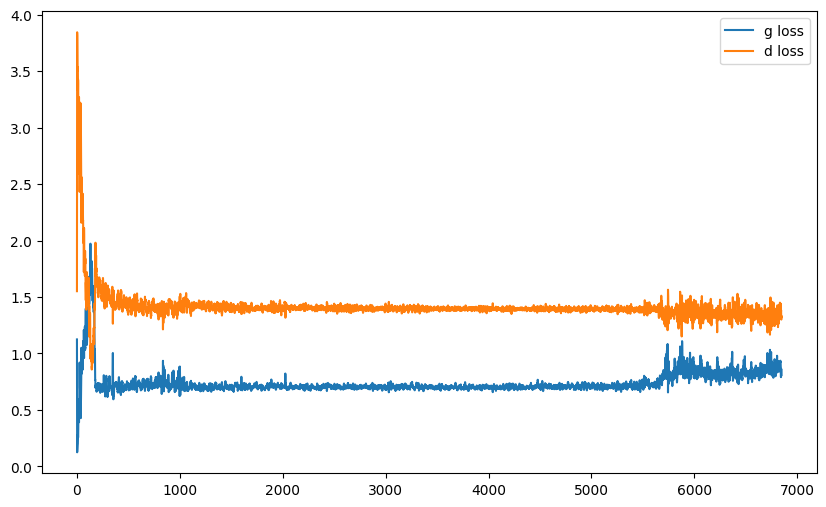

it: 7037; g_loss: 0.8278408050537109; d_loss: 1.3719522953033447; avg_real_score: 0.510704755783081; avg_fake_score: 0.44362059235572815: : 391it [00:22, 17.05it/s]
it: 7038; g_loss: 0.8629569411277771; d_loss: 1.3352532386779785; avg_real_score: 0.534123420715332; avg_fake_score: 0.4288875162601471: : 0it [00:00, ?it/s]

generated images


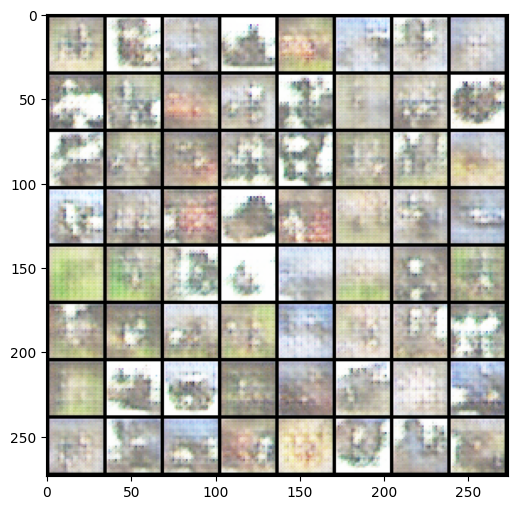

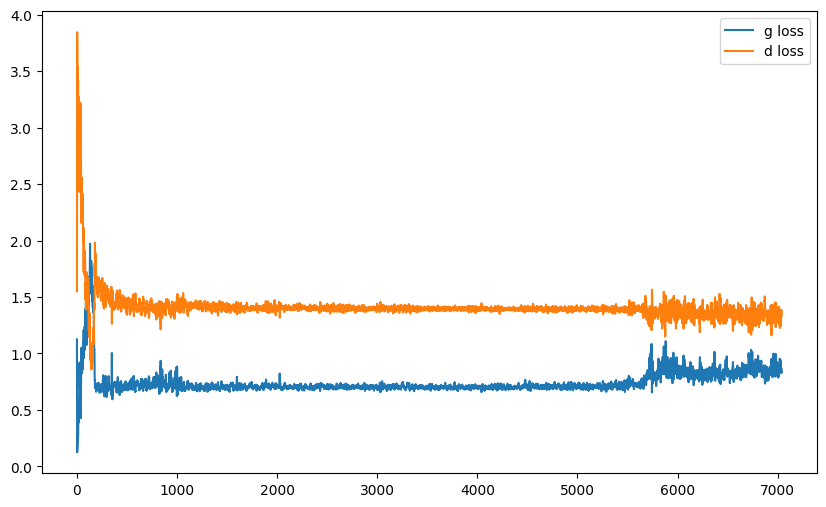

it: 7238; g_loss: 0.9072355031967163; d_loss: 1.2910611629486084; avg_real_score: 0.5165573954582214; avg_fake_score: 0.4095303416252136: : 199it [00:11, 18.54it/s] 

generated images


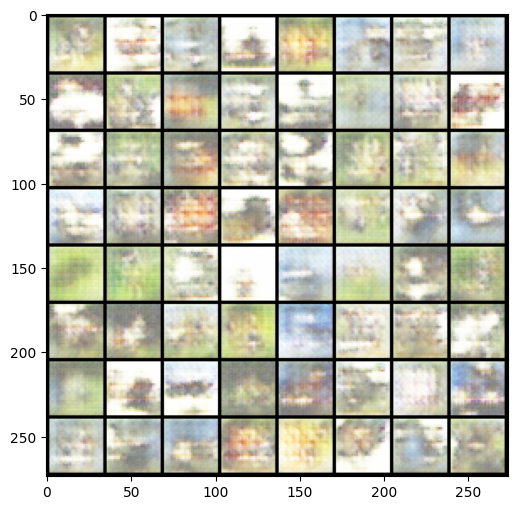

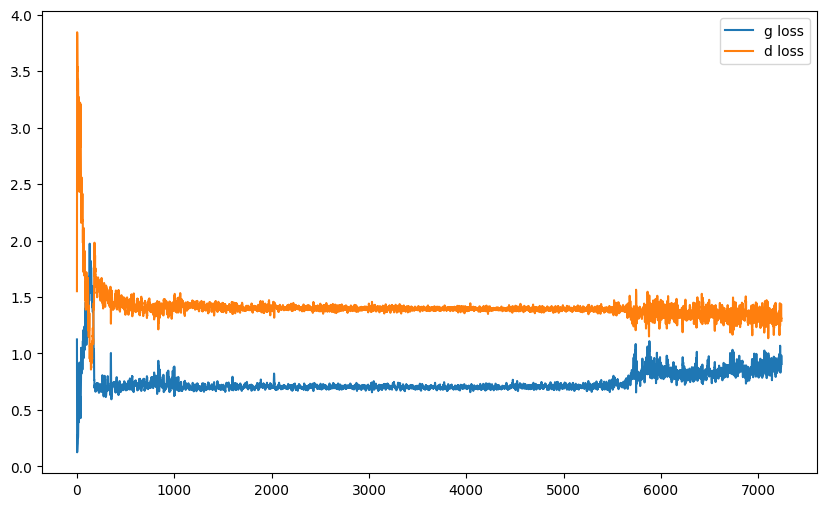

it: 7428; g_loss: 0.867992103099823; d_loss: 1.3356457948684692; avg_real_score: 0.5306104421615601; avg_fake_score: 0.4282694458961487: : 391it [00:22, 17.18it/s]
it: 7429; g_loss: 0.8829853534698486; d_loss: 1.3028563261032104; avg_real_score: 0.5384384989738464; avg_fake_score: 0.4204854965209961: : 0it [00:00, ?it/s]

generated images


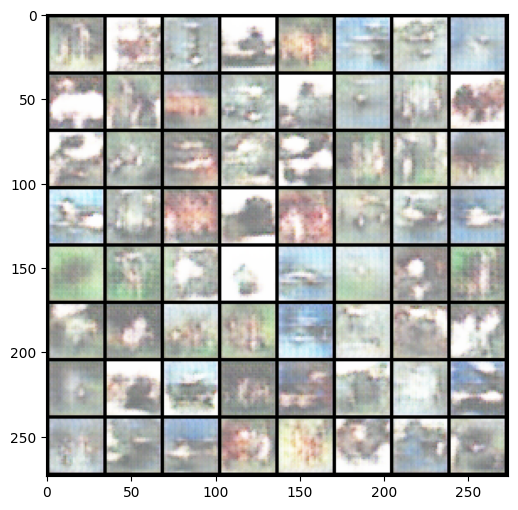

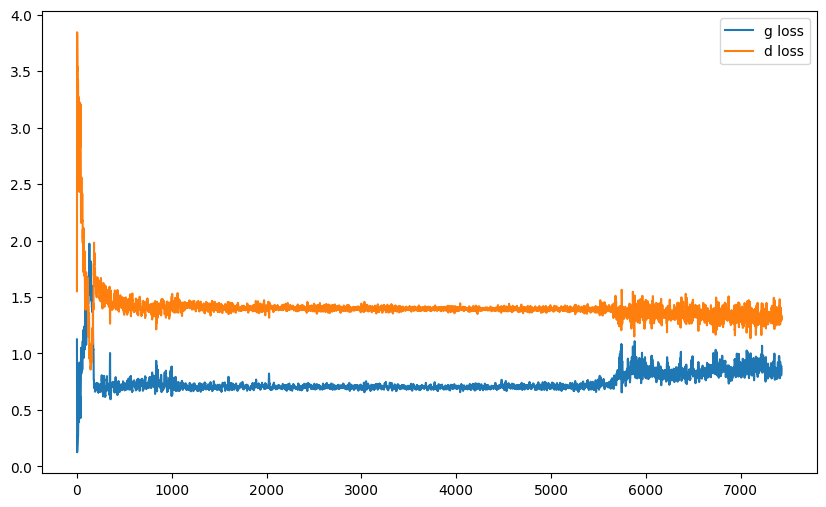

it: 7629; g_loss: 0.826611340045929; d_loss: 1.3326916694641113; avg_real_score: 0.5365879535675049; avg_fake_score: 0.44530755281448364: : 199it [00:12, 18.58it/s] 

generated images


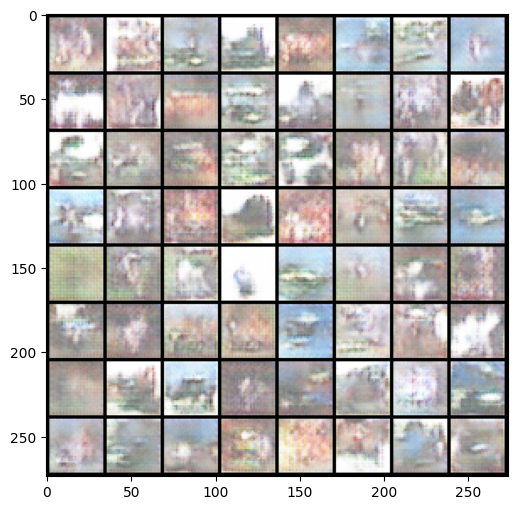

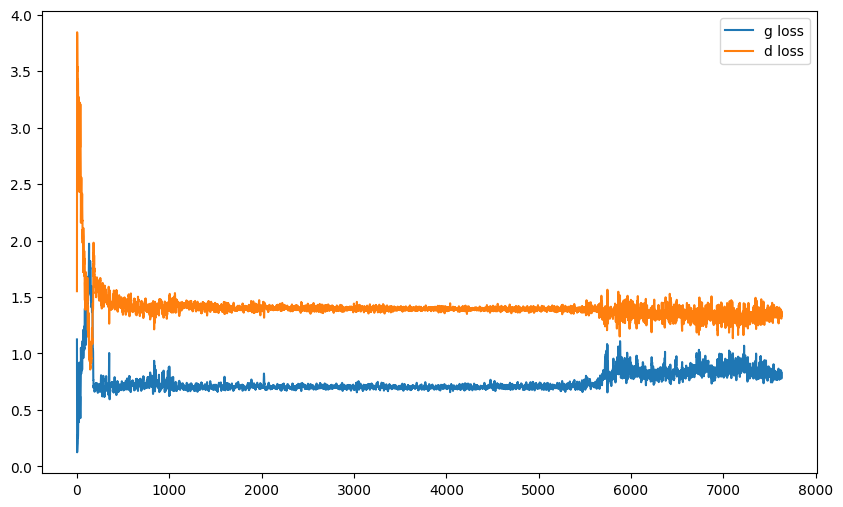

it: 7819; g_loss: 0.8439540863037109; d_loss: 1.3202180862426758; avg_real_score: 0.5011897087097168; avg_fake_score: 0.43477582931518555: : 391it [00:23, 16.97it/s]
it: 7820; g_loss: 0.7556244134902954; d_loss: 1.4100415706634521; avg_real_score: 0.48573121428489685; avg_fake_score: 0.4744102954864502: : 0it [00:00, ?it/s]

generated images


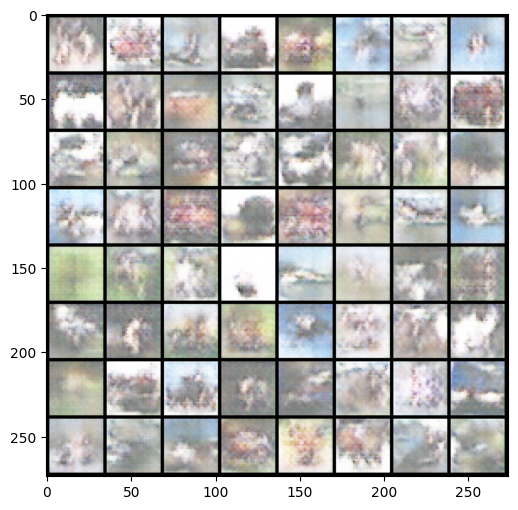

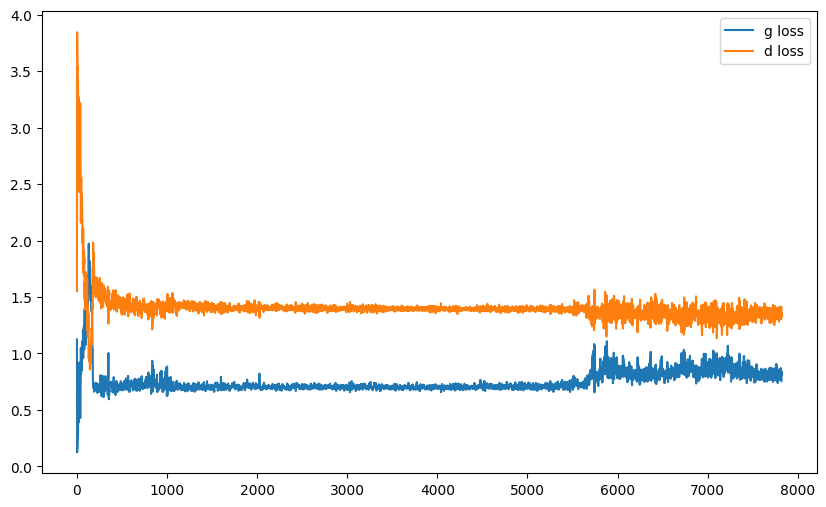

it: 8020; g_loss: 0.7761380076408386; d_loss: 1.357209324836731; avg_real_score: 0.5042028427124023; avg_fake_score: 0.46440252661705017: : 199it [00:11, 16.78it/s] 

generated images


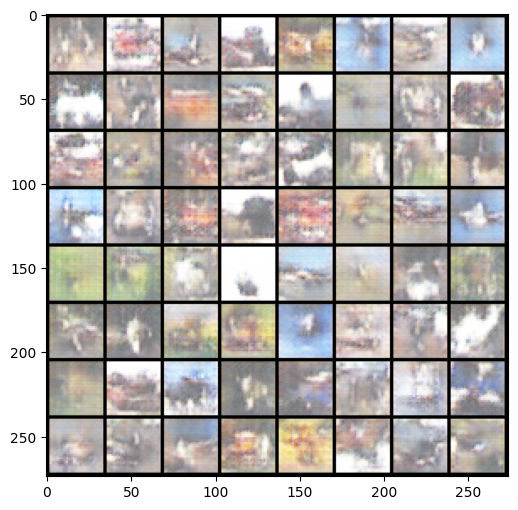

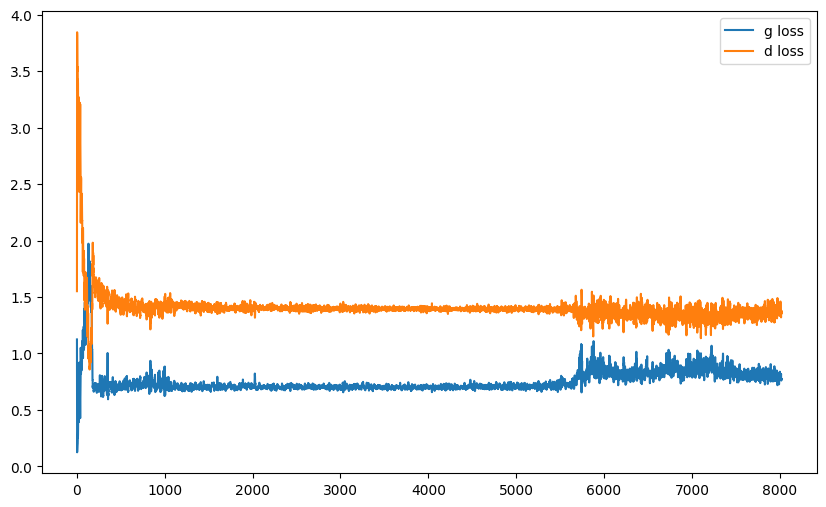

it: 8210; g_loss: 0.755272388458252; d_loss: 1.36897873878479; avg_real_score: 0.5118715167045593; avg_fake_score: 0.47447600960731506: : 391it [00:22, 17.33it/s]
it: 8211; g_loss: 0.7620314359664917; d_loss: 1.3646440505981445; avg_real_score: 0.5384531021118164; avg_fake_score: 0.470516175031662: : 0it [00:00, ?it/s]

generated images


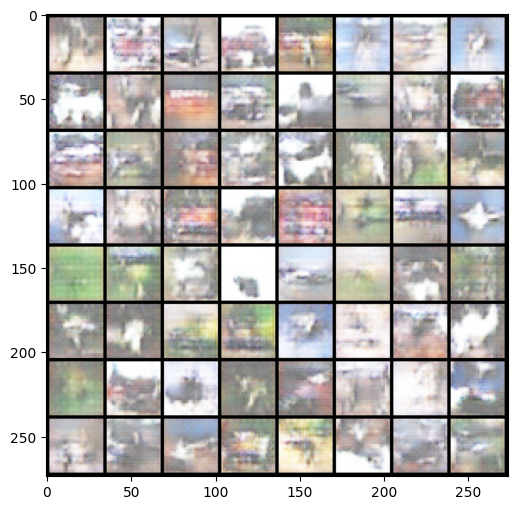

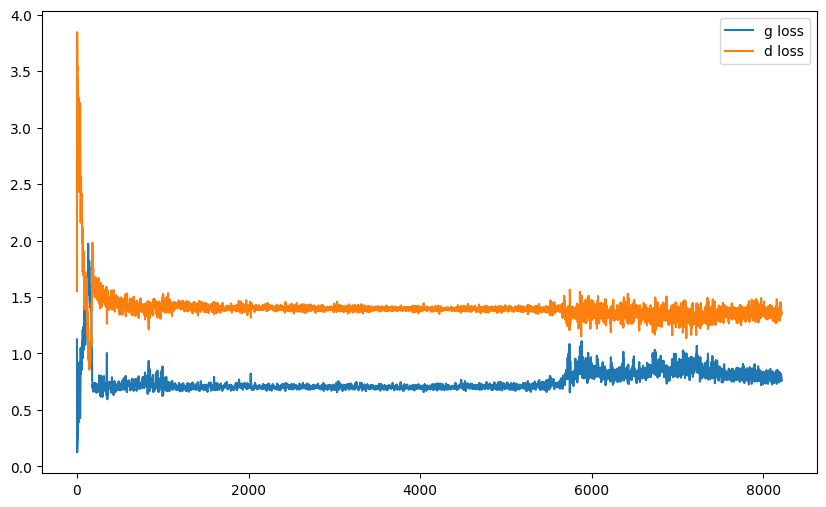

it: 8411; g_loss: 0.7857106328010559; d_loss: 1.336086630821228; avg_real_score: 0.5130108594894409; avg_fake_score: 0.4605964720249176: : 199it [00:11, 18.70it/s] 

generated images


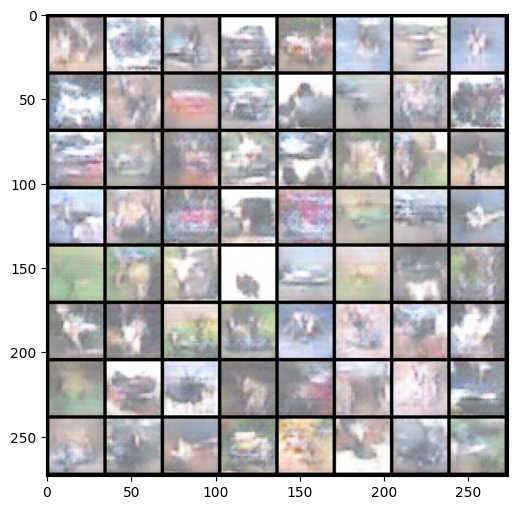

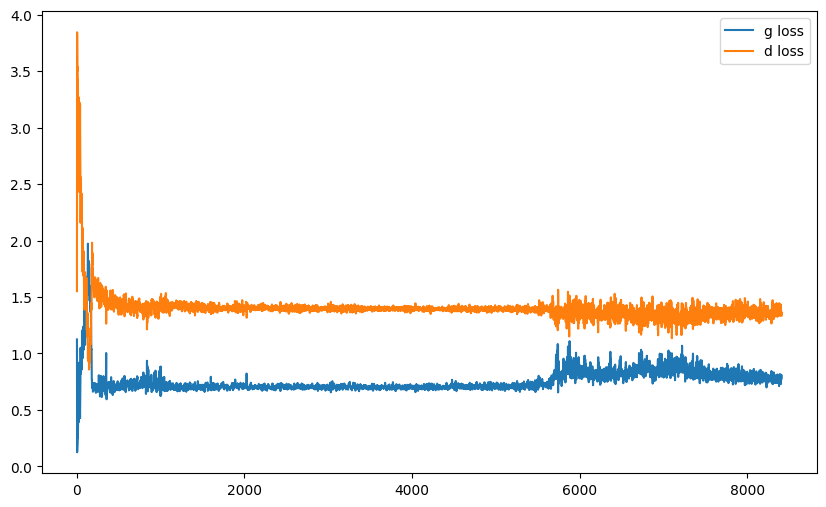

it: 8601; g_loss: 0.7765025496482849; d_loss: 1.363823413848877; avg_real_score: 0.518215000629425; avg_fake_score: 0.463179349899292: : 391it [00:23, 16.71it/s]
it: 8602; g_loss: 0.7746968269348145; d_loss: 1.370267629623413; avg_real_score: 0.4968714714050293; avg_fake_score: 0.4642999470233917: : 0it [00:00, ?it/s]

generated images


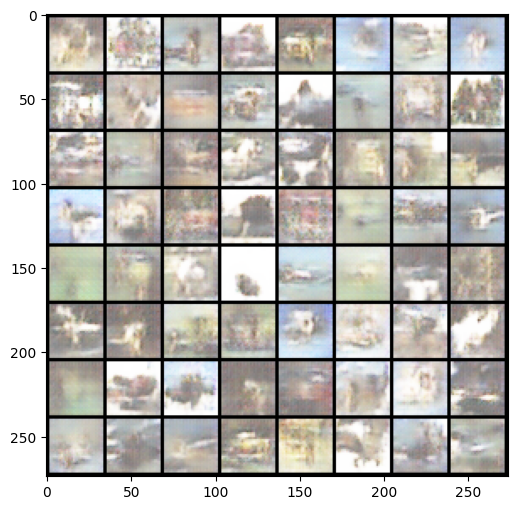

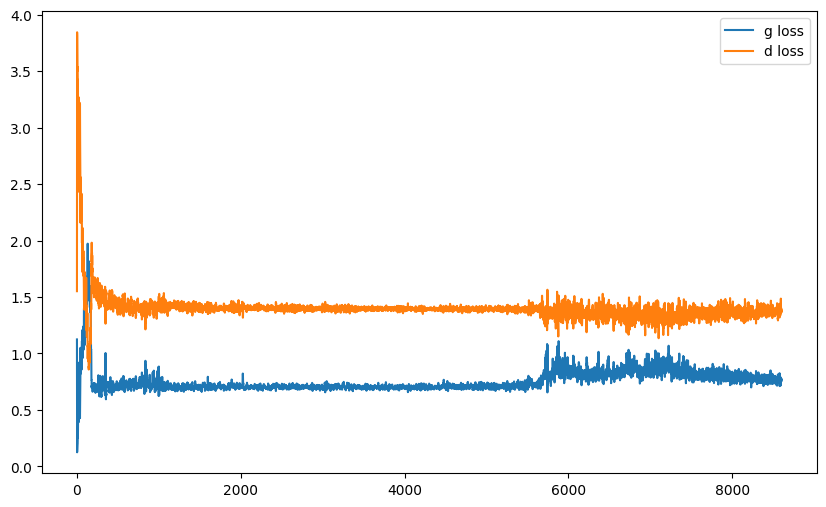

it: 8802; g_loss: 0.7861541509628296; d_loss: 1.3242440223693848; avg_real_score: 0.5112605690956116; avg_fake_score: 0.45873045921325684: : 199it [00:11, 18.97it/s]

generated images


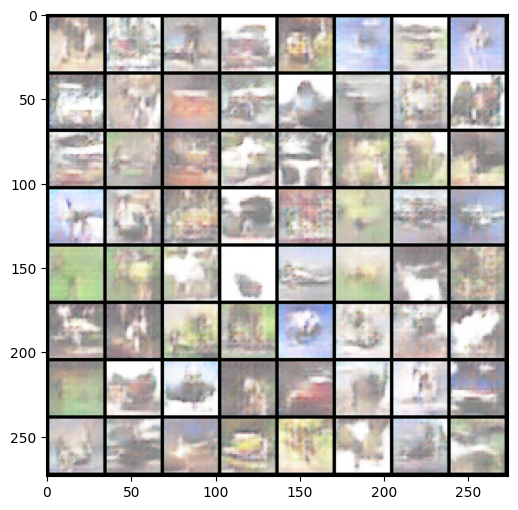

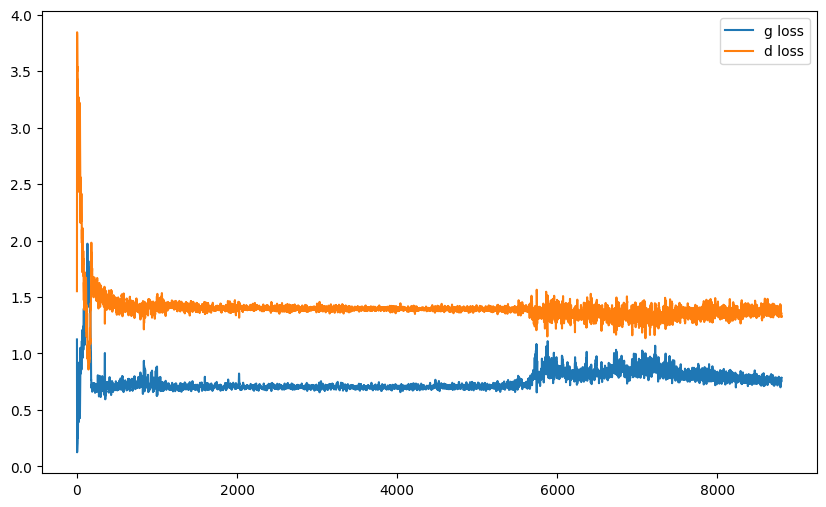

it: 8992; g_loss: 0.7881290316581726; d_loss: 1.3523727655410767; avg_real_score: 0.4878273904323578; avg_fake_score: 0.45766401290893555: : 391it [00:23, 16.85it/s]
it: 8993; g_loss: 0.766883373260498; d_loss: 1.3236024379730225; avg_real_score: 0.5213531255722046; avg_fake_score: 0.46787363290786743: : 0it [00:00, ?it/s]

generated images


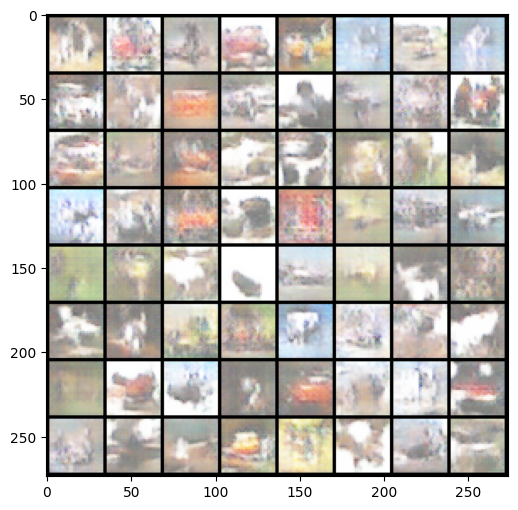

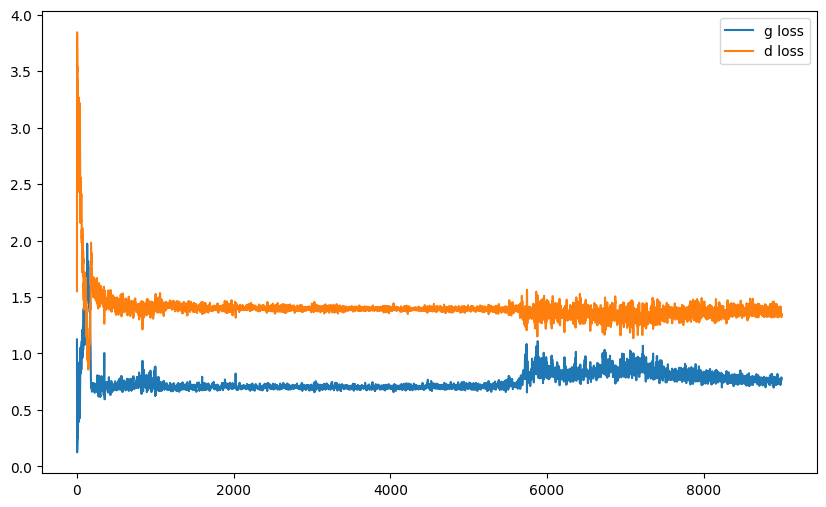

it: 9193; g_loss: 0.7387272715568542; d_loss: 1.3717552423477173; avg_real_score: 0.503170371055603; avg_fake_score: 0.4814067780971527: : 199it [00:11, 15.67it/s]

generated images


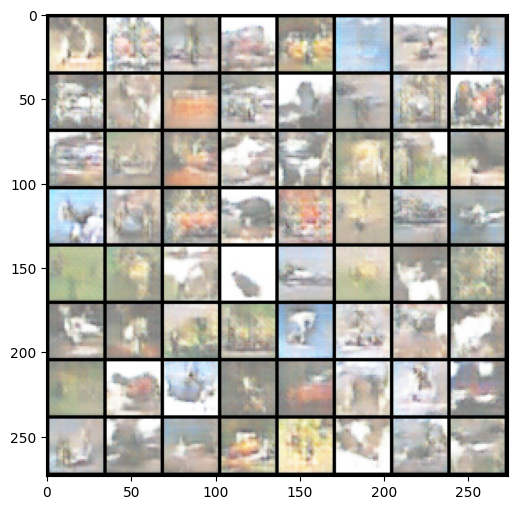

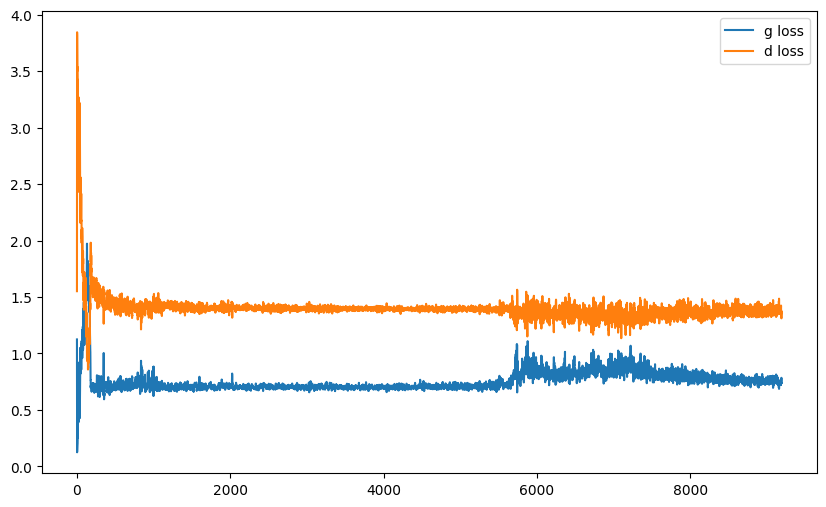

it: 9383; g_loss: 0.7400164604187012; d_loss: 1.3725457191467285; avg_real_score: 0.5162298083305359; avg_fake_score: 0.4798884391784668: : 391it [00:22, 17.27it/s]
it: 9384; g_loss: 0.74250328540802; d_loss: 1.4231888055801392; avg_real_score: 0.5011700391769409; avg_fake_score: 0.4785968065261841: : 0it [00:00, ?it/s]

generated images


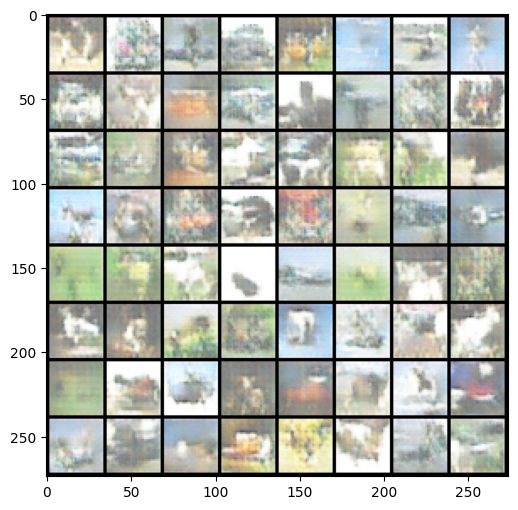

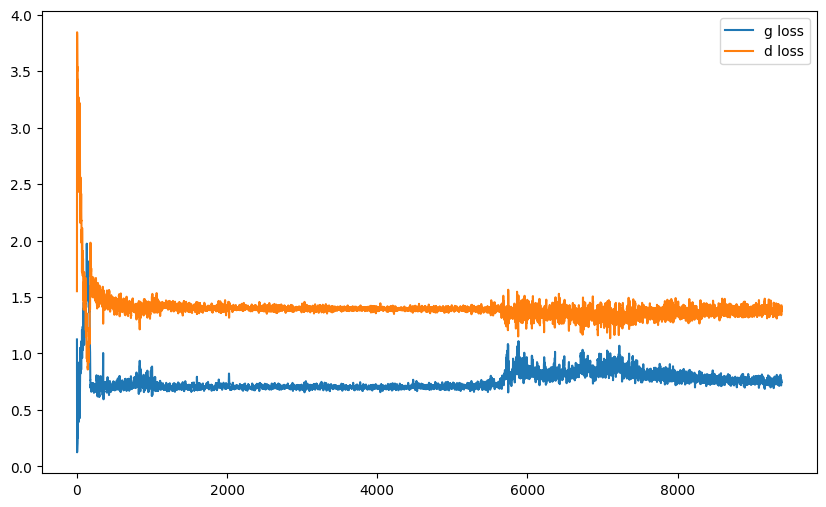

it: 9584; g_loss: 0.740802526473999; d_loss: 1.3829774856567383; avg_real_score: 0.5009075403213501; avg_fake_score: 0.47991427779197693: : 199it [00:11, 18.93it/s] 

generated images


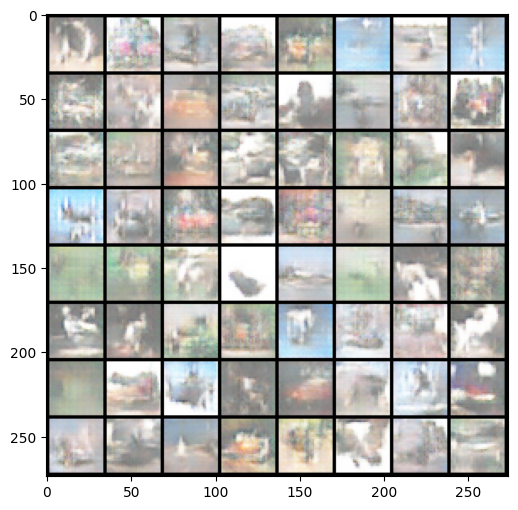

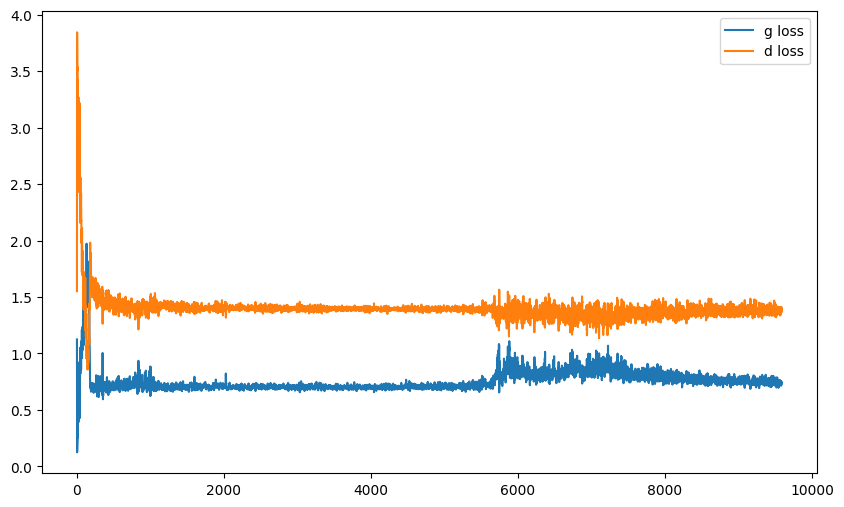

it: 9774; g_loss: 0.7186393737792969; d_loss: 1.3945311307907104; avg_real_score: 0.5135893225669861; avg_fake_score: 0.4900047779083252: : 391it [00:22, 17.05it/s]


In [39]:
nb_epochs = 25

g_losses = []
d_losses = []


j = 0


z_test = sample_z(64, nz) # we generate the noise only once for testing

for epoch in range(nb_epochs):

    # train
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, _ = batch # we don't care about the label for unconditional generation
        im = im.to(device)

        cur_batch_size = im.shape[0]


        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################

        # 1. sample a z vector
        z = sample_z(batch_size=cur_batch_size, nz=nz)

        # 2. Generate a fake image
        fake_im = netG(z)

        # 3. Classify real image with D
        yhat_real = netD(im)

        # 4. Classify fake image with D
        yhat_fake = netD(fake_im.detach())



        ###
        ### Discriminator
        ###

        d_loss_real = criterion(yhat_real, get_labels_one(cur_batch_size))
        d_loss_fake = criterion(yhat_fake, get_labels_zero(cur_batch_size))
        d_loss = d_loss_real + d_loss_fake
        d_opt.zero_grad()
        # d_loss.backward(retain_graph=True) # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_loss.backward()
        d_opt.step()


        ###
        ### Generator
        ###

        yhat_fake = netD(fake_im)      # Using the most updated Discriminator
        g_loss = criterion(yhat_fake, get_labels_one(cur_batch_size))   #      YOUR CODE HERE
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()


        # Save Metrics

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        avg_real_score = yhat_real.mean().item()
        avg_fake_score = yhat_fake.mean().item()



        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:

            fake_im = netG(z_test)

            un_norm = renorm(fake_im) # for visualization

            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)

            print("generated images")
            plt.imshow(pil_grid)
            plt.show()

            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')

            plt.legend()
            plt.show()

        j += 1

nz = 10000

it: 0; g_loss: 0.9962998628616333; d_loss: 1.5518698692321777; avg_real_score: 0.42722195386886597; avg_fake_score: 0.38323599100112915: : 0it [00:00, ?it/s]

generated images


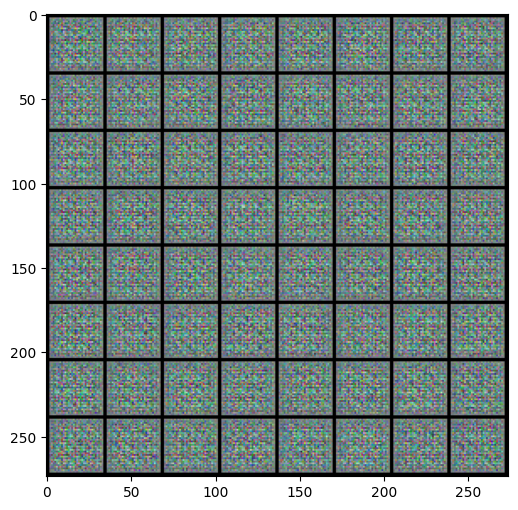

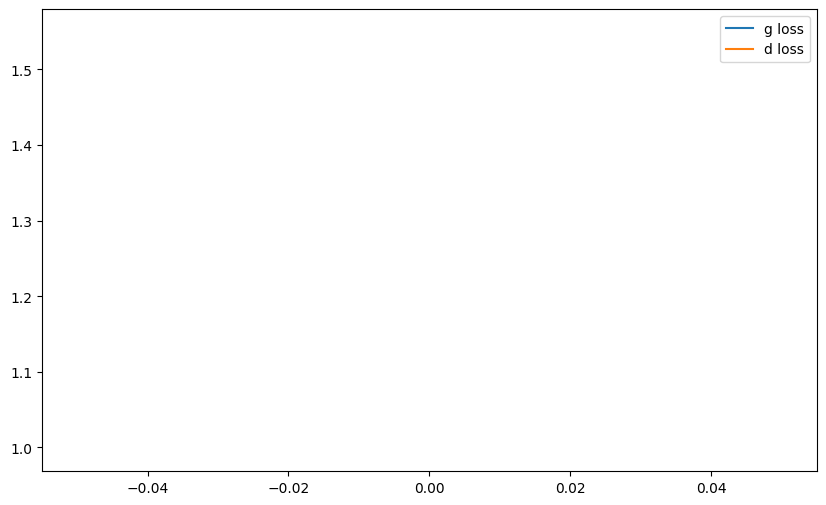

it: 200; g_loss: 2.127078056335449; d_loss: 0.7617501616477966; avg_real_score: 0.7407901287078857; avg_fake_score: 0.12431126832962036: : 200it [02:49,  1.17it/s]

generated images


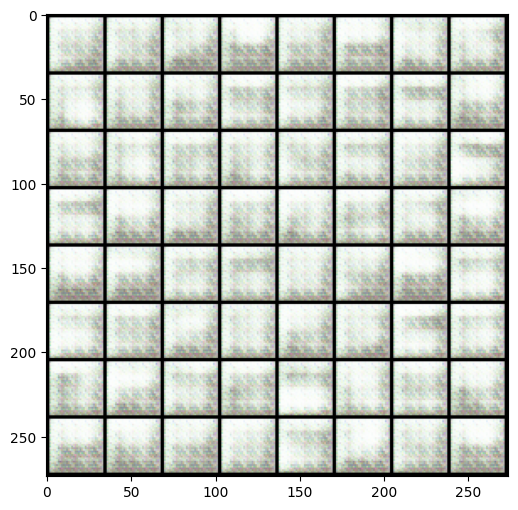

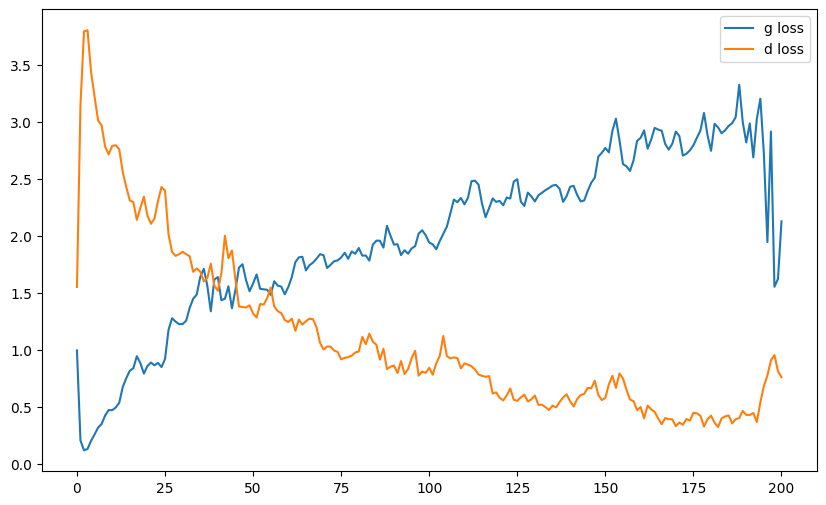

it: 370; g_loss: 1.0561859607696533; d_loss: 1.318981409072876; avg_real_score: 0.5191323757171631; avg_fake_score: 0.3553469777107239: : 371it [05:18,  1.17it/s]


KeyboardInterrupt: 

In [36]:
nb_epochs = 5

g_losses = []
d_losses = []


j = 0


z_test = sample_z(64, nz) # we generate the noise only once for testing

for epoch in range(nb_epochs):

    # train
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, _ = batch # we don't care about the label for unconditional generation
        im = im.to(device)

        cur_batch_size = im.shape[0]


        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################

        # 1. sample a z vector
        z = sample_z(batch_size=cur_batch_size, nz=nz)

        # 2. Generate a fake image
        fake_im = netG(z)

        # 3. Classify real image with D
        yhat_real = netD(im)

        # 4. Classify fake image with D
        yhat_fake = netD(fake_im.detach())



        ###
        ### Discriminator
        ###

        d_loss_real = criterion(yhat_real, get_labels_one(cur_batch_size))
        d_loss_fake = criterion(yhat_fake, get_labels_zero(cur_batch_size))
        d_loss = d_loss_real + d_loss_fake
        d_opt.zero_grad()
        # d_loss.backward(retain_graph=True) # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_loss.backward()
        d_opt.step()


        ###
        ### Generator
        ###

        yhat_fake = netD(fake_im)      # Using the most updated Discriminator
        g_loss = criterion(yhat_fake, get_labels_one(cur_batch_size))   #      YOUR CODE HERE
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()


        # Save Metrics

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        avg_real_score = yhat_real.mean().item()
        avg_fake_score = yhat_fake.mean().item()



        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:

            fake_im = netG(z_test)

            un_norm = renorm(fake_im) # for visualization

            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)

            print("generated images")
            plt.imshow(pil_grid)
            plt.show()

            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')

            plt.legend()
            plt.show()

        j += 1

# 4. Conditional GANs

A simple way to improve training performance and obtain control of the generation is to provide extra information into the Generator and the Discriminator, known as **Conditional GANs**. In this case, we will provide the class label (digit number of MNIST) into both the generator and the discriminator. This will help both of the networks.

## 4.1 Conditional Generator and Discriminator

Complete the ConditionalDiscriminator and ConditionalGenerator classes using your GAN building blocks (`get_upsampling_block` and `get_downsampling_block` functions).


### 4.1.1 Generator

In [ ]:
# GENERATOR

'''
The conditional generator needs the label information as well as the latent vector. We will combine the latent vector and the class information in the following way:

- The class information for the generator will be represented as a one-hot vector sized `[batch_size, 10]` (since there are 10 classes in MNIST)
- The latent vector for the generator will still be sized `[batch_size, nz]`

1. Transform both of these modalities into 'images' (by adding dimensions)
2. Like before, apply the first upscaling block to both of these 'images'. We will now have 2 separate blocks sized

'''

class ConditionalGenerator(nn.Module):
    def __init__(self, nz, nc, ngf, nchannels=1):
        super().__init__()

        self.upscaling_z = get_upscaling_block(nz, ngf*8, 4, 1, 0)
        self.upscaling_c = get_upscaling_block(nc, ngf*8, 4, 1, 0)

        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        self.rest_model = nn.Sequential(
            get_upscaling_block(channels_in=ngf*16, channels_out=ngf*8, kernel=4, stride=2, padding=1),
            get_upscaling_block(channels_in=ngf*8, channels_out=ngf*4, kernel=4, stride=2, padding=1),
            get_upscaling_block(channels_in=ngf*4, channels_out=nchannels, kernel=4, stride=2, padding=1, last_layer=True),
        )

        ###################

    def forward(self, x, y):
        x = x.unsqueeze(2).unsqueeze(2)
        y = y.unsqueeze(2).unsqueeze(2)

        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################
        x = self.upscaling_z(x)
        y = self.upscaling_c(y)
        x = torch.cat((x, y), dim=1)

        # print("x shape: ", x.shape)

        return self.rest_model(x)

### 4.1.2 Discriminator

In [ ]:
# Discriminator

'''
The conditional discriminator needs the label information as well as the latent vector. We will combine the latent vector and the class information in the following way:

- The class information for the discriminator will be represented as a one-hot vector sized `[batch_size, 10]` (since there are 10 classes in MNIST)
- The latent vector for the generator will still be sized `[batch_size, nz]`

1. Transform both of these modalities into 'images' (by adding dimensions)
2. Like before, apply the first upscaling block to both of these 'images'. We will now have 2 separate blocks sized

'''

class ConditionalDiscriminator(nn.Module):
    def __init__(self, ndf, nc, nchannels=1):
        super().__init__()
        self.downscale_x = get_downscaling_block(nchannels, ndf*2, 4, 2, 1, use_batch_norm=False)
        self.downscale_y = get_downscaling_block(nc, ndf*2, 4, 2, 1, use_batch_norm=False)

        ###################
        #                 #
        # YOUR CODE HERE  #

        self.rest = nn.Sequential(
            get_downscaling_block(channels_in=ndf*4, channels_out=2*ndf, kernel=4, stride=2, padding=1, use_batch_norm=True),
            get_downscaling_block(channels_in=2*ndf, channels_out=ndf*4, kernel=4, stride=2, padding=1, use_batch_norm=True),
            get_downscaling_block(channels_in=ndf*4, channels_out=nchannels, kernel=4, stride=1, padding=0, is_last=True),
        )

        #                 #
        ###################

    def forward(self, x, y):
        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################
        y = y.unsqueeze(-1).unsqueeze(-1)
        y = y.repeat(1, 1, x.shape[2], x.shape[2])

        # print("x shape: ", x.shape)
        # print("y shape: ", y.shape)

        x = self.downscale_x(x)
        y = self.downscale_y(y)
        # print("x shape after downscale: ", x.shape)
        # print("y shape after downscale: ", y.shape)
        x = torch.cat((x, y), dim=1)

        # print("x shape after cat: ", x.shape)

        return self.rest(x).squeeze(1).squeeze(1) # remove spatial dimensions

### 4.1.3 Sanity Checks

torch.Size([128, 1, 32, 32])


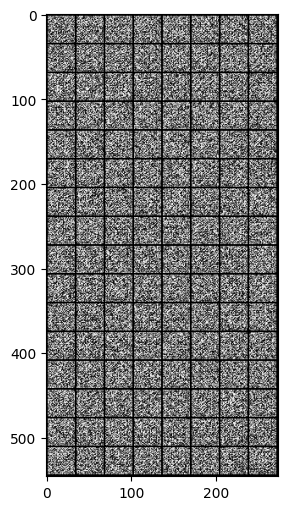

In [ ]:
# CONDITIONAL GENERATOR SANITY CHECKING

z = torch.randn(batch_size, nz)
y = F.one_hot(real_labels).float()

cG = ConditionalGenerator(nz=nz, ngf=16, nc=10)
x_fake = cG(z, y)
print(x_fake.shape)
plt.imshow(transforms.ToPILImage()(make_grid(x_fake, nrow=8)))

In [ ]:
# Conditional Discriminator Sanity Checking

cD = ConditionalDiscriminator(ndf=32, nc=10, nchannels=1)
assert cD(real_batch, F.one_hot(real_labels).float()).shape == (real_batch.shape[0], 1)

y shape:  torch.Size([128, 10, 32, 32])
x shape after downscale:  torch.Size([128, 64, 16, 16])
y shape after downscale:  torch.Size([128, 64, 16, 16])
x shape after cat:  torch.Size([128, 128, 16, 16])


## 4.2 Training

In [ ]:
nz = 100
ndf = 32
ngf = 32
nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

nc= 10

netD = ConditionalDiscriminator(ndf, nc, nchannels=1).to(device)
netG = ConditionalGenerator(nz, nc, ngf).to(device)

netG.apply(weights_init)
netD.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))



it: 0; g_loss: 0.8701733350753784; d_loss: 1.6163502931594849; avg_real_score: 0.3476429581642151; avg_fake_score: 0.4211679697036743: : 0it [00:00, ?it/s]

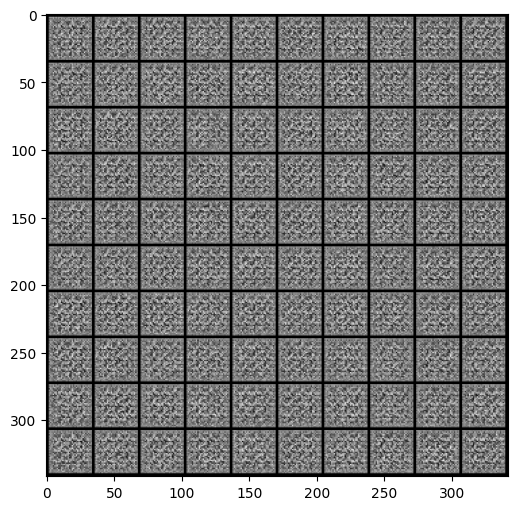

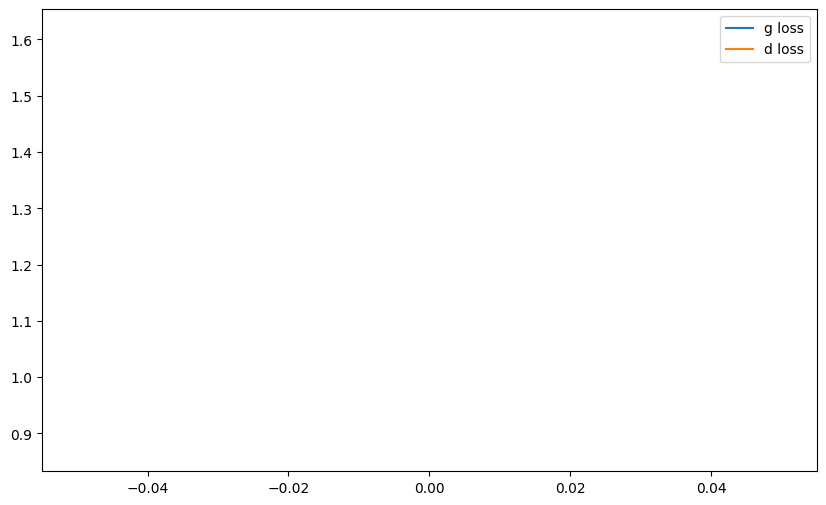

it: 200; g_loss: 1.0651416778564453; d_loss: 1.3150951862335205; avg_real_score: 0.5665296316146851; avg_fake_score: 0.34800878167152405: : 200it [00:16, 13.32it/s]

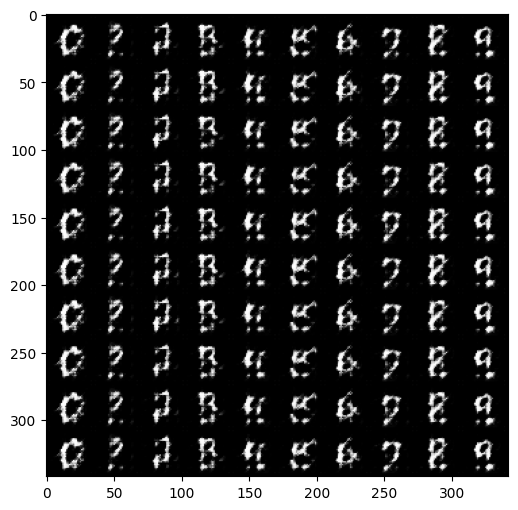

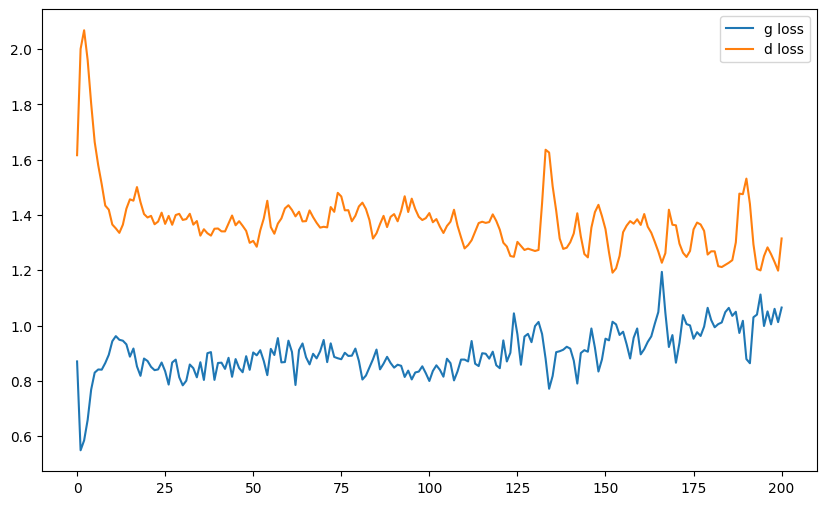

it: 400; g_loss: 1.6099157333374023; d_loss: 1.2358537912368774; avg_real_score: 0.6721271276473999; avg_fake_score: 0.20687326788902283: : 400it [00:30, 14.26it/s]

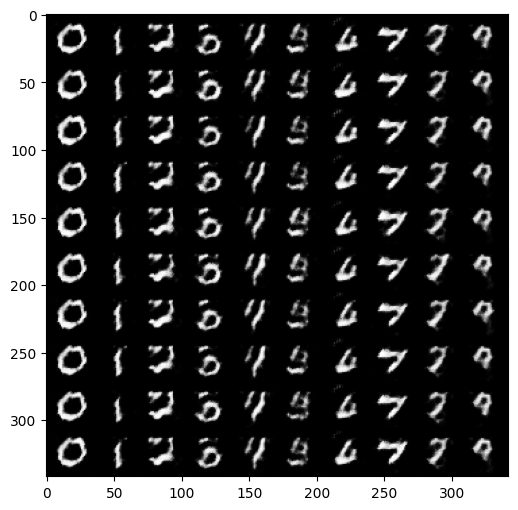

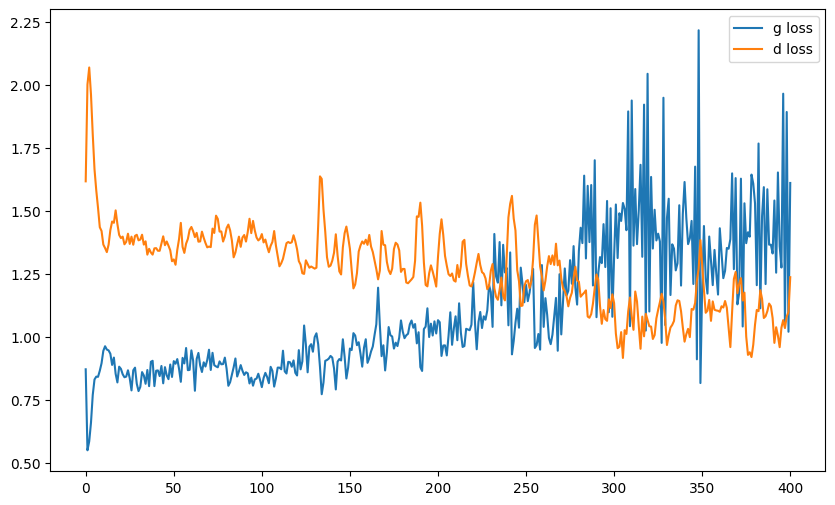

it: 468; g_loss: 2.0367069244384766; d_loss: 1.0330311059951782; avg_real_score: 0.6791178584098816; avg_fake_score: 0.13721761107444763: : 469it [00:36, 12.98it/s]
it: 469; g_loss: 1.4390075206756592; d_loss: 0.9972277283668518; avg_real_score: 0.5722635388374329; avg_fake_score: 0.24463151395320892: : 0it [00:00, ?it/s]

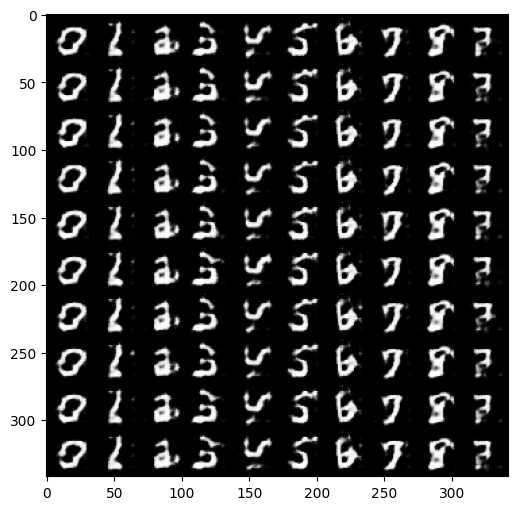

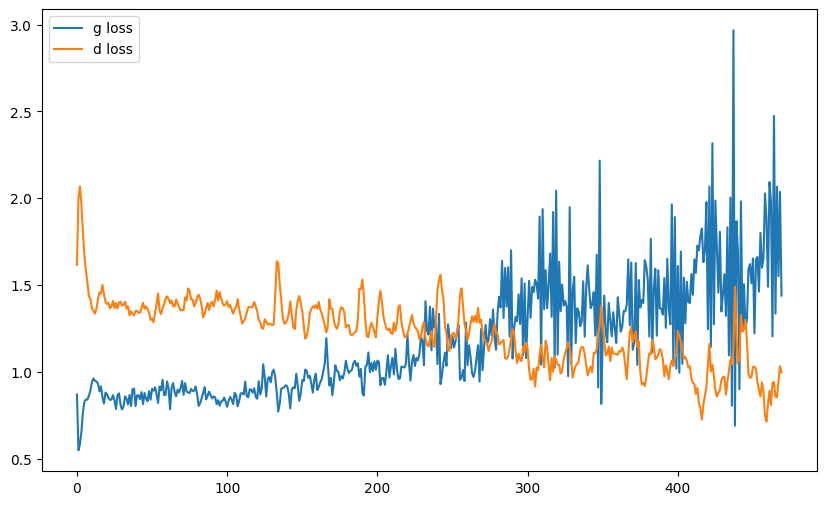

it: 669; g_loss: 2.287773609161377; d_loss: 0.8379898071289062; avg_real_score: 0.803465723991394; avg_fake_score: 0.10531587898731232: : 199it [00:15, 13.88it/s]  

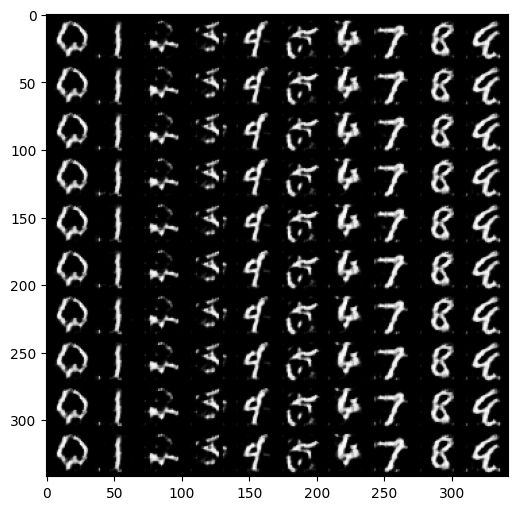

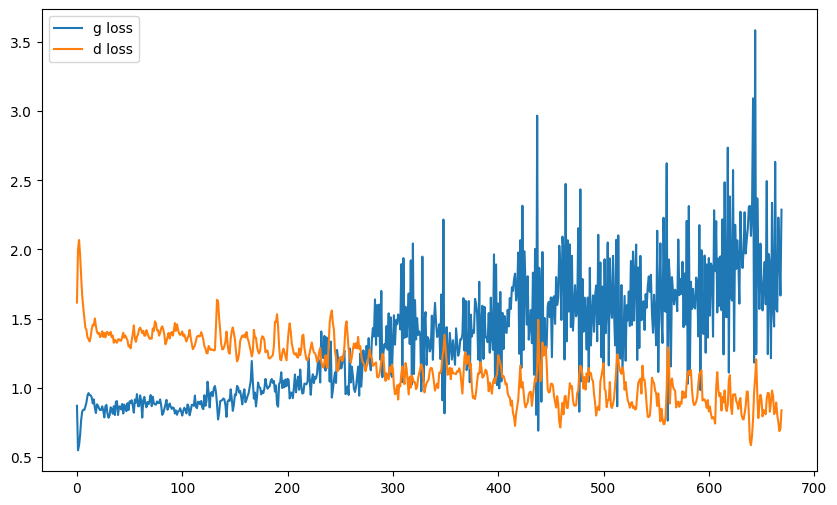

it: 869; g_loss: 2.1862893104553223; d_loss: 0.6656721830368042; avg_real_score: 0.7029315829277039; avg_fake_score: 0.11834795773029327: : 399it [00:30, 12.76it/s]

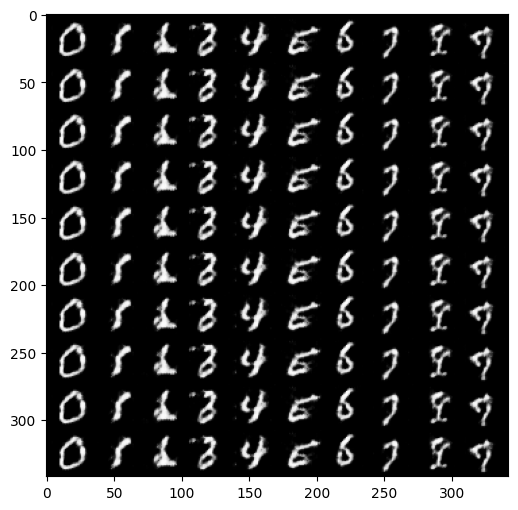

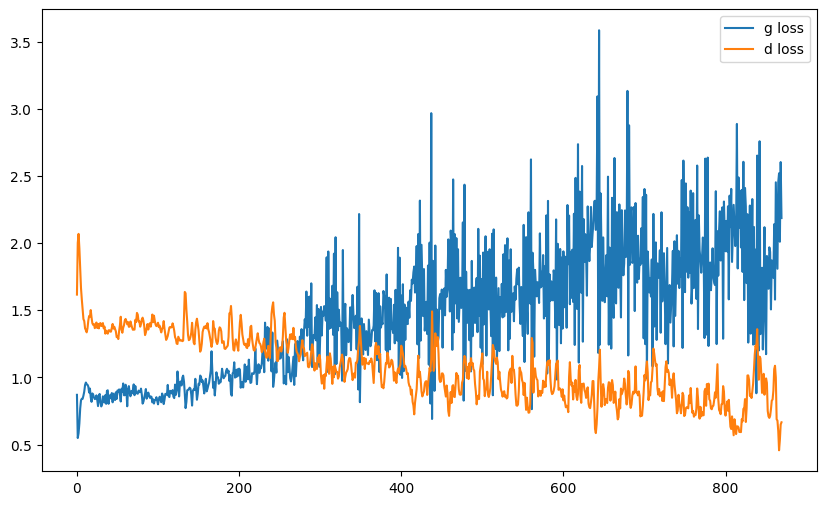

it: 937; g_loss: 2.314478874206543; d_loss: 0.642092764377594; avg_real_score: 0.776875376701355; avg_fake_score: 0.10200099647045135: : 469it [00:36, 12.88it/s]
it: 938; g_loss: 1.9533019065856934; d_loss: 0.6680788397789001; avg_real_score: 0.7088107466697693; avg_fake_score: 0.15060511231422424: : 0it [00:00, ?it/s]

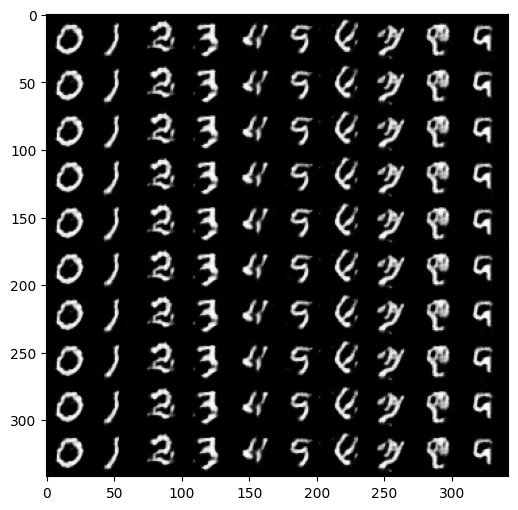

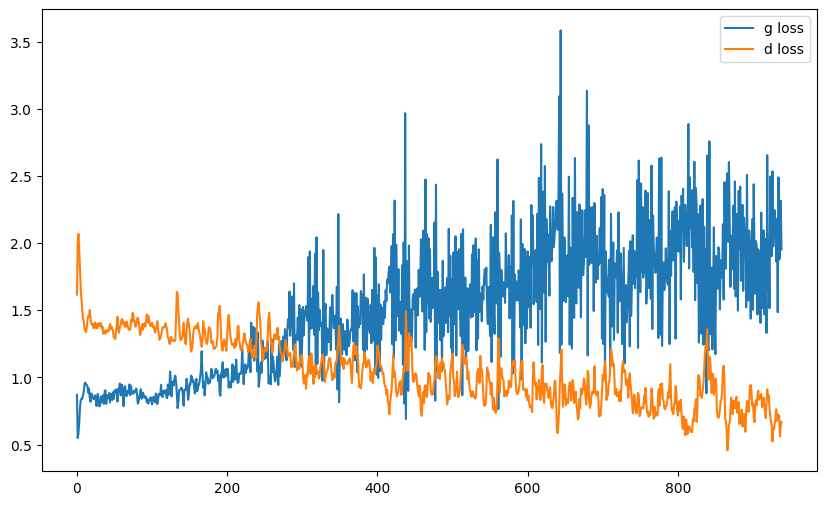

it: 1138; g_loss: 2.29313325881958; d_loss: 0.5989857316017151; avg_real_score: 0.8043790459632874; avg_fake_score: 0.10561089217662811: : 199it [00:16, 13.26it/s] 

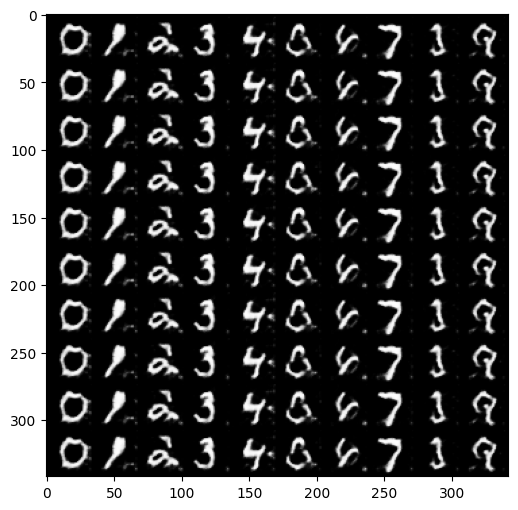

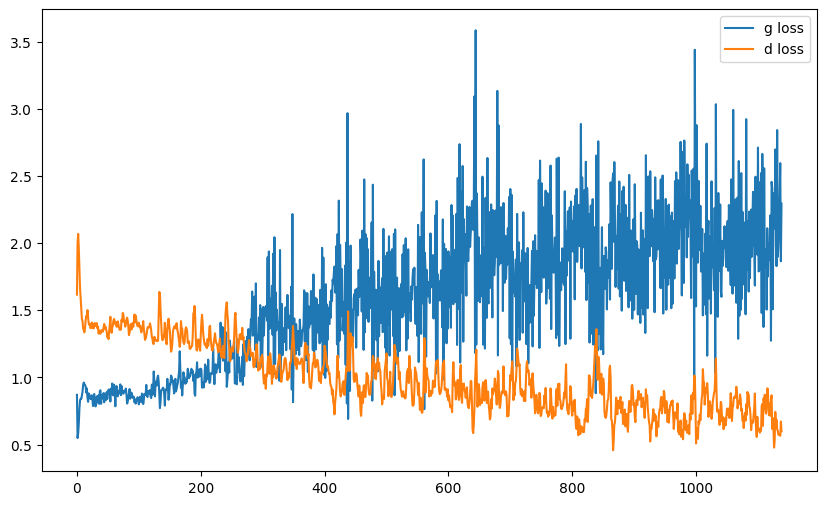

it: 1338; g_loss: 1.8584977388381958; d_loss: 0.7730804681777954; avg_real_score: 0.6173668503761292; avg_fake_score: 0.1757706105709076: : 399it [00:31, 13.35it/s]

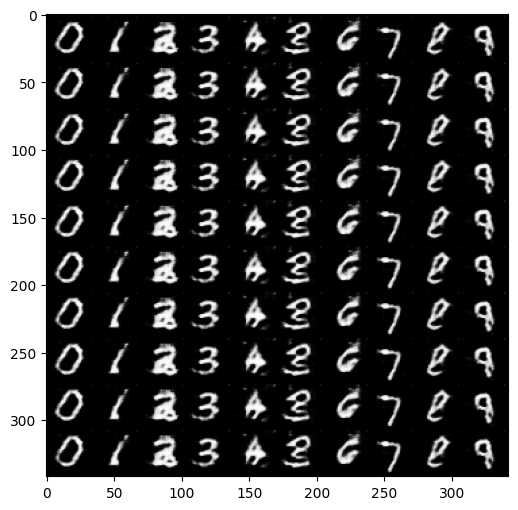

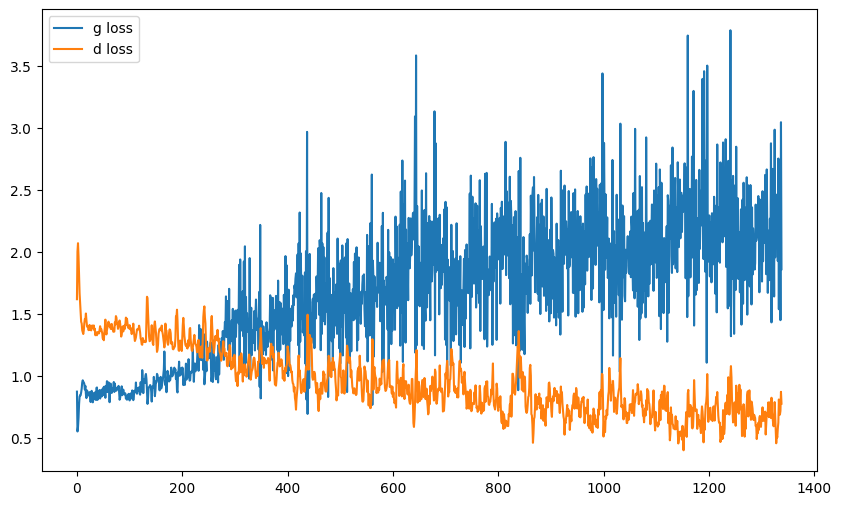

it: 1406; g_loss: 2.1482772827148438; d_loss: 0.43848562240600586; avg_real_score: 0.7650327086448669; avg_fake_score: 0.12371747195720673: : 469it [00:37, 12.52it/s]
it: 1407; g_loss: 2.162398338317871; d_loss: 0.5107786059379578; avg_real_score: 0.8136105537414551; avg_fake_score: 0.138251394033432: : 0it [00:00, ?it/s]

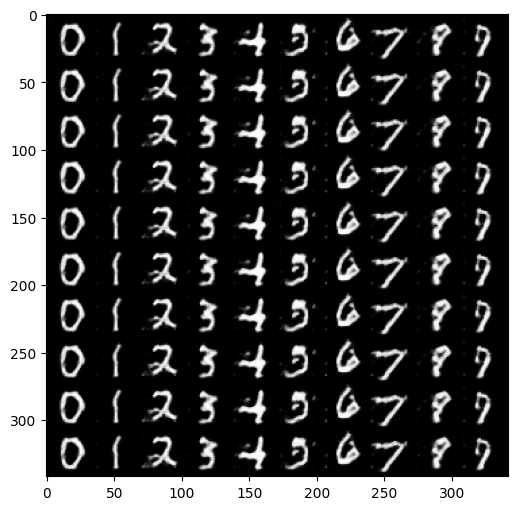

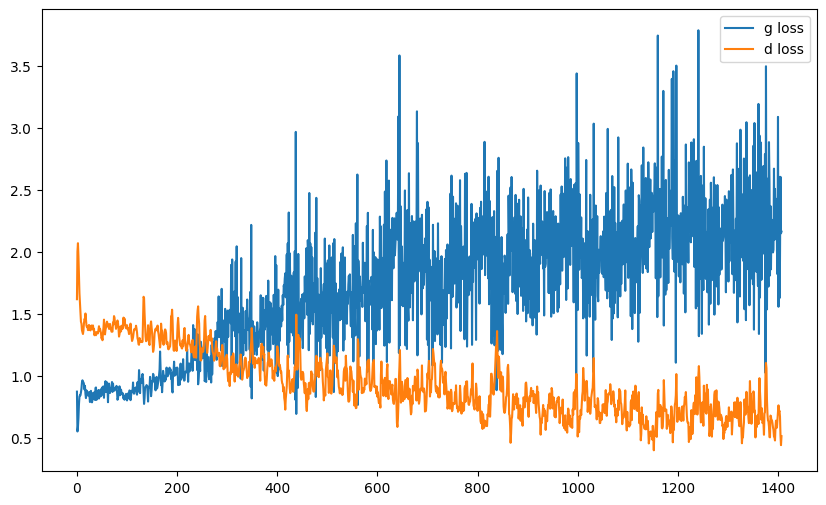

it: 1607; g_loss: 2.892009973526001; d_loss: 0.6459664106369019; avg_real_score: 0.848357081413269; avg_fake_score: 0.059681471437215805: : 199it [00:16, 12.93it/s]

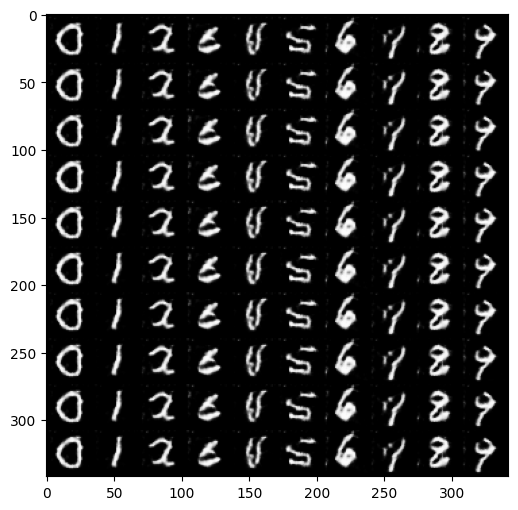

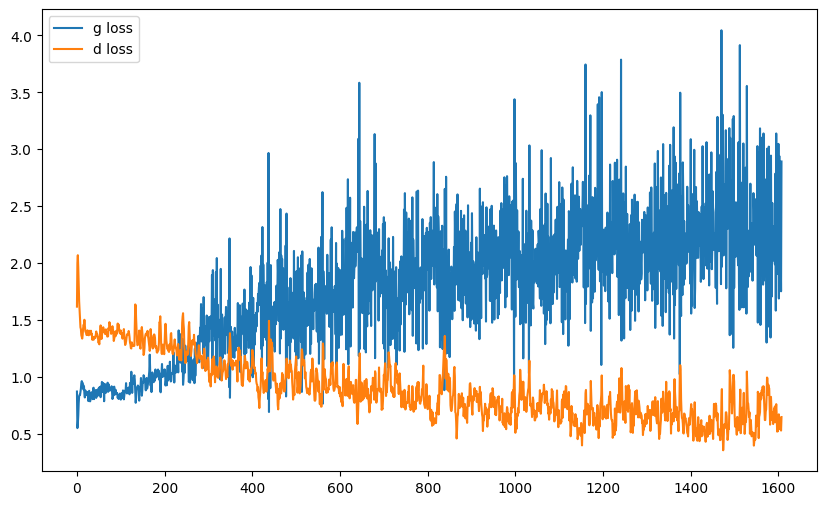

it: 1807; g_loss: 2.446545124053955; d_loss: 0.4813655912876129; avg_real_score: 0.7736184597015381; avg_fake_score: 0.10916654765605927: : 399it [00:32, 13.10it/s] 

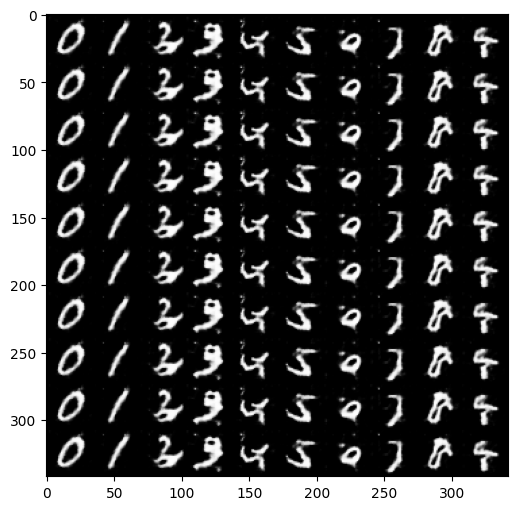

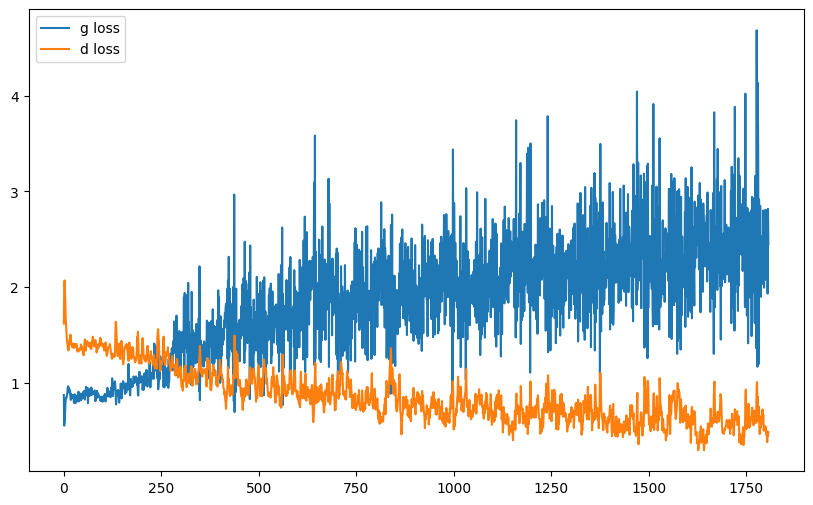

it: 1875; g_loss: 2.9748215675354004; d_loss: 0.5264602899551392; avg_real_score: 0.8857927322387695; avg_fake_score: 0.0572352334856987: : 469it [00:38, 12.24it/s]
it: 1876; g_loss: 2.1767635345458984; d_loss: 0.6463571190834045; avg_real_score: 0.6924536228179932; avg_fake_score: 0.12253418564796448: : 0it [00:00, ?it/s]

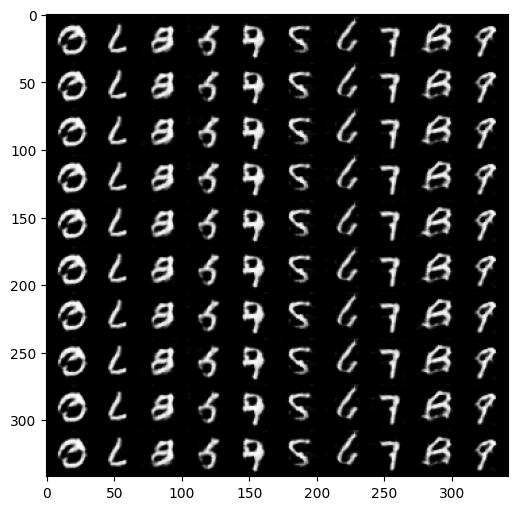

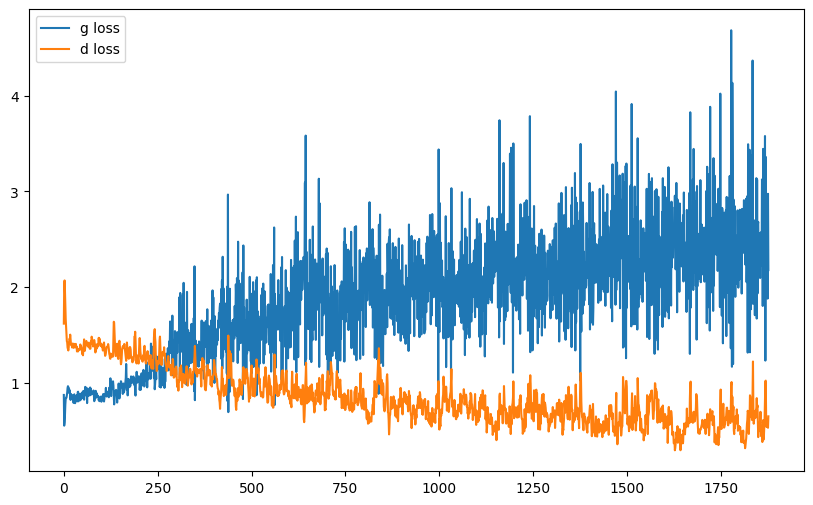

it: 2076; g_loss: 2.6145806312561035; d_loss: 0.38805580139160156; avg_real_score: 0.8358548879623413; avg_fake_score: 0.08468803763389587: : 199it [00:16, 11.67it/s]

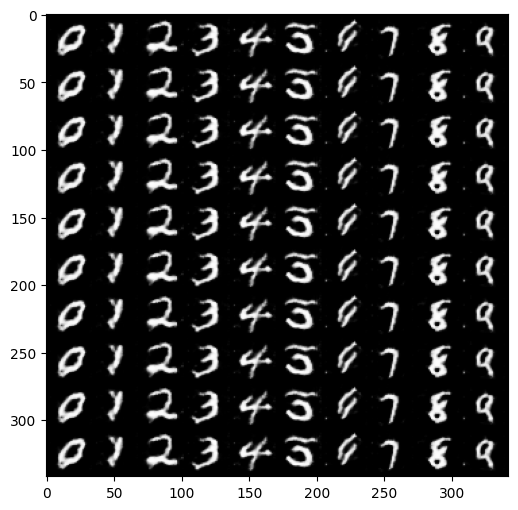

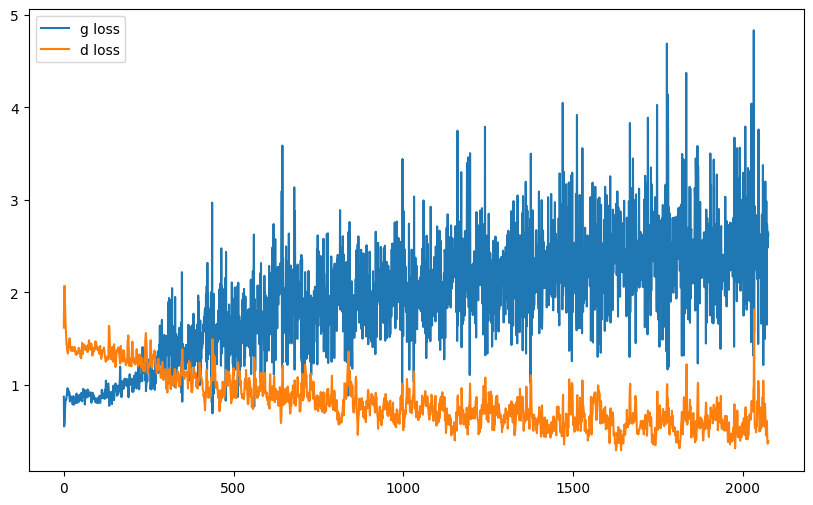

it: 2276; g_loss: 3.498317241668701; d_loss: 0.4438551664352417; avg_real_score: 0.9155368804931641; avg_fake_score: 0.03806744143366814: : 399it [00:33, 10.48it/s]

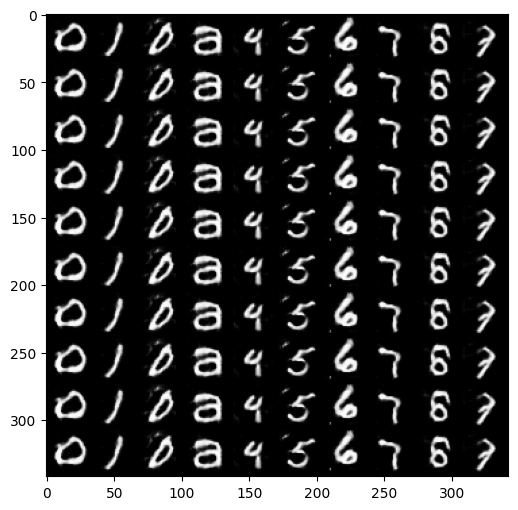

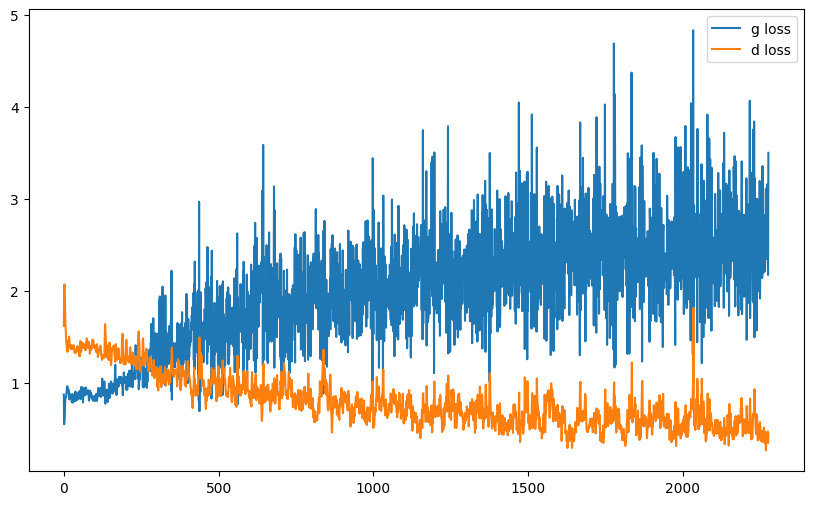

it: 2344; g_loss: 2.727046489715576; d_loss: 0.5348650217056274; avg_real_score: 0.8240125179290771; avg_fake_score: 0.07674799859523773: : 469it [00:38, 12.07it/s]


In [ ]:
nb_epochs = 5

g_losses = []
d_losses = []

j = 0

z_test = sample_z(100, nz)  # we generate the noise only once for testing


for epoch in range(nb_epochs):

    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, labels = batch
        im = im.to(device)


        y = F.one_hot(labels).float().to(device)

        cur_batch_size = im.shape[0]


        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################

        # 1. sample a z vector
        z = sample_z(batch_size=cur_batch_size, nz=nz)

        # 2. Generate a fake image
        fake_im = netG(z, y)

        # 3. Classify real image with D
        yhat_real = netD(im, y)

        # 4. Classify fake image with D
        yhat_fake = netD(fake_im.detach(), y)


        ###
        ### Discriminator
        ###

        d_loss_real = criterion(yhat_real, get_labels_one(cur_batch_size))
        d_loss_fake = criterion(yhat_fake, get_labels_zero(cur_batch_size))
        d_loss = d_loss_real + d_loss_fake    # YOUR CODE HERE
        d_opt.zero_grad()
        d_loss.backward()
        d_opt.step()


        ###
        ### Generator
        ###


        yhat_fake = netD(fake_im, y)      # Using the most updated Discriminator
        g_loss = criterion(yhat_fake, get_labels_one(cur_batch_size)) # YOUR CODE HERE
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()


        # Save Metrics

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        avg_real_score = yhat_real.mean().item()
        avg_fake_score = yhat_fake.mean().item()

        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")

        if i % display_freq == 0:
            labels = torch.arange(0, 10).expand(size=(10, 10)).flatten().to(device)
            y = F.one_hot(labels).float().to(device)
            fake_im = netG(z_test, y)

            un_norm = renorm(fake_im) # for visualization

            grid = torchvision.utils.make_grid(un_norm, nrow=10)
            pil_grid = to_pil(grid)

            plt.imshow(pil_grid)
            plt.show()


            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')

            plt.legend()
            plt.show()

        j += 1


nz = 1000

In [ ]:
nz = 1000
ndf = 32
ngf = 32
nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

nc= 10

netD = ConditionalDiscriminator(ndf, nc, nchannels=1).to(device)
netG = ConditionalGenerator(nz, nc, ngf).to(device)

netG.apply(weights_init)
netD.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))



it: 0; g_loss: 0.9859331250190735; d_loss: 1.4213550090789795; avg_real_score: 0.6081857681274414; avg_fake_score: 0.37556231021881104: : 0it [00:00, ?it/s]

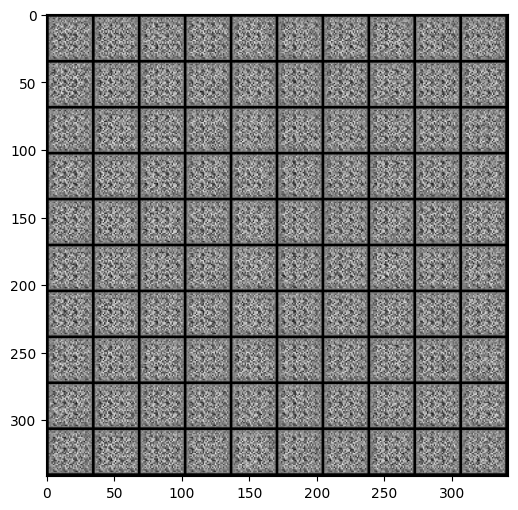

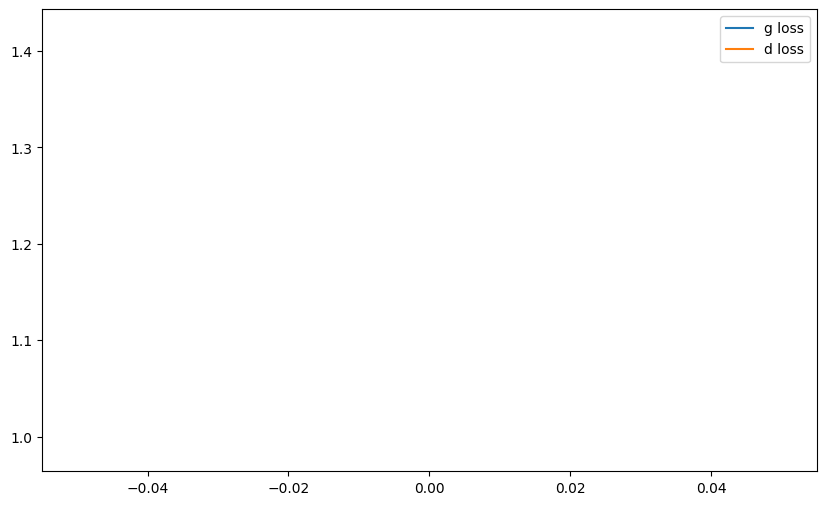

it: 200; g_loss: 1.1597687005996704; d_loss: 1.1070237159729004; avg_real_score: 0.5473711490631104; avg_fake_score: 0.31775426864624023: : 199it [00:16, 12.90it/s]

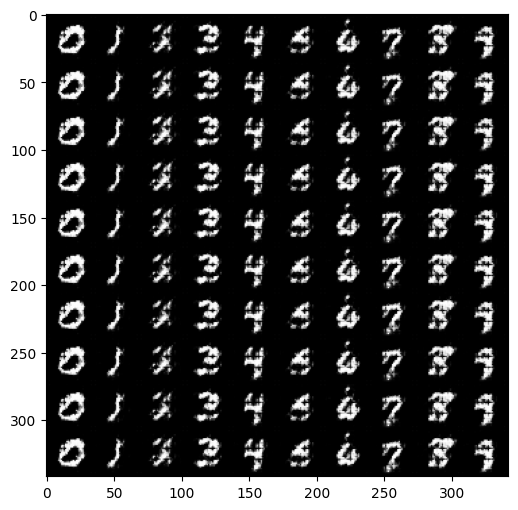

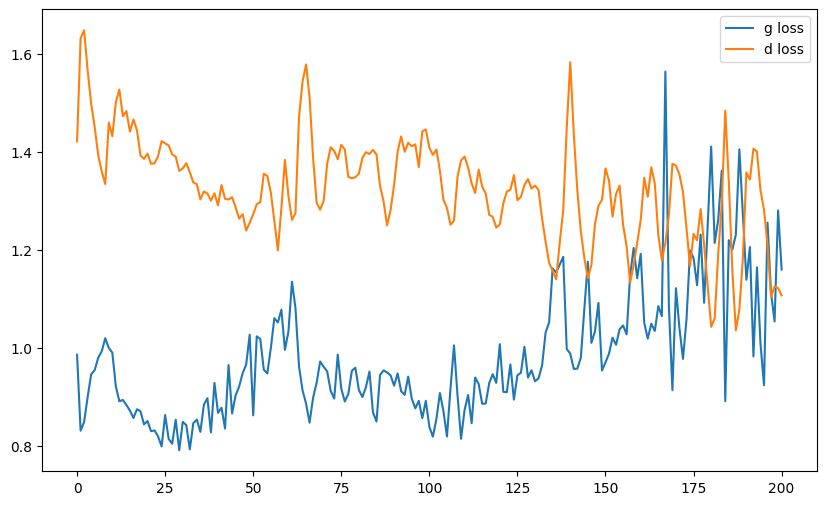

it: 400; g_loss: 1.4087387323379517; d_loss: 1.037541151046753; avg_real_score: 0.598146915435791; avg_fake_score: 0.2556469440460205: : 400it [00:34, 10.47it/s]

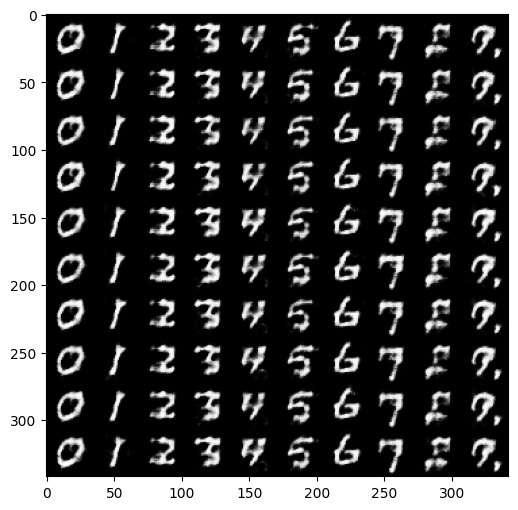

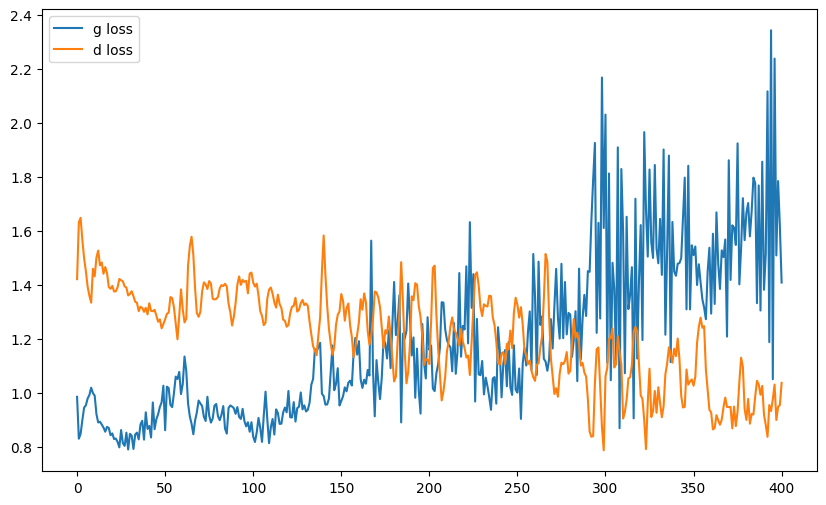

it: 468; g_loss: 1.6750119924545288; d_loss: 0.9000330567359924; avg_real_score: 0.6980985999107361; avg_fake_score: 0.197152778506279: : 469it [00:39, 11.75it/s]
it: 469; g_loss: 2.1392340660095215; d_loss: 0.8540864586830139; avg_real_score: 0.7187225818634033; avg_fake_score: 0.12765300273895264: : 0it [00:00, ?it/s]

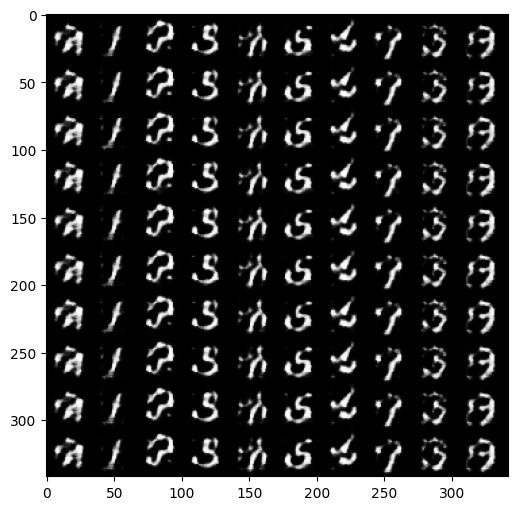

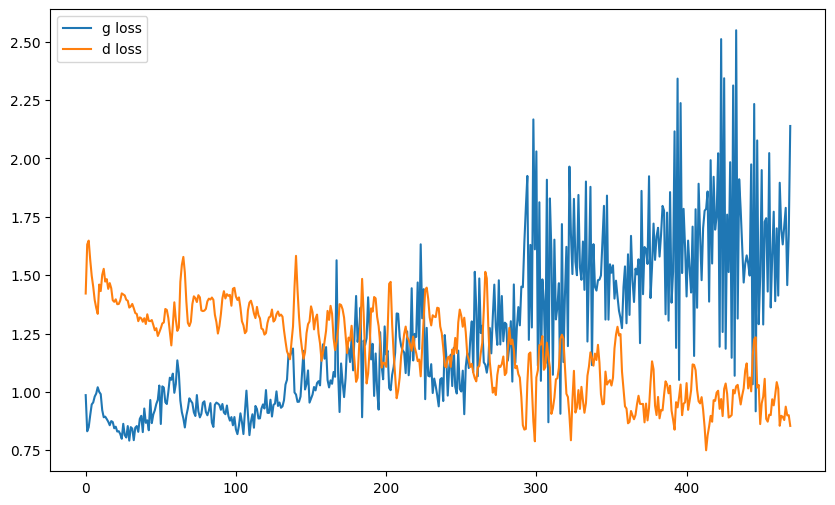

it: 669; g_loss: 1.2899960279464722; d_loss: 0.8468965888023376; avg_real_score: 0.6130188703536987; avg_fake_score: 0.2805109918117523: : 200it [00:17, 11.19it/s] 

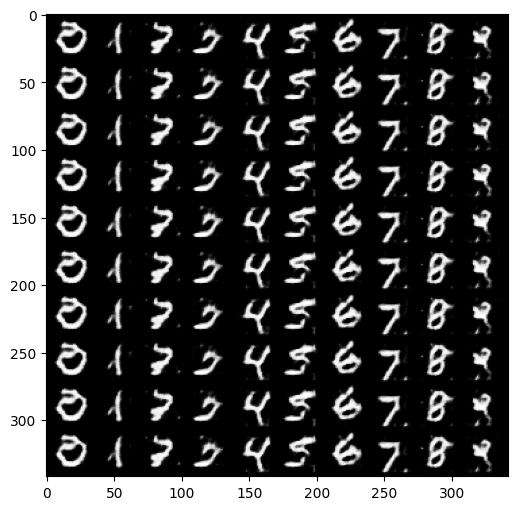

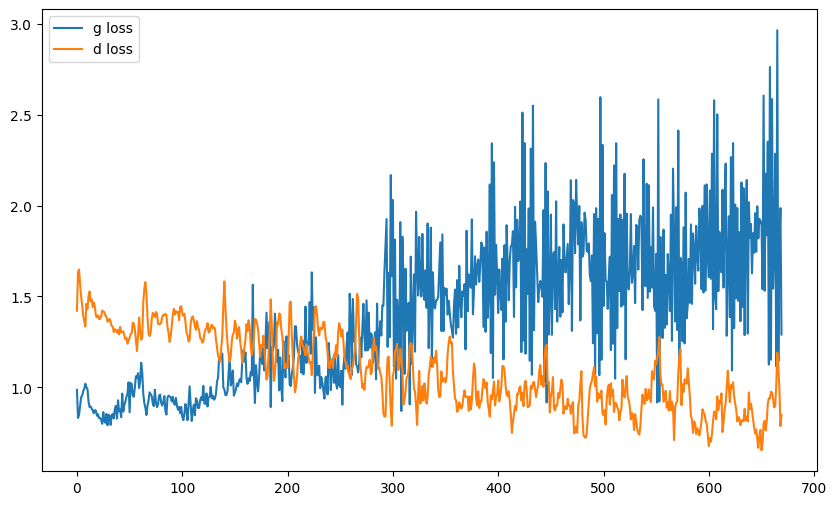

it: 869; g_loss: 2.57537841796875; d_loss: 0.7683836221694946; avg_real_score: 0.7568554282188416; avg_fake_score: 0.08840429782867432: : 400it [00:34, 12.18it/s]

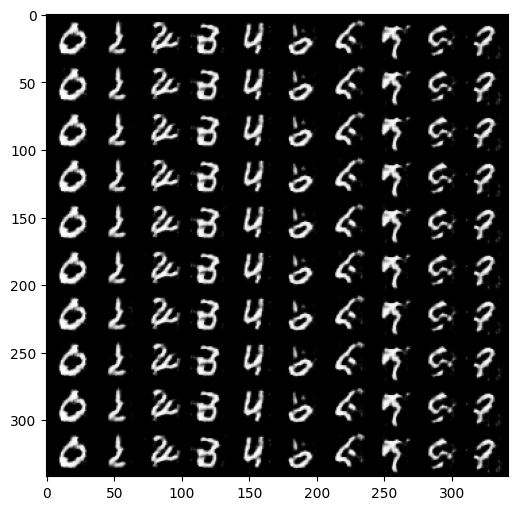

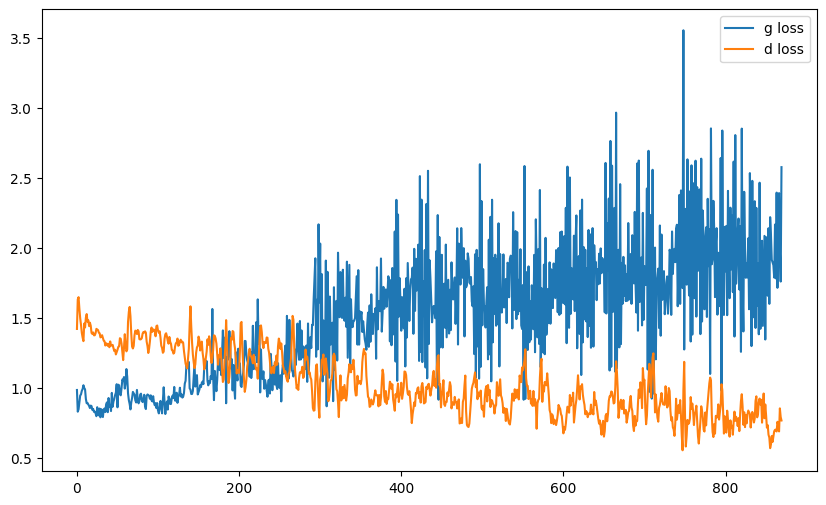

it: 937; g_loss: 2.8840770721435547; d_loss: 0.9349855184555054; avg_real_score: 0.7863461375236511; avg_fake_score: 0.06247144937515259: : 469it [00:41, 11.43it/s]
it: 938; g_loss: 1.4156568050384521; d_loss: 0.9168006181716919; avg_real_score: 0.5462893843650818; avg_fake_score: 0.25431904196739197: : 0it [00:00, ?it/s]

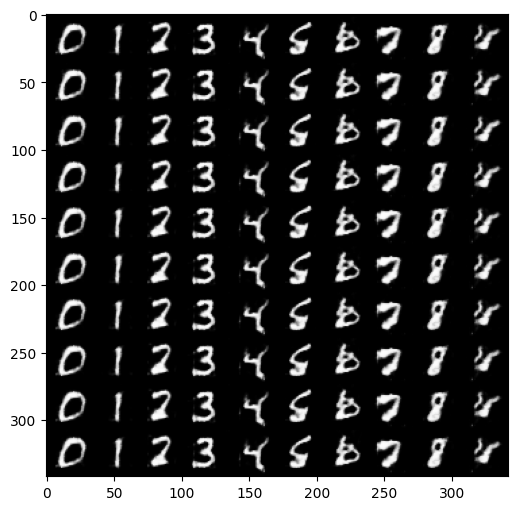

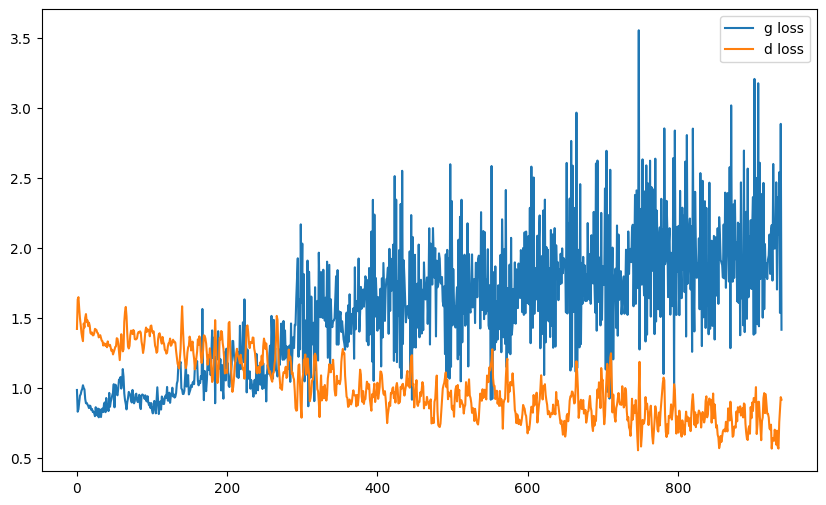

it: 1138; g_loss: 1.4063098430633545; d_loss: 0.8121741414070129; avg_real_score: 0.6483054757118225; avg_fake_score: 0.2556936740875244: : 199it [00:17, 11.61it/s] 

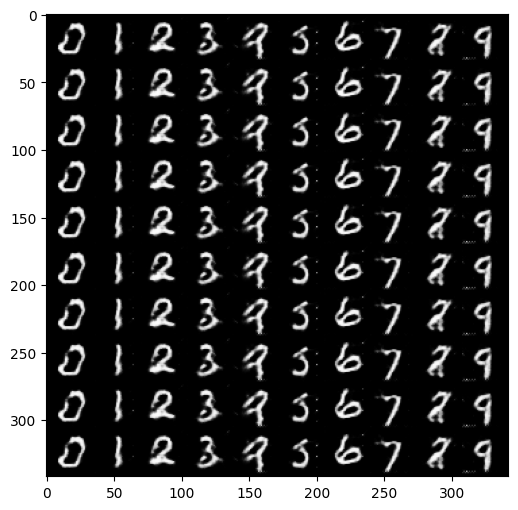

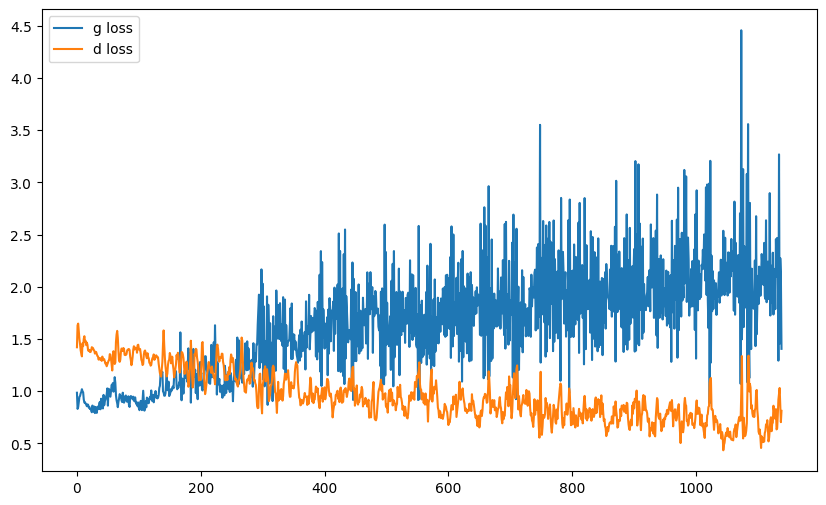

it: 1338; g_loss: 2.2344155311584473; d_loss: 0.5493252873420715; avg_real_score: 0.7560231685638428; avg_fake_score: 0.11170698702335358: : 399it [00:35, 11.50it/s]

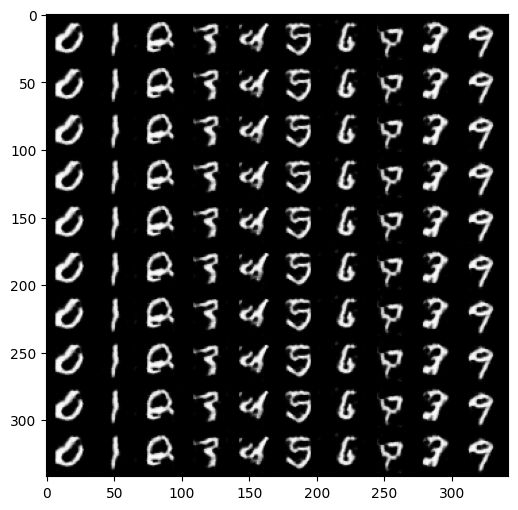

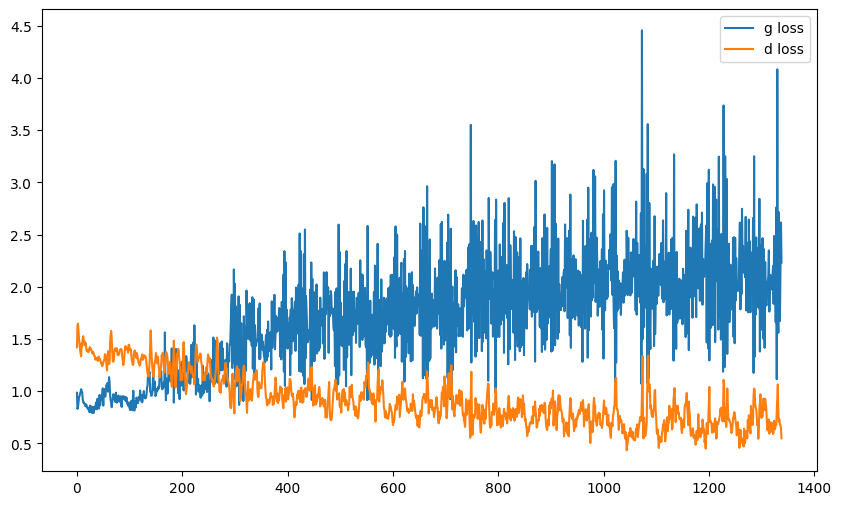

it: 1406; g_loss: 2.3040099143981934; d_loss: 0.6544362306594849; avg_real_score: 0.7557796239852905; avg_fake_score: 0.11071403324604034: : 469it [00:41, 11.21it/s]
it: 1407; g_loss: 2.663527727127075; d_loss: 0.5546150803565979; avg_real_score: 0.8072442412376404; avg_fake_score: 0.07401351630687714: : 0it [00:00, ?it/s]

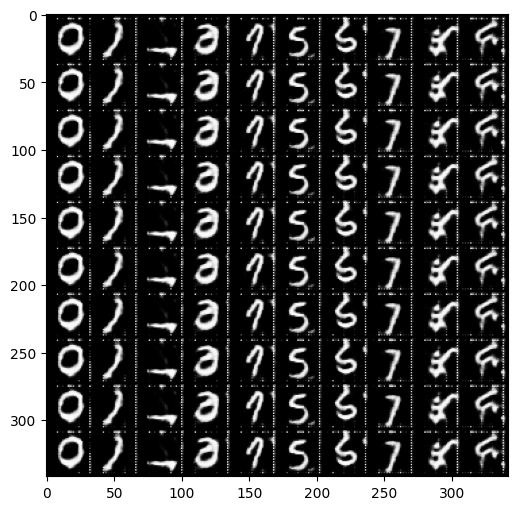

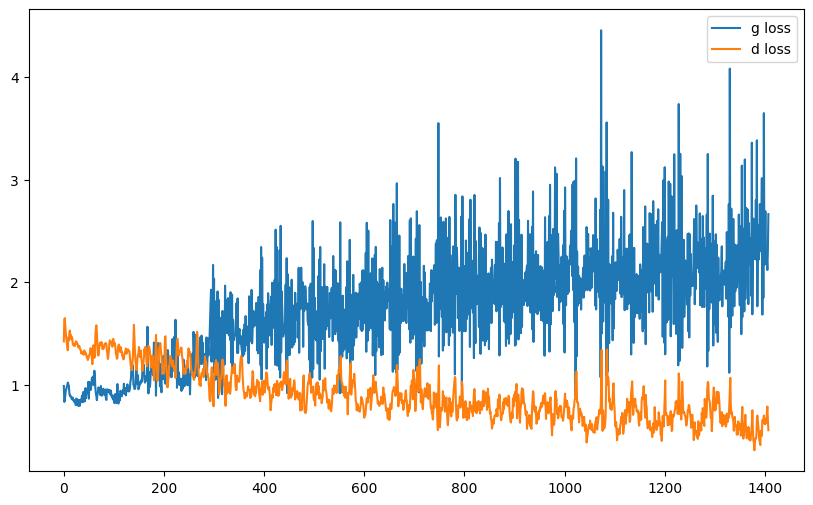

it: 1607; g_loss: 1.4090003967285156; d_loss: 0.4524436295032501; avg_real_score: 0.7913596630096436; avg_fake_score: 0.27461057901382446: : 199it [00:17, 11.19it/s]

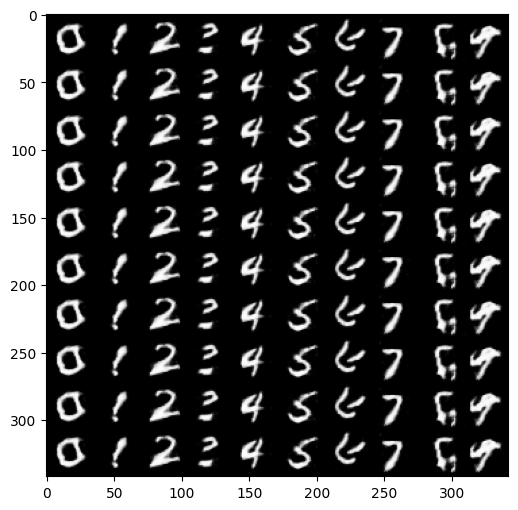

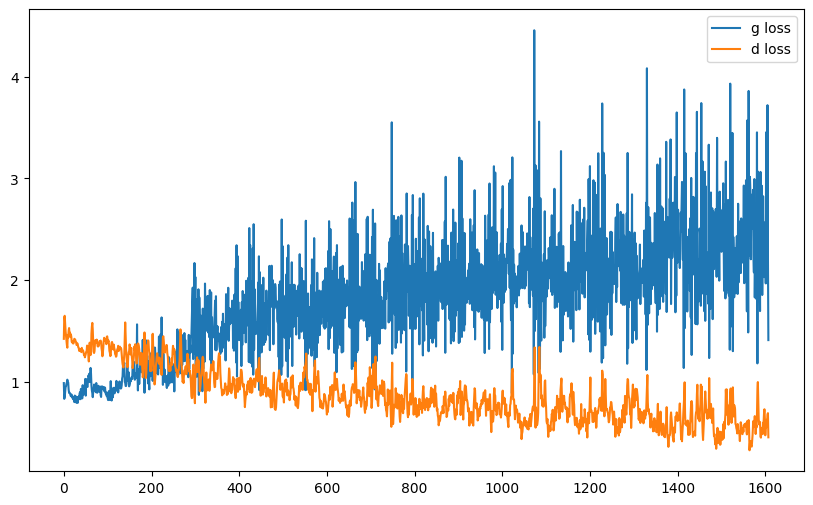

it: 1807; g_loss: 2.644211769104004; d_loss: 0.4700079560279846; avg_real_score: 0.8139210939407349; avg_fake_score: 0.07583855092525482: : 399it [00:35, 11.50it/s] 

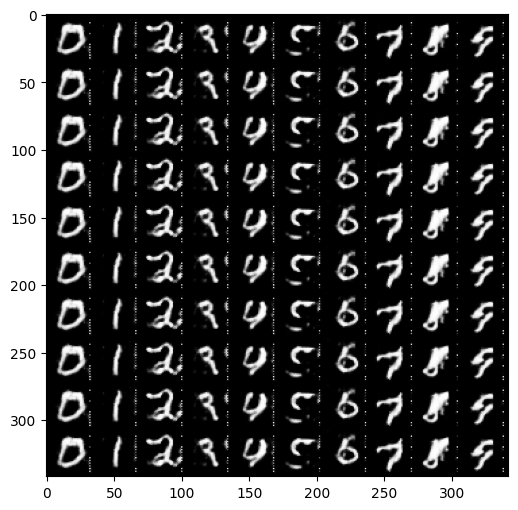

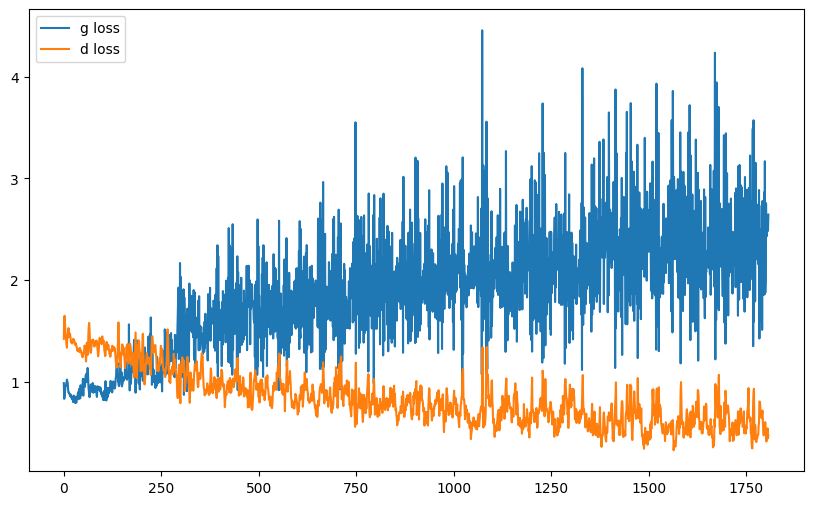

it: 1875; g_loss: 2.943355083465576; d_loss: 0.37470072507858276; avg_real_score: 0.872233510017395; avg_fake_score: 0.05749153345823288: : 469it [00:41, 11.20it/s]
it: 1876; g_loss: 2.2920379638671875; d_loss: 0.3995208144187927; avg_real_score: 0.776364803314209; avg_fake_score: 0.10645425319671631: : 0it [00:00, ?it/s]

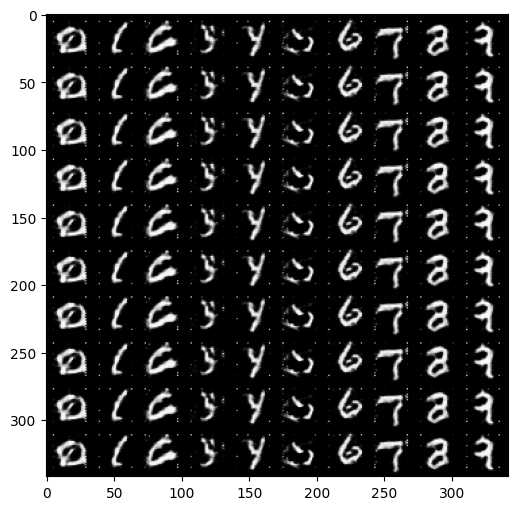

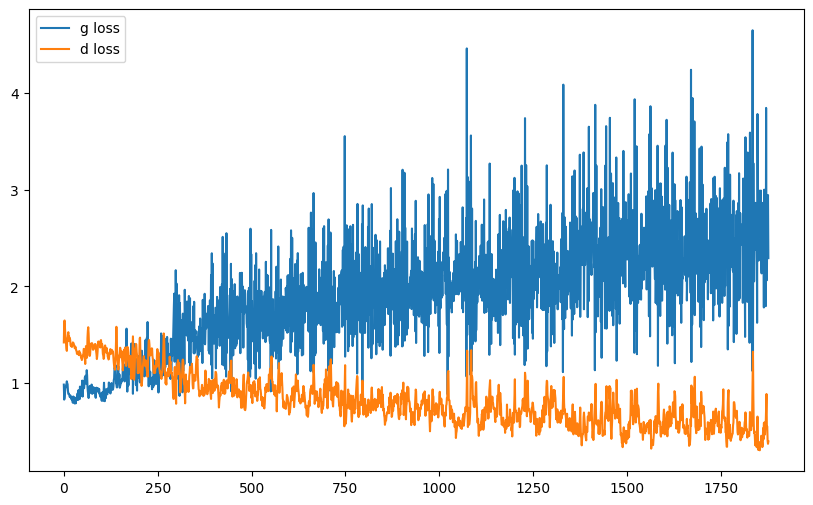

it: 2076; g_loss: 2.2169628143310547; d_loss: 0.46538567543029785; avg_real_score: 0.7832401990890503; avg_fake_score: 0.12219282984733582: : 199it [00:17, 10.39it/s]

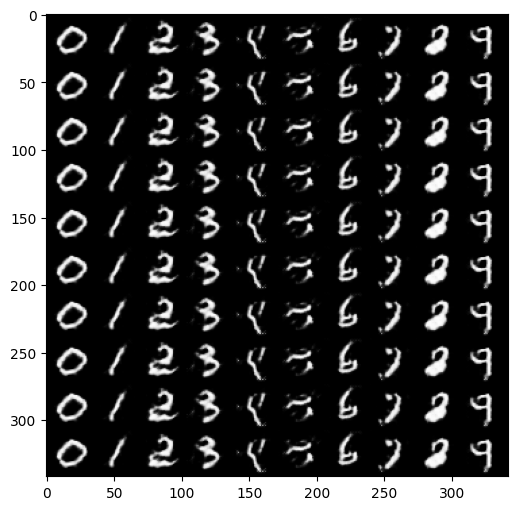

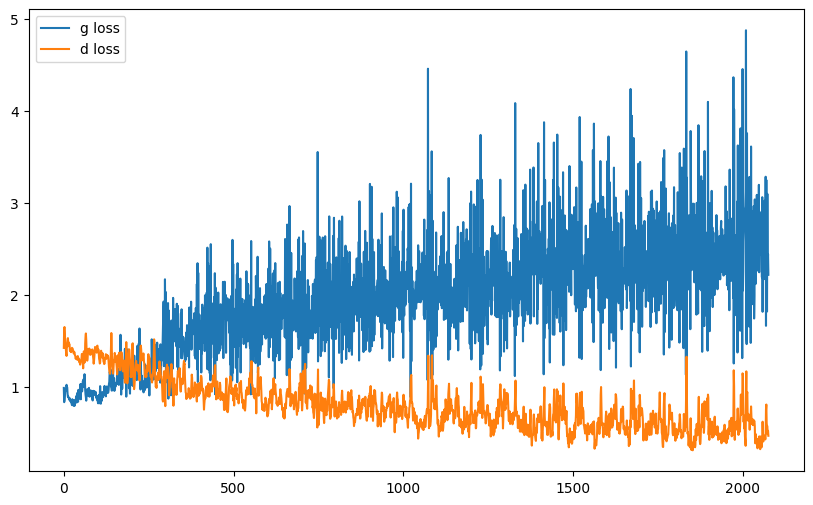

it: 2276; g_loss: 2.6878929138183594; d_loss: 0.3735039234161377; avg_real_score: 0.8139743804931641; avg_fake_score: 0.07405093312263489: : 399it [00:36, 11.56it/s] 

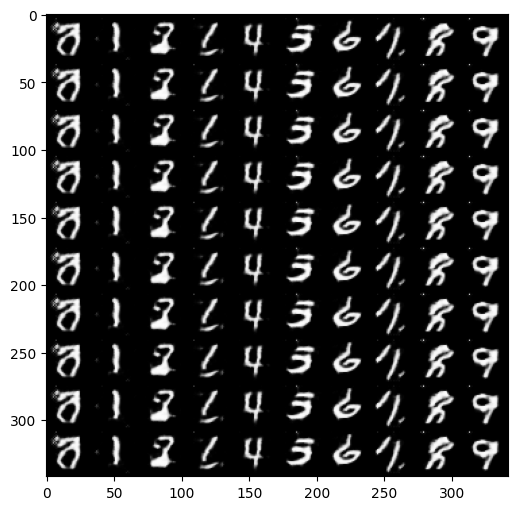

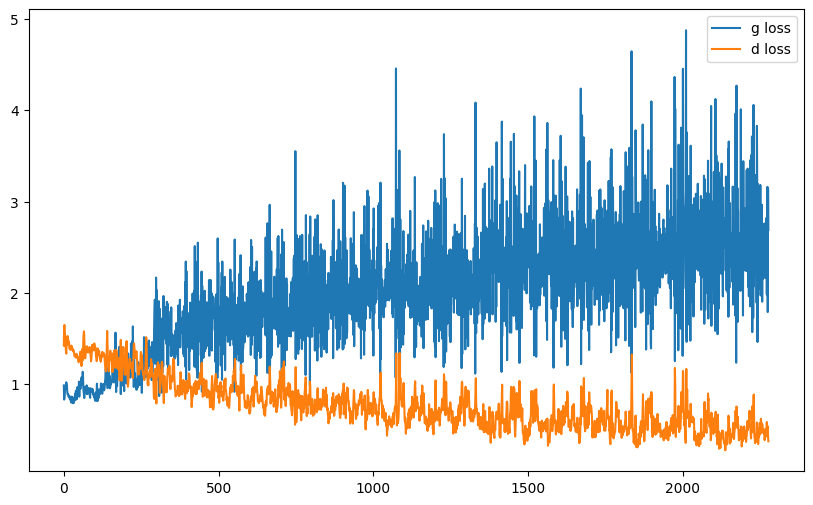

it: 2344; g_loss: 2.5281758308410645; d_loss: 0.37696853280067444; avg_real_score: 0.7965599894523621; avg_fake_score: 0.1012628823518753: : 469it [00:42, 11.06it/s]


In [ ]:
nb_epochs = 5

g_losses = []
d_losses = []

j = 0

z_test = sample_z(100, nz)  # we generate the noise only once for testing


for epoch in range(nb_epochs):

    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, labels = batch
        im = im.to(device)


        y = F.one_hot(labels).float().to(device)

        cur_batch_size = im.shape[0]


        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################

        # 1. sample a z vector
        z = sample_z(batch_size=cur_batch_size, nz=nz)

        # 2. Generate a fake image
        fake_im = netG(z, y)

        # 3. Classify real image with D
        yhat_real = netD(im, y)

        # 4. Classify fake image with D
        yhat_fake = netD(fake_im.detach(), y)


        ###
        ### Discriminator
        ###

        d_loss_real = criterion(yhat_real, get_labels_one(cur_batch_size))
        d_loss_fake = criterion(yhat_fake, get_labels_zero(cur_batch_size))
        d_loss = d_loss_real + d_loss_fake    # YOUR CODE HERE
        d_opt.zero_grad()
        d_loss.backward()
        d_opt.step()


        ###
        ### Generator
        ###


        yhat_fake = netD(fake_im, y)      # Using the most updated Discriminator
        g_loss = criterion(yhat_fake, get_labels_one(cur_batch_size)) # YOUR CODE HERE
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()


        # Save Metrics

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        avg_real_score = yhat_real.mean().item()
        avg_fake_score = yhat_fake.mean().item()

        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")

        if i % display_freq == 0:
            labels = torch.arange(0, 10).expand(size=(10, 10)).flatten().to(device)
            y = F.one_hot(labels).float().to(device)
            fake_im = netG(z_test, y)

            un_norm = renorm(fake_im) # for visualization

            grid = torchvision.utils.make_grid(un_norm, nrow=10)
            pil_grid = to_pil(grid)

            plt.imshow(pil_grid)
            plt.show()


            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')

            plt.legend()
            plt.show()

        j += 1


## 4.2 Testing
Visualization of the impact of z on generation. All digits in the same column have the same noise vector z.

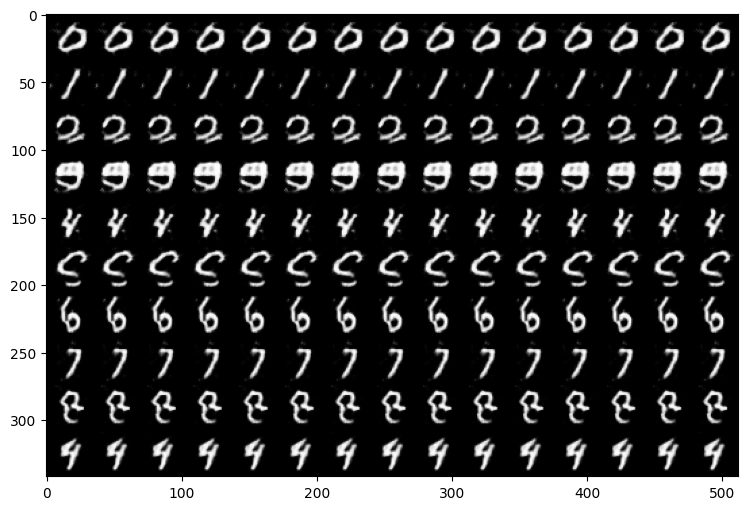

In [ ]:
n_ex = 15
n_classes = 10

z = sample_z(n_ex, nz).repeat(n_classes, 1) #.expand(10, nz)

netG.eval()

labels = torch.arange(n_classes).unsqueeze(0).reshape(-1, 1).repeat(1, n_ex).flatten().to(device)

ys = F.one_hot(labels).float()
fake_ims = netG(z, ys)

un_norm= renorm(fake_ims) # for visualization
grid = torchvision.utils.make_grid(un_norm, nrow=n_ex)
pil_grid = to_pil(grid)

plt.imshow(pil_grid)
plt.show()
